<div class="alert alert-block alert-info">
  <center style="font-size: 2em;">ABCDEats Inc - Customer Segmentation Analysis</center>
  <center style="font-size: 1.5em;">Group 13</center>
  <center style="font-size: 1.2em;">notebook 2</center>
  <center style="font-size: 1.2em;">2024/2025</center>
</div>

 #### This Project was done by:

Student Name - Oumaima Ben Hfaiedh <br>
Student id - 20240699 <br>
Contact e-mail - 20240699@novaims.unl.pt <br>

Student Name -  Ana Pedro Martins Caleiro <br>
Student id -  20240696 <br>
Contact e-mail - 20240696@novaims.unl.pt <br>

Student Name -  Érica Yeranosyan Parracho  <br>
Student id - 20240583 <br>
Contact e-mail - 20240583@novaims.unl.pt  <br>

Student Name -   Rute D’Alva Teixeira <br>
Student id -  20240667 <br>
Contact e-mail - 20240667@novaims.unl.pt <br>

# Table of Content



**0. [Context and Metadata](#context)**  

**1. [Importing Librariesand Loading Data](#importing-libraries-and-data)**   
   - [1.1. Importing Libraries](#importing-libraries)
   - [1.2. Datasets and variables](#datasetsandvariables)
     
**2. [Data Preparation](#prep)**   
   - [2.1. Defining Categorical Data](#categorical-data)
   - [2.2. Functions syntax](#func)
    
     
**3. [Data Preprocessing](#3-data-preprocessing)**
- [3.1. Duplicates](#duplicates)
- [3.2. Incoherences](#incoherences)
    - [3.2.1. Vendor_count = 0](#inc-1)
    - [3.2.2. product_count = 0](#inc-2)
    - [3.2.3. is_chain > 1](#inc-3)
- [3.3. Missing Values](#missing-values)
    - [3.3.1. first_order](#first-order)
    - [3.3.2. HR_0](#hr0)
- [3.4. Outliers](#outliers)
    - [3.4.2. Quantile Thresholding](#manual)
- [3.5. Feature Engineering](#3-feature-engineering)
    - [3.5.1. Buyer Type: One-Time-buyers vs Repeated Buyers](#Buyer)
    - [3.5.2. Weekdays Transactions](#Weekdays_Transactions)
    - [3.5.3. Weekend Transactions](#weekends)
    - [3.5.4. Morning Transactions](#morning)
    - [3.5.5. Afternoon Transactions](#Afternoon)
    - [3.5.6. Evening Transactions](#Evening)
    - [3.5.7. Night Transactions](#Night)
    - [3.5.8. Frequency](#Frequency)
    - [3.5.9. Monetary Spending](#Mnt)
    - [3.5.10. Engagement Span](#Eng)
    - [3.5.11. Recency](#Recency)
    - [3.5.12. Spending Budget](#Spending_Budget)
    - [3.5.13. Consumer Segment: Individual vs Group transactions](#Con)
    - [3.5.14. Cities](#Cities)
    - [3.5.15. Combining similar Cuisines from a business Perspective](#Comb)
- [3.6. Further Analysis](#Further_Analysis)
    - [3.6.1. Contingency Tables](#contigency)
    - [3.6.2. RFM Analysis](#RFM)
- [3.7. Feature Scaling](#Feature_Scaling)
- [3.8. KNN Imputation](#knn)
- [3.9. One Hot Encoding for categorical data - Profiling](#one)
- [3.10. DBSCAN Multivariate Outliers](#DB)

**4. [Feature Selection](#Feature_Selection)**
- [4.1.Correlation Matrix](#correlation)
- [4.2. Univariance](#univariance)

**5. [Clustering](#Clustering)**
- [5.1. Behavior-Based Segmentation](#beh)
  - [5.1.1. K-means and Hierarchical clustering](#km)
  - [5.1.2. Self-organizing Map](#som)
  - [5.1.3. Density-Based Clustering](#DBC_VB)
      - [5.1.3.1. DBSCAN](#DBSCAN_VB)
      - [5.1.3.2. Mean-Shift Clustering](#MSC_VB)
      - [5.1.3.3. Gaussian Mixture Model](#GMM_VB)
  - [5.1.4. Comparing Models for Behaviour Perspective](#compa)
- [5.2. Perspective-Based Segmentation](#pb)
  - [5.2.1. K-means and Hierarchical clustering](#km2)
  - [5.2.2. Self-organizing Map](#som2)
  - [5.2.3. Density-Based Clustering](#DBC)
      - [5.2.3.1. DBSCAN](#DBSCAN)
      - [5.2.3.2. Mean-Shift Clustering](#MSC)
      - [5.2.3.3. Gaussian Mixture Model](#GMM)
  - [5.2.4. Comparing Models for Behaviour Perspective](#compa2)


**6. [Selected Cluster Technique: optimization](#final-model)**
- [6.1. Merging Clusters](#meg)
- [6.2. Analysis of Merging Clusters](#analy)

**7. [Profiling with categorical data](#prof)**

**8. [Merged Clusters Visualization](#mcv)**

- [8.1. PCA ](#pca)
- [8.2. TSNE ](#TSNE)
- [8.3. UMAP ](#UMAP) 

**9. [Reclassifying Outliers and Feature importance Assessment](#ro)**

<a class="anchor" id="0-context"></a>
# 0. Context and Metadata 

We are consultants for ABCDEats Inc (ABCDE), a food delivery service with a vast range of restaurants with diferent cuisines. We are going to analyse three months of data from three cities to provide a data-driven strategy than englobes 3 different segmentation perpectives. 

<a class="anchor" ></a>
## Metadata 


`customer_id` - Unique identifier for each customer <br>
`customer_region` - Geographic region where the customer is located <br>
`customer_age` - Age of the customer <br>
`vendor_count` - Number of unique vendors the customer has ordered from <br>
`product_count` - Total number of products the customer has ordered <br>
`is_chain` - Indicates whether the customer’s order was from a chain restaurant <br>
`first_order` - Number of days from the start of the dataset when the customer first placed an order. <br>
`last_order` - Number of days from the start of the dataset when the customer most recently placed an order. <br>
`last_promo` - The category of the promotion or discount most recently used by the customer. <br>
`payment_method` - Method most recently used by the customer to pay for their orders. <br>
`CUI_(cuisine)`- The amount in monetary units spent by the customer from the indicated type of cuisine. <br>
- CUI_Beverages, CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts','CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks', CUI_Thai <br>

`DOW_0 to DOW_6` - Number of orders placed on each day of the week (0 = Sunday, 6 = Saturday). <br>
`HR_0 to HR_23` - Number of orders placed during each hour of the day (0 = midnight, 23 = 11 PM). <br>
ders.

<a class="anchor" id="importing-libraries-and-data"></a>
# 1. Importing Libraries and Loading Data  

<a class="anchor" id="importing-libraries"></a>
## 1.1. Importing Libraries 

In [9]:
#All our libraries
import sqlite3
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib import colors as mpl_colors
from matplotlib.patches import RegularPolygon
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colorbar import Colorbar
import matplotlib as mpl


import seaborn as sns
from math import ceil

#For better resolution plots
%config InlineBackend.figure_format = 'retina' 

#Imputing Library
from sklearn.impute import KNNImputer

#Sclaer Library
from sklearn.preprocessing import MinMaxScaler, StandardScaler, OneHotEncoder

#Clustering Libraries
from sklearn.cluster import AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram
from sklearn.cluster import MeanShift, DBSCAN, estimate_bandwidth, KMeans, AgglomerativeClustering
from sklearn.mixture import GaussianMixture
from sklearn.base import clone
from sklearn.neighbors import NearestNeighbors
from collections import Counter 
from sklearn.metrics import silhouette_score, silhouette_samples
#Setting seaborn style
sns.set()

#Cluster Vizualizations
from umap import UMAP
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import plotly.express as px

#Assess feature importance 
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

from minisom import MiniSom
sns.set()
import warnings
warnings.filterwarnings("ignore")

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [3]:
#!pip install minisom
#!pip install umap-learn
#!pip install plotl

<a class="anchor" id="datasetsandvariables">
    
## 1.2. Loading datasets and variables

</a>

In [4]:
ABCDE = pd.read_csv('ABCDE.csv', index_col=0)
ABCDE_copy = pd.read_csv('ABCDE_copy.csv', index_col=0)

In [5]:
from variables_EDA import cuisine_columns, metric_features, days_columns, hours_columns

In [6]:
with open('functions_EDA.py', 'r') as f:
    function_code = f.read()

# Execute the code to define the function
exec(function_code)

<a class="anchor" id="prep"></a>
# 2. Data Preparation

<a class="anchor" id="categorical-data">
    
## 2.1. Defining Categorical Data
</a>

In [7]:
# Converting the datatype of categorical features from object to category

ABCDE['customer_region'] = ABCDE['customer_region'].astype('category')
ABCDE['last_promo'] = ABCDE['last_promo'].astype('category')
ABCDE['payment_method'] = ABCDE['payment_method'].astype('category')

<a class="anchor" id="func"></a>

## 2.2. Functions syntax

#### Function for assessing correlated paird

In [8]:
def corr_pairs(corr, threshold):
    mask = np.tril(np.ones(corr.shape), k=-1).astype(bool)
    
    corr_lower = corr.where(mask)
    
    cor_pairs = corr_lower.unstack().dropna()
    cor_pairs = cor_pairs[(cor_pairs.abs() >= threshold)]

    
    for pair, value in cor_pairs.items():
        feature_count_pair1 = len(corr[(corr[pair[0]].abs() > 0.35) & (corr[pair[0]].abs() < threshold)])
        feature_count_pair2 = len(corr[(corr[pair[1]].abs() > 0.35) & (corr[pair[1]].abs() < threshold)])
        
        print(f'{value:.2f} : {pair[0]} | significantly correlated with {feature_count_pair1} more features | or | {pair[1]} | significantly correlated with {feature_count_pair2} more features')

#### Function for Radar Chart

In [9]:
def plot_radar_chart(df, merged_labels_col, features):
    # Preprocessing data for the radar chart
    grouped_data = df.groupby(merged_labels_col)[features].mean()
    grouped_data = grouped_data.reset_index()

    # Normalize data for radar chart (min-max normalization)
    normalized_data = (grouped_data[features] - grouped_data[features].min()) / (grouped_data[features].max() - grouped_data[features].min())

    # Prepare data for plotting
    categories = features
    num_vars = len(categories)
    angles = [n / float(num_vars) * 2 * np.pi for n in range(num_vars)]
    angles += angles[:1]  # Close the circle

    # Create the radar chart
    fig, ax = plt.subplots(figsize=(8, 8), subplot_kw=dict(polar=True))
    for i, row in normalized_data.iterrows():
        values = row.tolist()
        values += values[:1]
        ax.fill(angles, values, alpha=0.25)
        ax.plot(angles, values, label=f'Label {grouped_data[merged_labels_col][i]}')

    # Add feature labels to the chart
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(categories)
    ax.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    ax.set_yticklabels(['0.2', '0.4', '0.6', '0.8', '1.0'], color="grey", size=10)
    ax.set_title(f"Radar Chart for Features by {merged_labels_col}", size=14, y=1.1)
    
    # Add legend
    ax.legend(loc='upper right', bbox_to_anchor=(1.3, 1))

    # Return fig and ax
    return fig, ax


#### Functions for R square

In [10]:
def get_ss(df, feats):
    df_ = df[feats]
    ss = np.sum(df_.var() * (df_.count() - 1))
    return ss 

def get_ssb(df, feats, label_col):
    ssb_i = 0
    for i in np.unique(df[label_col]):
        df_ = df.loc[:, feats]
        X_ = df_.values
        X_k = df_.loc[df[label_col] == i].values
        ssb_i += (X_k.shape[0] * (np.square(X_k.mean(axis=0) - X_.mean(axis=0))))
    ssb = np.sum(ssb_i)
    return ssb

def get_ssw(df, feats, label_col):
    feats_label = feats + [label_col]
    df_k = df[feats_label].groupby(by=label_col).apply(lambda col: get_ss(col, feats), include_groups=False)
    return df_k.sum()

def get_rsq(df, feats, label_col):
    df_sst_ = get_ss(df, feats)
    df_ssw_ = get_ssw(df, feats, label_col)
    df_ssb_ = df_sst_ - df_ssw_
    return (df_ssb_ / df_sst_)
    
def get_r2_scores(df, feats, clusterer, min_k=2, max_k=10):
    r2_clust = {}
    for n in range(min_k, max_k + 1):  # Ensure max_k is included
        clust = clone(clusterer).set_params(n_clusters=n)
        labels = clust.fit_predict(df[feats])  # Use only the features
        df_concat = pd.concat([df, pd.Series(labels, name='labels', index=df.index)], axis=1)
        r2_clust[n] = get_rsq(df_concat, feats, 'labels')
    return r2_clust



#### Inertia and Silhouette Function

In [11]:
def inertia_and_silhouette_plots(X, min_clusters, max_clusters):
    inertias = []
    silhouette_scores = []

    for k in range(min_clusters, max_clusters + 1):
        kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
        labels = kmeans.fit_predict(X)
        inertias.append(kmeans.inertia_)

        # Silhouette score is undefined for k=1
        if k > 1:
            silhouette_scores.append(silhouette_score(X, labels))
        else:
            silhouette_scores.append(float('nan'))  # Append NaN for k=1

    # Plotting
    fig, ax1 = plt.subplots()

    color = 'tab:red'
    ax1.set_xlabel('Number of Clusters (k)')
    ax1.set_ylabel('Inertia', color=color)
    ax1.plot(np.arange(min_clusters, max_clusters + 1), inertias, marker='o', color=color, label='Inertia')
    ax1.tick_params(axis='y', labelcolor=color)

    ax2 = ax1.twinx()
    color = 'tab:blue'
    ax2.set_ylabel('Silhouette Score', color=color)
    ax2.plot(np.arange(min_clusters, max_clusters + 1), silhouette_scores, marker='o', color=color, label='Silhouette Score')
    ax2.tick_params(axis='y', labelcolor=color)

    sns.set_style("white")
    fig.tight_layout()
    plt.show()


#### Comparing Models Function

In [12]:
def get_ss_(df):
    return np.sum(df.var(ddof=0) * (df.count() - 1))  # ddof=0 for population variance

def r2(df, labels):
    sst = get_ss_(df)  # Total sum of squares
    ssw = np.sum(df.groupby(labels).apply(get_ss_))  # Within-cluster sum of squares
    return 1 - ssw / sst

def compare_models(models_dict, cluster_column='cluster_labels'):
    scores = []
    n_clusters = []
    
    model_names = list(models_dict.keys())
    
    for modelName, modelDataframe in models_dict.items():
        scores.append(r2(modelDataframe, cluster_column))
        n_clusters.append(len(np.unique(modelDataframe[cluster_column])))
        
    sns.set()
    f, (ax1, ax2) = plt.subplots(1, 2, facecolor='white')  # Set figure background to white
    f.set_size_inches(22.2, 15)  # Increase figure size by 20%
    
    # Add a black frame
    f.patch.set_linewidth(5)  # Line width of the border
    f.patch.set_edgecolor('black')  # Border color
    
    x = np.arange(len(scores))  # the label locations
    
    width = 0.20  # the width of the bars
    
    # Use a distinct color palette
    colors = sns.color_palette("Accent", len(scores))
    
    ax1.set_facecolor("white")
    for i, (score, model_name, color) in enumerate(zip(scores, model_names, colors)):
        ax1.bar(x[i] - width/2, score, width, label=model_name, color=color)
    
    ax1.set_ylim(0.0, 1.0)
    ax1.set_ylabel('Scores', fontsize=18)  # Increase font size for the ylabel
    ax1.set_title('R-Squared score by Model', fontsize=20)  # Increase font size for the title
    ax1.set_xticks(x)
    ax1.set_xticklabels([])
    ax1.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=14)  # Increase font size for the legend
    
    ax2.set_facecolor("white")
    for i, (cluster, model_name, color) in enumerate(zip(n_clusters, model_names, colors)):
        ax2.bar(x[i] - width/2, cluster, width, label=model_name, color=color)
        
    sns.set_style("white")
    ax2.set_ylabel('Clusters', fontsize=18)  # Increase font size for the ylabel
    ax2.set_title('Number of Clusters by Model', fontsize=20)  # Increase font size for the title
    ax2.set_xticks(x)
    ax2.set_xticklabels([])
    ax2.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=14)  # Increase font size for the legend
    
    # Tight layout for better spacing
    f.tight_layout()
    
    plt.show()


#### Function Plot Hexagons for SOM

In [13]:

def plot_hexagons(som,              # Trained SOM model 
                  sf,               # matplotlib figure object
                  colornorm,        # colornorm
                  matrix_vals,      # SOM weights or matrix to plot
                  label="",         # title for figure
                  cmap=plt.cm.Grays, # colormap to use
                  annot=False       
                  ):
    
    axs = sf.subplots(1,1)
    
    for i in range(matrix_vals.shape[0]):
        for j in range(matrix_vals.shape[1]):

            # Convert SOM grid coordinates to Euclidean coordinates
            wx, wy = som.convert_map_to_euclidean((i, j)) 

            # Create hexagon patches
            hex = mpl.patches.RegularPolygon((wx, wy), 
                                             numVertices=6, 
                                             radius=np.sqrt(1/3),
                                             facecolor=cmap(colornorm(matrix_vals[i, j])), 
                                             alpha=1, 
                                             edgecolor='white',
                                             linewidth=.5)
            axs.add_patch(hex)
            if annot:
                annot_val = np.round(matrix_vals[i, j], 2)
                if int(annot_val) == annot_val:
                    annot_val = int(annot_val)
                axs.text(wx, wy, annot_val, 
                         ha='center', va='center', 
                         fontsize='x-small')

    # Remove axes for hex plot
    axs.margins(.05)
    axs.set_aspect('equal')
    axs.axis("off")
    axs.set_title(label)

    # Create colorbar
    divider = make_axes_locatable(axs)
    ax_cb = divider.append_axes("right", size="5%", pad="0%")

    # Create a ScalarMappable to handle the color normalization
    cmap_sm = mpl.cm.ScalarMappable(cmap=cmap, norm=colornorm)
    cmap_sm.set_array([])

    # Create the colorbar using the correct method
    cb1 = mpl.colorbar.ColorbarBase(ax_cb,
                                    orientation='vertical',
                                    alpha=1,
                                    mappable=cmap_sm)
    cb1.ax.get_yaxis().labelpad = 6

    # Add colorbar to plot
    sf.add_axes(ax_cb)

    return sf


#### Function Cluster Profiles

In [14]:
def cluster_profiles(df, label_columns, figsize, 
                     cmap="tab10",
                     compare_titles=None):
    """
    Pass df with labels columns of one or multiple clustering labels. 
    Then specify this label columns to perform the cluster profile according to them.
    """
    
    if compare_titles == None:
        compare_titles = [""]*len(label_columns)
        
    fig, axes = plt.subplots(nrows=len(label_columns), 
                             ncols=2, 
                             figsize=figsize, 
                             constrained_layout=True,
                             squeeze=False)
    for ax, label, titl in zip(axes, label_columns, compare_titles):
        # Filtering df
        drop_cols = [i for i in label_columns if i!=label]
        dfax = df.drop(drop_cols, axis=1)
        
        # Getting the cluster centroids and counts
        centroids = dfax.groupby(by=label, as_index=False).mean()
        counts = dfax.groupby(by=label, as_index=False).count().iloc[:,[0,1]]
        counts.columns = [label, "counts"]
        
        # Setting Data
        pd.plotting.parallel_coordinates(centroids, 
                                            label, 
                                            color = sns.color_palette(cmap),
                                            ax=ax[0])



        sns.barplot(x=label, 
                    hue=label,
                    y="counts", 
                    data=counts, 
                    ax=ax[1], 
                    palette=sns.color_palette(cmap),
                    legend=False
                    )

        #Setting Layout
        handles, _ = ax[0].get_legend_handles_labels()
        cluster_labels = ["Cluster {}".format(i) for i in range(len(handles))]
        ax[0].annotate(text=titl, xy=(0.95,1.1), xycoords='axes fraction', fontsize=13, fontweight = 'heavy') 
        ax[0].axhline(color="black", linestyle="--")
        ax[0].set_title("Cluster Means - {} Clusters".format(len(handles)), fontsize=13)
        ax[0].set_xticklabels(ax[0].get_xticklabels(), 
                              rotation=40,
                              ha='right'
                              )
        
        ax[0].legend(handles, cluster_labels,
                     loc='center left', bbox_to_anchor=(1, 0.5), title=label
                     ) # Adaptable to number of clusters
        
        ax[1].set_xticks([i for i in range(len(handles))])
        ax[1].set_xticklabels(cluster_labels)
        ax[1].set_xlabel("")
        ax[1].set_ylabel("Absolute Frequency")
        ax[1].set_title("Cluster Sizes - {} Clusters".format(len(handles)), fontsize=13)
        
        
    
    # plt.subplots_adjust(hspace=0.4, top=0.90)
    plt.suptitle("Cluster Simple Profiling", fontsize=23)
    plt.show()

#### Function for Profiling

In [15]:
def plot_profiling_barplots(df, merged_labels_col, features):
    # Set the Seaborn style to white
    sns.set_style('white')
    
    # Ensure the merged_labels column is not categorical
    if df[merged_labels_col].dtype == 'category' or not pd.api.types.is_numeric_dtype(df[merged_labels_col]):
        df[merged_labels_col] = df[merged_labels_col].astype(str)

    # Convert feature columns to numeric if necessary
    for feature in features:
        if not pd.api.types.is_numeric_dtype(df[feature]):
            df[feature] = pd.to_numeric(df[feature], errors='coerce')

    # Group the data by merged labels and sum up counts for each feature
    grouped_data = df.groupby(merged_labels_col)[features].sum(numeric_only=True).reset_index()

    # Calculate the number of rows and columns dynamically
    n_features = len(features)
    n_cols = 4  # You can adjust this based on your preference
    n_rows = (n_features // n_cols) + (n_features % n_cols > 0)  # Ensures we cover all features
    
    # Create subplots (adjust size depending on number of rows)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))  # Adjust size based on number of rows and columns
    axes = axes.flatten()  # Flatten the axes array for easier iteration

    # Create separate bar plots for each feature
    for i, feature in enumerate(features):
        sns.barplot(x=merged_labels_col, y=feature, data=grouped_data, color='darkgreen', ax=axes[i])

        # Customize each subplot
        axes[i].set_title(f'{feature} by {merged_labels_col}')  # Title of the plot
        axes[i].set_xlabel(merged_labels_col)  # X-axis label
        axes[i].set_ylabel('Counts')  # Y-axis label
        axes[i].tick_params(axis='x', rotation=90)  # Rotate x-axis labels for better readability

    # Hide any empty subplots (if features are fewer than the total available subplots)
    for j in range(i + 1, len(axes)):
        axes[j].axis('off')

    # Adjust layout for better spacing between subplots
    plt.tight_layout()

    # Show the plot
    plt.show()


#### Function for R2 - individual feature

In [16]:
def get_ss_variables(df):
    """Get the SS for each variable
    """
    ss_vars = df.var() * (df.count() - 1)
    return ss_vars

def r2_variables(df, labels):
    """Get the R² for each variable
    """
    sst_vars = get_ss_variables(df)
    ssw_vars = np.sum(df.groupby(labels).apply(get_ss_variables))
    return 1 - ssw_vars/sst_vars

<a class="anchor" id="3-data-preprocessing">

# 3. Data Preprocessing  
</a>

<a class="anchor" id="duplicates"></a>
## 3.1. Duplicates 

In [17]:
ABCDE.set_index('customer_id', inplace=True)

In [18]:
ABCDE[ABCDE.duplicated(keep=False)]
#This code will display the duplicated rows which are 120 rows in Total

,customer_region,customer_age,vendor_count,product_count,is_chain,first_order,last_order,last_promo,payment_method,CUI_American,...,HR_14,HR_15,HR_16,HR_17,HR_18,HR_19,HR_20,HR_21,HR_22,HR_23
customer_id,,,,,,,,,,,,,,,,,,,,,
412c8c0b2d,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.00,...,0,0,0,0,0,0,1,0,0,0
4336560739,2360,24.0,1,2,0,0.0,11,DELIVERY,DIGI,0.00,...,0,0,0,0,0,0,1,0,0,0
11a56d6fbf,4660,32.0,3,4,3,1.0,43,-,CARD,10.15,...,0,1,2,0,0,0,0,0,0,0
dcc76a0a1b,4660,32.0,3,4,3,1.0,43,-,CARD,10.15,...,0,1,2,0,0,0,0,0,0,0
b55012ee1c,8550,23.0,4,11,1,2.0,89,FREEBIE,CARD,0.00,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
a6bdd77ae2,8670,30.0,1,1,0,83.0,83,DELIVERY,DIGI,0.00,...,0,0,0,0,0,0,0,0,0,0
1f616608ed,2360,23.0,1,2,1,87.0,87,DELIVERY,CARD,0.00,...,0,0,0,1,0,0,0,0,0,0
6020a9ce3d,2360,23.0,1,2,1,87.0,87,DELIVERY,CARD,0.00,...,0,0,0,1,0,0,0,0,0,0


In [19]:
ABCDE.drop_duplicates(inplace=True)

<a class="anchor" id="incoherences"></a>

## 3.2. Incoherences 

For product_count and vendor_count, we decided to remove the rows identified as anomalies:

<a class="anchor" id="inc-1"></a>
### 3.2.1 Vendor_count = 0 

In [20]:
ABCDE = ABCDE[ABCDE['vendor_count'] != 0]

 <a class="anchor" id="inc-2"></a>
### 3.2.2 product_count = 0

In [21]:
ABCDE = ABCDE[ABCDE['product_count'] != 0]

 <a class="anchor" id="inc-3"></a>
 
### 3.2.3 Is_chain > 1

This feature was transformed to display a binary outcome of 0 or 1:

In [22]:
ABCDE['is_chain'] = np.where(ABCDE['is_chain'] > 1, 1, ABCDE['is_chain'])

In [23]:
ABCDE['is_chain'].unique()

array([1, 0], dtype=int64)

In [24]:
ABCDE['is_chain'] = ABCDE['is_chain'].astype('category')

 <a class="anchor" id="missing-values"></a>
 
## 3.3. Missing Values

 <a class="anchor" id="first-order"></a>
 
### 3.3.1 first_order

In [25]:
ABCDE['first_order'] = ABCDE['first_order'].fillna(ABCDE['last_order'].apply(lambda x: 0 if x == 0 else np.nan))
# apply for the first_order column a function that will replace with the value of last_order if it is 0 or leave it unchanged if it isn't 0

<a class="anchor" id="hr0"></a>
### 3.3.2 HR_0 

In [26]:
ABCDE['HR_0'] = ABCDE['HR_0'].fillna(ABCDE.loc[:, 'DOW_0':'DOW_6'].sum(axis=1) - ABCDE.loc[:, 'HR_1':'HR_23'].sum(axis=1))
#replace it with the sum of the difference

##### For the missing values of customer age we will impute them using KNN after scaling

<a class="anchor" id="outliers"></a>

## 3.4. Outliers 

<a class="anchor" id="manual"></a>
### 3.4.1 Quantile Thresholding 

In [27]:
count_cols = ABCDE.iloc[:, 2:4].columns.tolist()

In [28]:
threshold_cols = count_cols + cuisine_columns
threshold_cols

['vendor_count',
 'product_count',
 'CUI_American',
 'CUI_Asian',
 'CUI_Beverages',
 'CUI_Cafe',
 'CUI_Chicken Dishes',
 'CUI_Chinese',
 'CUI_Desserts',
 'CUI_Healthy',
 'CUI_Indian',
 'CUI_Italian',
 'CUI_Japanese',
 'CUI_Noodle Dishes',
 'CUI_OTHER',
 'CUI_Street Food / Snacks',
 'CUI_Thai']

**If we remove 0.0001% of extreme values on the right end:**

In [29]:
thresholds = {col: ABCDE[col].quantile(0.9999) for col in threshold_cols}

for col, threshold in thresholds.items():
    print(f"The threshold for {col} is {round(threshold, 0)}.")

The threshold for vendor_count is 34.0.
The threshold for product_count is 107.0.
The threshold for CUI_American is 223.0.
The threshold for CUI_Asian is 395.0.
The threshold for CUI_Beverages is 173.0.
The threshold for CUI_Cafe is 197.0.
The threshold for CUI_Chicken Dishes is 103.0.
The threshold for CUI_Chinese is 190.0.
The threshold for CUI_Desserts is 178.0.
The threshold for CUI_Healthy is 151.0.
The threshold for CUI_Indian is 162.0.
The threshold for CUI_Italian is 254.0.
The threshold for CUI_Japanese is 204.0.
The threshold for CUI_Noodle Dishes is 122.0.
The threshold for CUI_OTHER is 224.0.
The threshold for CUI_Street Food / Snacks is 309.0.
The threshold for CUI_Thai is 113.0.


In [30]:
# Initialize a variable for the filter condition
filtered_data = None

# Loop through each column and its threshold to build the filter condition
for col, threshold in thresholds.items():
    # Create a condition for the current column and its threshold
    condition = (ABCDE[col] <= round(threshold, 0))
    
    # Combine the condition with the previous conditions using the AND operator (&)
    if filtered_data is None:
        filtered_data = condition
    else:
        filtered_data &= condition  # Combine with the existing condition using AND

In [31]:
ABCDE_clean = ABCDE[filtered_data]

In [32]:
print('Percentage of data kept after removing outliers:', np.round(ABCDE_clean.shape[0] / ABCDE.shape[0], 4))


Percentage of data kept after removing outliers: 0.9981


<a class="anchor" id="3-feature-engineering">
    
## 3.5. Feature Engineering  
</a>

<a class="anchor" id="Buyer"></a>
### 3.5.1. Buyer Type: OneTime-buyers vs Repeated Buyers 

We create a new column, classifying customers between one-time buyers and repeated buyers. <br>
**A customer is a onetime buyer if there are only records of 1 single transaction over time. Otherwise, it is a repeated buyer.** <br>
For this analysis, we analyse the sum of transaction from HR_ set of columns. It could be based on DOW_ columns instead, since both register time transactions.

In [33]:
ABCDE_clean['Buyer_type'] = (
    ABCDE_clean[hours_columns].sum(axis=1) == 1).map({True: 'OneTime_Buyer', False: 'Repeated_Buyer'})
#We create a new column, classifying between one-time buyers and repeated buyers
#we consider a onetime buyer if there is record of 1 single transaction over time, in this case HR_ - the same could be applied for DOW_ instead, since both register time transactions

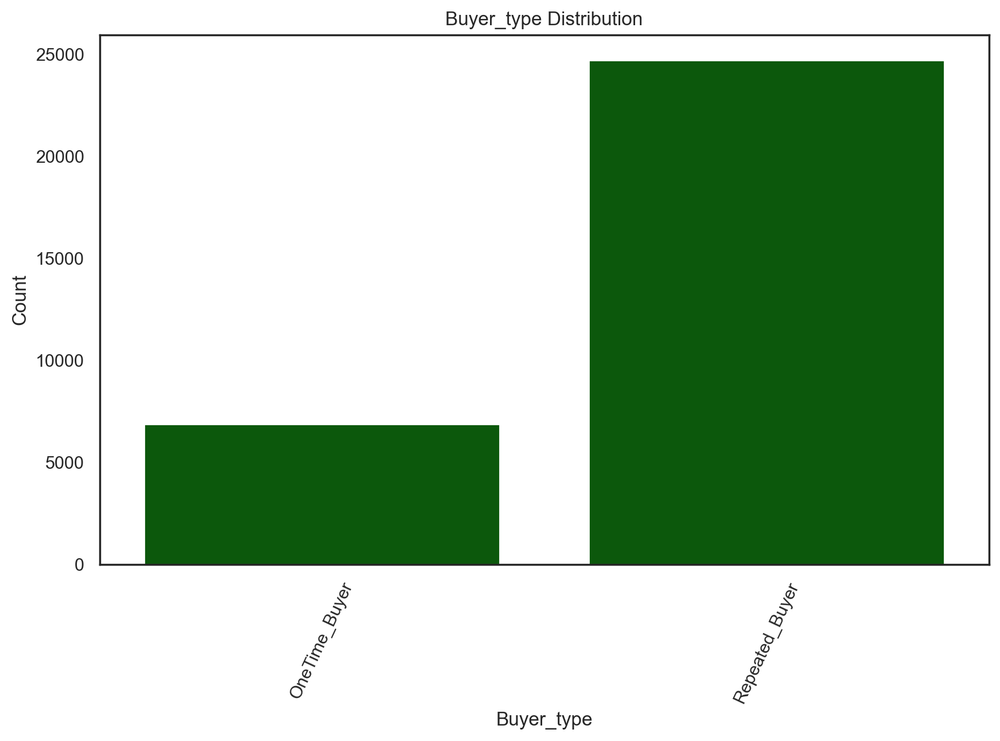

In [34]:
plot_categorical_analysis(data=ABCDE_clean, categorical_var="Buyer_type")

 <a class="anchor" id="Weekdays_Transactions"></a>
### 3.5.2. Weekdays Transactions

In [35]:
ABCDE_clean["Weekdays_Transactions"]= ABCDE_clean[["DOW_1","DOW_2","DOW_3","DOW_4","DOW_5"]].sum(axis=1)

In [36]:
ABCDE_clean.drop(columns=["DOW_1", "DOW_2", "DOW_3", "DOW_4", "DOW_5"], inplace=True)

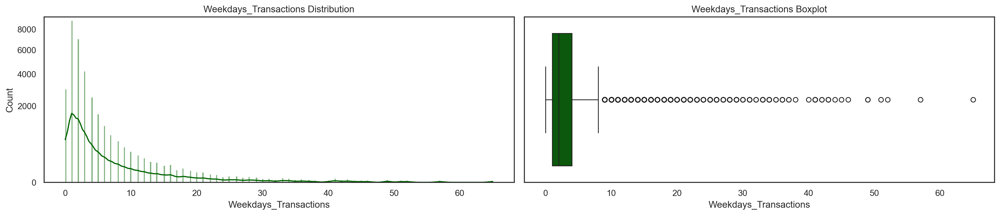

In [37]:
plot_numeric_variable(data=ABCDE_clean, variable="Weekdays_Transactions", sqrt_scale=True)

 <a class="anchor" id="weekends"></a>
### 3.5.3. Weekends Transactions

In [38]:
ABCDE_clean["Weekends_Transactions"]= ABCDE_clean[["DOW_0","DOW_6"]].sum(axis=1)

In [39]:
ABCDE_clean.drop(columns=["DOW_0", "DOW_6"], inplace=True)

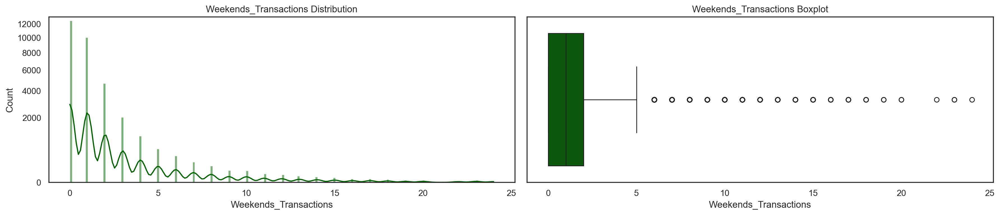

In [40]:
plot_numeric_variable(data=ABCDE_clean, variable="Weekends_Transactions", sqrt_scale=True)

<a class="anchor" id="morning"></a>
### 3.5.4. Morning Transactions 

In [41]:
ABCDE_clean["Morning_Transactions"]=ABCDE_clean[["HR_6","HR_7","HR_8","HR_9","HR_10","HR_11"]].sum(axis=1)

In [42]:
ABCDE_clean.drop(columns=["HR_6","HR_7","HR_8","HR_9","HR_10","HR_11"], inplace=True)

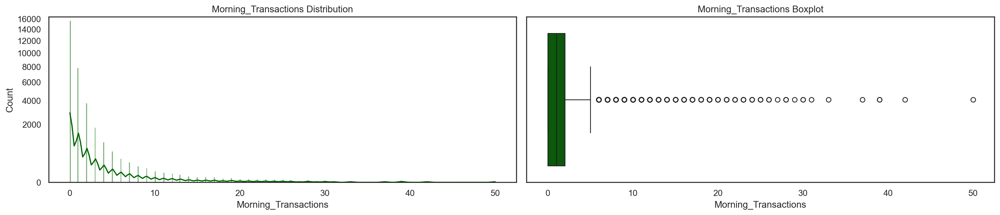

In [43]:
plot_numeric_variable(data=ABCDE_clean, variable="Morning_Transactions", sqrt_scale=True)

<a class="anchor" id="Afternoon"></a>
### 3.5.5. Afternoon Transactions 

In [44]:
ABCDE_clean["Afternoon_Transactions"]=ABCDE_clean[["HR_12","HR_13","HR_14","HR_15","HR_16","HR_17"]].sum(axis=1)

In [45]:
ABCDE_clean.drop(columns=["HR_12","HR_13","HR_14","HR_15","HR_16","HR_17"], inplace=True)

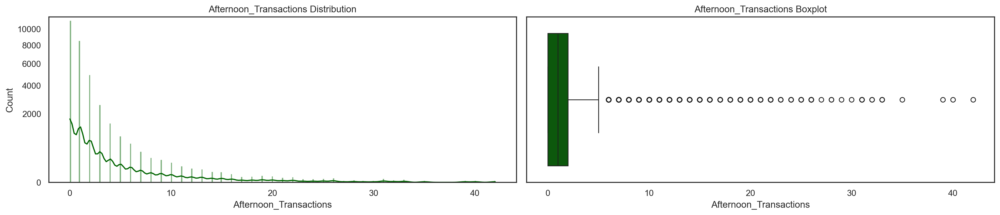

In [46]:
plot_numeric_variable(data=ABCDE_clean, variable="Afternoon_Transactions", sqrt_scale=True)

<a class="anchor" id="Evening"></a>
### 3.5.6. Evening Transactions 


In [47]:
ABCDE_clean["Evening_Transactions"]=ABCDE_clean[["HR_18","HR_19","HR_20","HR_21","HR_22","HR_23"]].sum(axis=1)

In [48]:
ABCDE_clean.drop(columns=["HR_18","HR_19","HR_20","HR_21","HR_22","HR_23"], inplace=True)

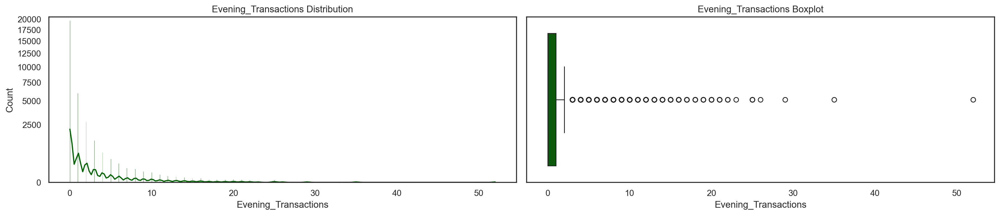

In [49]:
plot_numeric_variable(data=ABCDE_clean, variable="Evening_Transactions", sqrt_scale=True)

<a class="anchor" id="Night"></a>
### 3.5.7. Night Transactions 

In [50]:
ABCDE_clean["Night_Transactions"]=ABCDE_clean[["HR_0","HR_1","HR_2","HR_3","HR_4","HR_5"]].sum(axis=1)

In [51]:
ABCDE_clean.drop(columns=["HR_0","HR_1","HR_2","HR_3","HR_4","HR_5"], inplace=True)

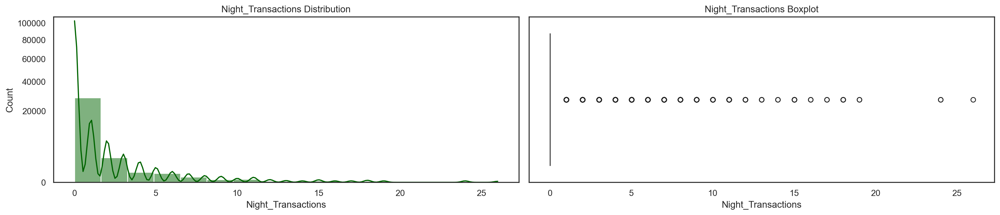

In [52]:
plot_numeric_variable(data=ABCDE_clean, variable="Night_Transactions", sqrt_scale=True)

<a class="anchor" id="Frequency"></a>

### 3.5.8. Frequency 

In [53]:
ABCDE_clean["Frequency"]= ABCDE_clean[["Weekdays_Transactions","Weekends_Transactions"]].sum(axis=1)

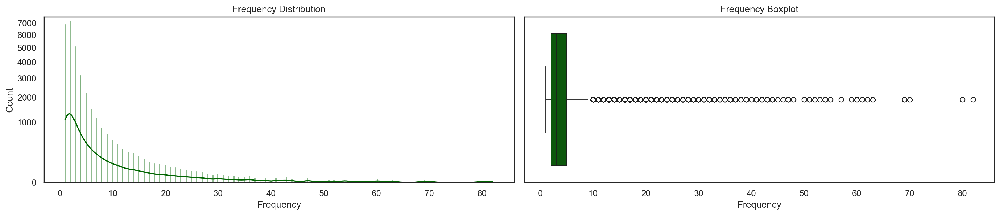

In [54]:
plot_numeric_variable(data=ABCDE_clean, variable="Frequency", sqrt_scale=True)

<a class="anchor" id="Mnt"></a>
### 3.5.9. Monetary Spending 

In [55]:
ABCDE_clean["Monetary_Spending"]= ABCDE_clean[['CUI_American', 'CUI_Asian', 'CUI_Beverages', 'CUI_Cafe', 'CUI_Chicken Dishes', 'CUI_Chinese', 'CUI_Desserts', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_Japanese', 'CUI_Noodle Dishes', 'CUI_OTHER', 'CUI_Street Food / Snacks', 'CUI_Thai']].sum(axis=1)

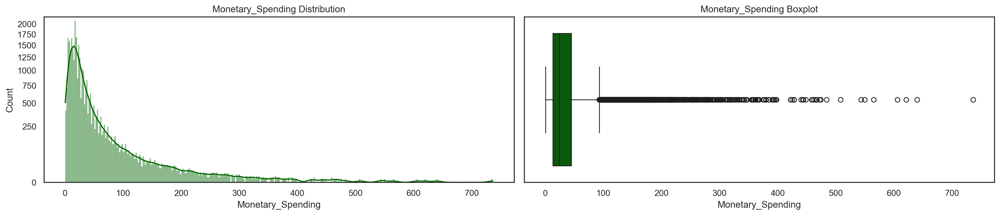

In [56]:
plot_numeric_variable(data=ABCDE_clean, variable="Monetary_Spending", sqrt_scale=True)

<a class="anchor" id="Eng"></a>
### 3.5.10. Engagement Span 

In [57]:
ABCDE_clean["Engagement_Span"] =ABCDE_clean['last_order']-ABCDE_clean['first_order']

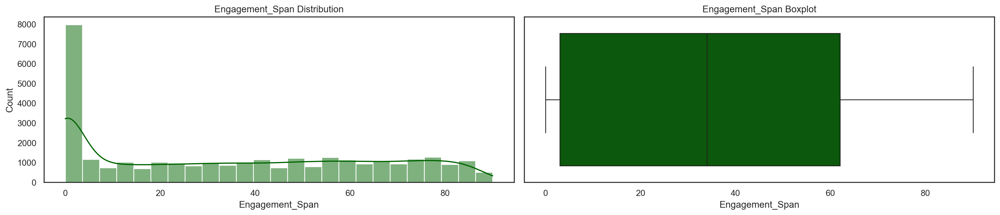

In [58]:
plot_numeric_variable(data=ABCDE_clean, variable="Engagement_Span")

<a class="anchor" id="Recency"></a>
 
### 3.5.11. Recency

In [59]:
ABCDE_clean["Recency"] =90-ABCDE_clean['last_order']

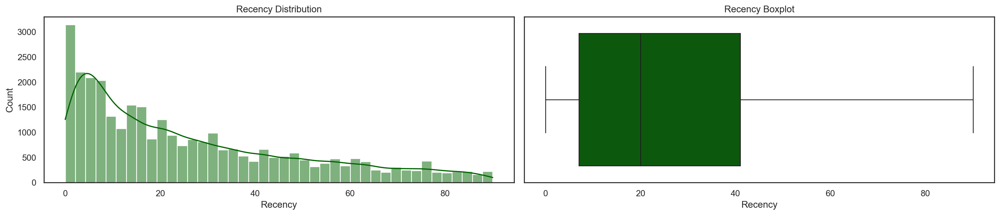

In [60]:
plot_numeric_variable(data=ABCDE_clean, variable="Recency")

 <a class="anchor" id="Spending_Budget"></a>
 
### 3.5.12. Spending Budget

`Step 1` We start by discretizing each budget by quartiles of monetary spending, with Q1 being the average spent by the 25% with lowest budget and Q4 the average spent by 25% spending the most:

In [61]:
q1 = ABCDE_clean['Monetary_Spending'].quantile(0.25)
q2 = ABCDE_clean['Monetary_Spending'].quantile(0.5)
q3 = ABCDE_clean['Monetary_Spending'].quantile(0.75)

In [62]:
ABCDE_clean[ABCDE_clean['Monetary_Spending'] >= q3]['Monetary_Spending'].describe()

count    7904.000000
mean       92.120439
std        56.307107
min        44.960000
25%        56.070000
50%        73.260000
75%       105.870000
max       736.150000
Name: Monetary_Spending, dtype: float64

In [63]:
q1_threshold = ABCDE_clean[ABCDE_clean['Monetary_Spending'] >= q1]['Monetary_Spending'].mean()
q2_threshold = ABCDE_clean[ABCDE_clean['Monetary_Spending'] >= q2]['Monetary_Spending'].mean()
q3_threshold = ABCDE_clean[ABCDE_clean['Monetary_Spending'] >= q3]['Monetary_Spending'].mean()

`Step 2` Defining a function to categorize each bin by the quartile it falls under:

In [64]:
def classif_quantile(value):
    if value <= q1_threshold:
        return 'Q1 (Low)'
    elif value > q1_threshold and value <= q2_threshold:
        return 'Q2 (Medium-Low)'
    elif value > q2_threshold and value <= q3_threshold:
        return 'Q3 (Medium-High)'
    else:
        return 'Q4 (High)'

`Step 3` Creating a new feature, capturing each budget category, applying the function

In [65]:
ABCDE_clean['Spending_Budget'] = ABCDE_clean['Monetary_Spending'].apply(classif_quantile)
ABCDE_clean['Spending_Budget'].describe()

count        31613
unique           4
top       Q1 (Low)
freq         24105
Name: Spending_Budget, dtype: object

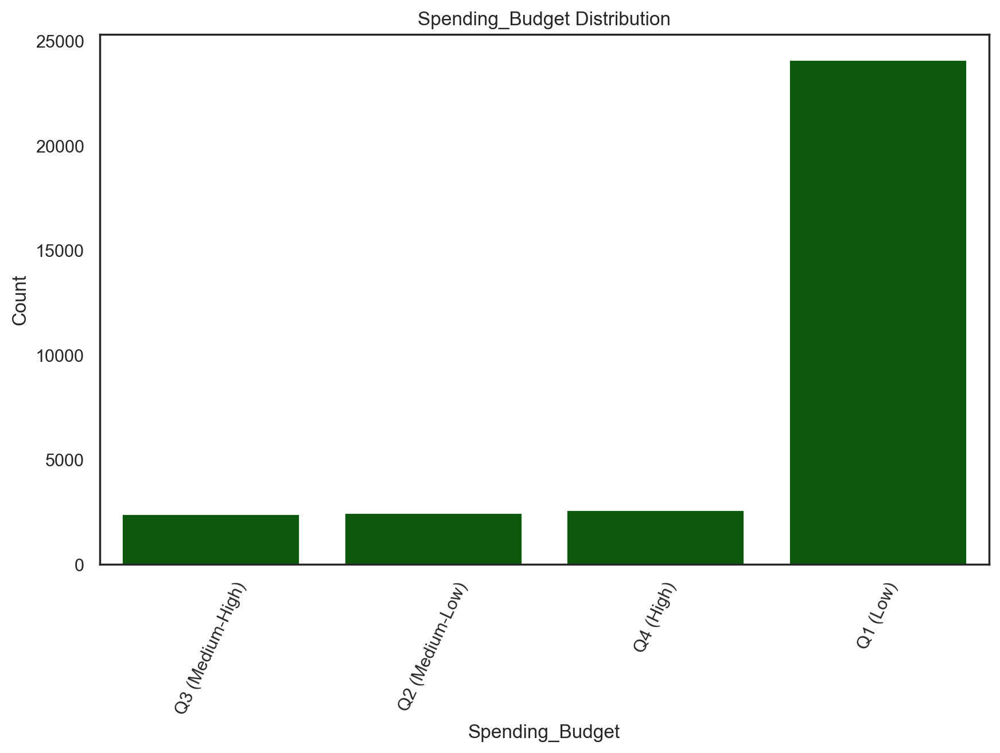

In [66]:
plot_categorical_analysis(data=ABCDE_clean, categorical_var="Spending_Budget")

<a class="anchor" id="Con"></a>

### 3.5.13. Consumer Segment: Individual vs Group transactions 

We want to identify which transactions are purchased by a group/family vs an individual. <br>
To do that, we must set a criteria to classify each transactions correctly. Considering product_count and Monetary_Spending the most relevant features, let's analyse the correct threshold for criteria:

`Step 1` Analysing product_count and Monetary_Spending

In [67]:
print("The median count of products per transaction is 3, which is also a fair quantity of products for an individual purchase")
ABCDE_clean['product_count'].describe()

The median count of products per transaction is 3, which is also a fair quantity of products for an individual purchase


count    31613.000000
mean         5.605194
std          6.442588
min          1.000000
25%          2.000000
50%          3.000000
75%          7.000000
max         97.000000
Name: product_count, dtype: float64

In [68]:
print("For a purchase of 3 or less products, the amount spent can be described as:")
ABCDE_clean[ABCDE_clean['product_count'] <= 3]['Monetary_Spending'].describe()

For a purchase of 3 or less products, the amount spent can be described as:


count    15917.000000
mean        16.147958
std          9.778298
min          0.370000
25%          8.020000
50%         14.730000
75%         22.660000
max         57.100000
Name: Monetary_Spending, dtype: float64

`Step 2` Define thresholds for classification

In [69]:
spend_threshold = ABCDE_clean[ABCDE_clean['product_count'] <= 3]['Monetary_Spending'].quantile(0.75)
pcount_threshold = ABCDE_clean['product_count'].median()

In [70]:
spend_threshold

22.66

`Step 3` Create a new feature, classifying each transaction

In [71]:
ABCDE_clean['Consumer_Segment'] = ABCDE_clean.apply(
    lambda x: 'Group/Family' if (x['product_count'] > pcount_threshold and x['Monetary_Spending'] > spend_threshold) else 'Individual',
    axis=1)
# if i buy more than 3 products and spend more than what most customers would spend on 3 products, i am buying for a group

`Step 3` Classify transactions

In [72]:
ABCDE_clean['Consumer_Segment'].value_counts()

Consumer_Segment
Individual      18763
Group/Family    12850
Name: count, dtype: int64

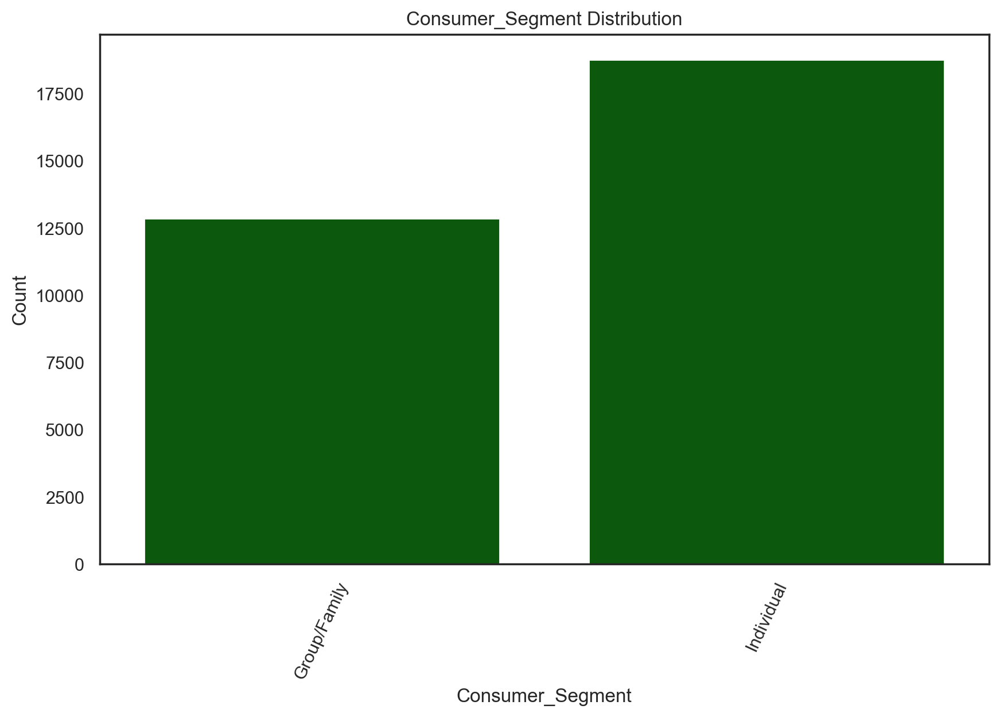

In [73]:
plot_categorical_analysis(data=ABCDE_clean, categorical_var="Consumer_Segment")

 <a class="anchor" id="Cities"></a>
 
### 3.5.14. Cities

In [74]:
# Replacing customer_region '-' to '8550'
ABCDE_clean.loc[ABCDE_clean['customer_region'] == '-', 'customer_region'] = '8550'
# Creating feature cities
ABCDE_clean['cities'] = ABCDE_clean['customer_region'].astype(str).str[:1]

In [75]:
ABCDE_clean.groupby(['cities', 'customer_region'], observed=True).agg({'product_count': ['min', 'max', 'mean']})


product_count              
                                 min max      mean
cities customer_region                            
2      2360                        1  97  6.543636
       2440                        1  80  6.264011
       2490                        1  33  5.534989
4      4140                        1  38  4.116959
       4660                        1  94  5.626949
8      8370                        1  22  3.767677
       8550                        1  35  4.670330
       8670                        1  64  4.896059

In [76]:
a = ABCDE_clean.groupby(['cities']).agg({'CUI_Cafe': 'sum','CUI_Asian': 'sum', 'CUI_Chicken Dishes': 'sum',  'CUI_Chinese': 'sum',  'CUI_Desserts': 'sum', 
       'CUI_Healthy': 'sum',  'CUI_Indian': 'sum',  'CUI_Italian': 'sum',  'CUI_Japanese': 'sum', 
       'CUI_Noodle Dishes': 'sum',  'CUI_OTHER': 'sum',  'CUI_Street Food / Snacks': 'sum', 
       'CUI_Thai': 'sum', 'Monetary_Spending': 'sum'})
sorted_a = a.apply(lambda x: x.sort_values(ascending=False), axis=1)
sorted_a.loc['Total'] = sorted_a.sum()
sorted_a

,CUI_Asian,CUI_Cafe,CUI_Chicken Dishes,CUI_Chinese,CUI_Desserts,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_Japanese,CUI_Noodle Dishes,CUI_OTHER,CUI_Street Food / Snacks,CUI_Thai,Monetary_Spending
cities,,,,,,,,,,,,,,
2,20323.09,2777.22,21732.52,26253.79,4401.34,4452.08,18769.81,7757.03,17489.59,21864.88,42623.94,3995.31,7618.35,244454.70
4,53026.97,21450.34,2118.26,5308.07,18.90,13349.75,32019.45,93356.76,39045.27,0.00,49718.10,6097.71,18436.01,407358.15
8,240385.31,0.00,0.00,12202.77,22822.43,11472.26,0.00,0.00,36910.03,0.00,987.11,112507.43,0.00,544833.01
Total,313735.37,24227.56,23850.78,43764.63,27242.67,29274.09,50789.26,101113.79,93444.89,21864.88,93329.15,122600.45,26054.36,1196645.86


In [77]:
ABCDE_clean.groupby(['cities']).agg({'product_count':['median', 'mean'], 'Monetary_Spending':['min','max', 'mean']})

product_count           Monetary_Spending                   
              median      mean               min     max       mean
cities                                                             
2                4.0  6.463353              0.37  392.22  22.795104
4                3.0  5.502175              1.12  565.27  39.369687
8                3.0  4.833333              0.47  736.15  51.682130

 <a class="anchor" id="Comb"></a>
 
### 3.5.15. Combining similar Cuisines from a business Perspectives

In [78]:
# Combine cuisines into broader categories
ABCDE_clean['CUI_Asian_Fusion'] = (ABCDE_clean['CUI_Asian'] + 
                                    ABCDE_clean['CUI_Thai'] +  
                                    ABCDE_clean['CUI_Chinese'] + 
                                    ABCDE_clean['CUI_Noodle Dishes'] +
                                   ABCDE_clean['CUI_Japanese'])  



ABCDE_clean['CUI_Sweets_and_Beverages'] = (ABCDE_clean['CUI_Beverages'] + 
                                            ABCDE_clean['CUI_Desserts'] + 
                                            ABCDE_clean['CUI_Cafe'])

ABCDE_clean['CUI_Snacks'] = (ABCDE_clean['CUI_Street Food / Snacks'] + 
                                          ABCDE_clean['CUI_Chicken Dishes'])




In [79]:
# Optionally drop individual cuisines after combining
ABCDE_clean = ABCDE_clean.drop(columns=['CUI_Asian', 'CUI_Street Food / Snacks'
                                        , 'CUI_Beverages',
                                         'CUI_Chinese', 'CUI_Desserts',
                                        'CUI_Thai', 'CUI_Cafe', 'CUI_Noodle Dishes', 'CUI_Chicken Dishes','CUI_Japanese'])


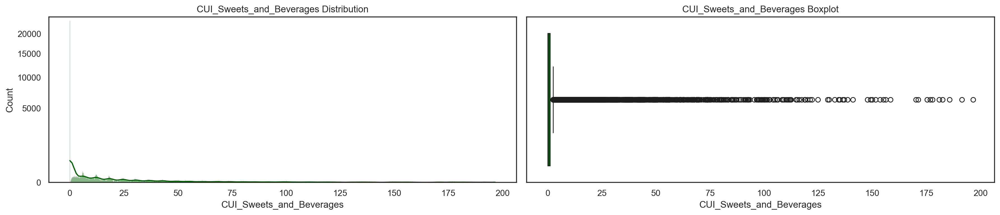

In [263]:
plot_numeric_variable(data=ABCDE_clean, variable="CUI_Sweets_and_Beverages", sqrt_scale=True)

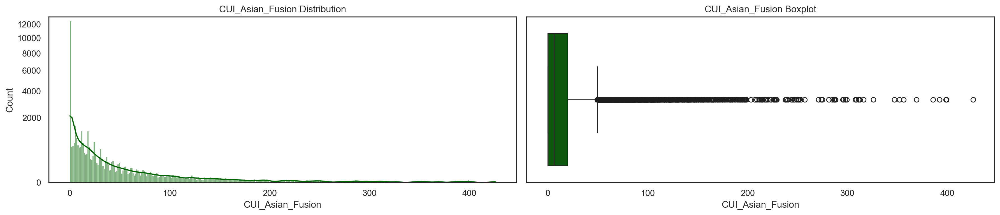

In [264]:
plot_numeric_variable(data=ABCDE_clean, variable='CUI_Asian_Fusion', sqrt_scale=True)

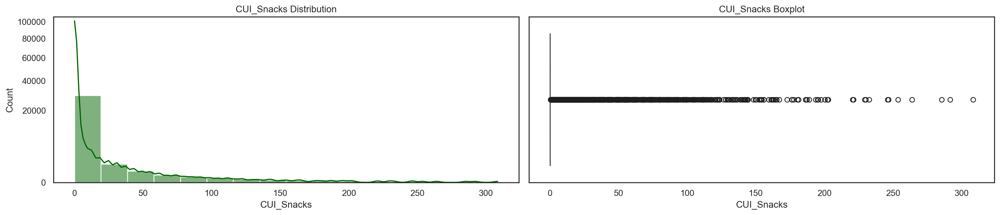

In [265]:
plot_numeric_variable(data=ABCDE_clean, variable='CUI_Snacks', sqrt_scale=True)

<a class="anchor" id="Further_Analysis">

## 3.6. Further Analysis 
</a>

In [82]:
ABCDE_copy = ABCDE_clean.copy()

<a class="anchor" id="contigency"></a>
### 3.6.1 Contingency Tables 

`Step 1` Equal depth binning

In [83]:
q1_mon = ABCDE_copy['Monetary_Spending'].quantile(0.25)
q2_mon = ABCDE_copy['Monetary_Spending'].quantile(0.5)
q3_mon = ABCDE_copy['Monetary_Spending'].quantile(0.75)
q4_mon = ABCDE_copy['Monetary_Spending'].quantile(1)
print(f"Discretization by bins of equal depth, respectively, {q1_mon}, {q2_mon}, {q3_mon}, {q4_mon}")

Discretization by bins of equal depth, respectively, 13.01, 24.17, 44.96000000000001, 736.15


In [84]:
q1_freq = ABCDE_copy['Frequency'].quantile(0.25)
q2_freq = ABCDE_copy['Frequency'].quantile(0.5)
q3_freq = ABCDE_copy['Frequency'].quantile(0.75)
q4_freq = ABCDE_copy['Frequency'].quantile(1)
print(f"Discretization by bins of equal depth, respectively, {q1_freq}, {q2_freq}, {q3_freq}, {q4_freq}")

Discretization by bins of equal depth, respectively, 2.0, 3.0, 5.0, 82.0


In [85]:
q1_rec = ABCDE_copy['Recency'].quantile(0.25)
q2_rec = ABCDE_copy['Recency'].quantile(0.5)
q3_rec = ABCDE_copy['Recency'].quantile(0.75)
print(f"Discretization by bins of equal depth, respectively, {q1_rec}, {q2_rec}, {q3_rec}")

Discretization by bins of equal depth, respectively, 7.0, 20.0, 41.0


`Step 2` Divide each feature into significant quantiles

In [86]:
bins = [0, 13.01, 24.17, 44.96, 736.15]  # Example: categorize recency into 3 groups
labels = ['0-13 Value', '13-24 Value', '24-44 Value', '>45 Value']
ABCDE_copy['Monetary_Rank'] = pd.cut(ABCDE_copy['Monetary_Spending'], bins=bins, labels=labels)

In [87]:
bins = [0, 2, 3, 5, 82]  # Example: categorize recency into 3 groups
labels = ['0-1 Transac', '2-3 Transac', '4-5 Transac', '>5 Transac']
ABCDE_copy['Frequency_Rank'] = pd.cut(ABCDE_copy['Frequency'], bins=bins, labels=labels)

In [88]:
bins = [0, 7, 20, 41, 90]  # Example: categorize recency into 3 groups
labels = ['0-7 Days', '8-20 Days', '21-41 Days', '>41 Days']
ABCDE_copy['Recency_Rank'] = pd.cut(ABCDE_copy['Recency'], bins=bins, labels=labels)

`Step 3` Present contigency tables

If we draw an imaginary diagonal line from the upper left corner to the lower right, we can see that:

#### Monetary Spending vs Frequency

In [89]:
contingency_table = pd.crosstab(ABCDE_copy['Monetary_Rank'], ABCDE_copy['Frequency_Rank'], margins=True, margins_name='TOTAL', normalize=True)  # Adds row and column totals
contingency_table

Frequency_Rank,0-1 Transac,2-3 Transac,4-5 Transac,>5 Transac,TOTAL
Monetary_Rank,,,,,
0-13 Value,0.197356,0.034796,0.016291,0.001677,0.250119
13-24 Value,0.143802,0.051055,0.039446,0.015595,0.249897
24-44 Value,0.087939,0.052731,0.060735,0.048556,0.249960
>45 Value,0.016322,0.022396,0.053459,0.157846,0.250024
TOTAL,0.445418,0.160978,0.169930,0.223674,1.000000


- **values furthest and above the line:** customers who spend lower amounts frequently
- **values furthest and under the line:** customers who spend higher amounts with less frequency
- **values closest to the line:** customers who spend at a relatively similar proportion across frequency and monetary value.

#### Monetary Spending vs Recency

In [90]:
contingency_table = pd.crosstab(ABCDE_copy['Monetary_Rank'], ABCDE_copy['Recency_Rank'], margins=True, margins_name='TOTAL', normalize=True)   # Adds row and column totals
contingency_table

Recency_Rank,0-7 Days,8-20 Days,21-41 Days,>41 Days,TOTAL
Monetary_Rank,,,,,
0-13 Value,0.035021,0.045882,0.067889,0.101390,0.250182
13-24 Value,0.049682,0.059213,0.067224,0.073684,0.249802
24-44 Value,0.065926,0.069187,0.064121,0.050727,0.249960
>45 Value,0.118901,0.074190,0.040531,0.016434,0.250055
TOTAL,0.269529,0.248472,0.239764,0.242234,1.000000


- **values furthest and above the line:** customers who spend lower amounts and haven't visited recently
- **values furthest and under the line:** customers who spend higher amounts but have visited recently
- **values closest to the line:** customers who spend at a relatively similar proportion across recency of visit and monetary value.

Further analysis can be seen following RFM analysis.

<a class="anchor" id="RFM"></a>
## 3.6.2 RFM Analysis 

In this analysis, we will rate Recency, Frequency, and Monetary Spending on a scale from 1 to 4 (as a result of equal-depth quartile bins), where 1 represents the least recent, frequent, or monetary spending, and 4 represents the most. Then, customers will be grouped by combinations of this rating, resulting in 4x4x4=64 combinations - this is our RFM scores. <br>
The summarized data will provide meaningful insights into customer segmentation.

`Step 1` Rename the categories obtain through equal depth quartile binning, into more descriptive and adequate categories, using "R,F,M 1-4"

In [91]:
# Rank the values into quantiles or bins (optional for segmentation)
# Replace old labels with new labels
ABCDE_copy['Recency_Rank'] = ABCDE_copy['Recency_Rank'].replace({
    '0-7 Days': 'R4',
    '8-20 Days': 'R3',
    '21-41 Days': 'R2',
    '>41 Days': 'R1'})

In [92]:
# Replace old frequency labels with new labels
ABCDE_copy['Frequency_Rank'] = ABCDE_copy['Frequency_Rank'].replace({
    '0-1 Transac': 'F1',
    '2-3 Transac': 'F2',
    '4-5 Transac': 'F3',
    '>5 Transac': 'F4'})

In [93]:
ABCDE_copy['Monetary_Rank'] = ABCDE_copy['Monetary_Rank'].replace({
    '0-13 Value': 'M1',
    '13-24 Value': 'M2',
    '24-44 Value': 'M3',
    '>45 Value': 'M4'})

`Step 2` Combining the ranks into a single RFM score

In [94]:
# Combine the ranks into a single RFM score
ABCDE_copy['RFM_Score'] = ABCDE_copy['Recency_Rank'].astype(str) + ABCDE_copy['Frequency_Rank'].astype(str) + ABCDE_copy['Monetary_Rank'].astype(str)

`Step 3` Create RFM dataframe with the engineered features, aligning index with our working dataset

In [95]:
# create RFM df from ABCDE's 
RFM = ABCDE_copy.reset_index()

In [96]:
RFM.set_index('customer_id', inplace=True)

In [97]:
ABCDE_copy.index == RFM.index

array([ True,  True,  True, ...,  True,  True,  True])

`Step 4` Organize the RFM analysis into a comprehensive scheme, by performing a group-by operation on each RFM score.

In [98]:
rfm_ = RFM.groupby(['Recency_Rank', 'Frequency_Rank', 'Monetary_Rank']).agg(
    Customers_count=('RFM_Score', 'size'))  # Count of customers in each RFM group

# Show all rows
pd.set_option('display.max_columns', None)

styled_rfm = rfm_.style.background_gradient(cmap='Greens')

# Display the styled DataFrame in a Jupyter Notebook or similar environment
styled_rfm

### RFM Analysis - Quick insights 

In [176]:
RFM[RFM['RFM_Score'].isin(['R1F1M1'])]['Consumer_Segment'].value_counts()

Consumer_Segment
Individual    2839
Name: count, dtype: int64

In [398]:
RFM[RFM['RFM_Score'].isin(['R1F1M1'])]['last_promo'].value_counts()

last_promo
-           1044
DELIVERY     874
DISCOUNT     590
FREEBIE      331
Name: count, dtype: int64

In [410]:
RFM[RFM['RFM_Score'].isin(['R1F1M1'])]['cities'].value_counts()

cities
2    1669
4     756
8     414
Name: count, dtype: int64

In [422]:
RFM[RFM['RFM_Score'].isin(['R1F1M1'])]['Buyer_type'].value_counts(normalize=True)

Buyer_type
OneTime_Buyer     0.715393
Repeated_Buyer    0.284607
Name: proportion, dtype: float64

In [386]:
RFM[RFM['RFM_Score'].isin(['R4F4M4'])]['Consumer_Segment'].value_counts()

Consumer_Segment
Group/Family    2933
Name: count, dtype: int64

In [400]:
RFM[RFM['RFM_Score'].isin(['R4F4M4'])]['payment_method'].value_counts()

payment_method
CARD    2236
DIGI     397
CASH     300
Name: count, dtype: int64

In [402]:
RFM[RFM['RFM_Score'].isin(['R4F4M4'])]['Buyer_type'].value_counts()

Buyer_type
Repeated_Buyer    2933
Name: count, dtype: int64

In [412]:
RFM[RFM['RFM_Score'].isin(['R4F4M4'])]['cities'].value_counts()

cities
4    1250
8     910
2     773
Name: count, dtype: int64

### Contingency Tables Analysis - Further insights 

#### Monetary Spending vs Frequency

**Chance for improvement - low frequency and monetary spending**

In [402]:
print(f"There is a total of {len(ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)])} customers displaying low frequency and monetary spending.")

There is a total of 6239 customers displaying low frequency and monetary spending.


In [393]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)]['Afternoon_Transactions'].value_counts()

Afternoon_Transactions
0    3130
1    2543
2     566
Name: count, dtype: int64

In [339]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)]['cities'].value_counts()

cities
2    3602
4    1744
8     893
Name: count, dtype: int64

In [345]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)]['is_chain'].value_counts()

is_chain
1    4798
0    1441
Name: count, dtype: int64

In [343]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)]['last_promo'].value_counts(normalize=True)

last_promo
-           0.387402
DELIVERY    0.288187
DISCOUNT    0.194903
FREEBIE     0.129508
Name: proportion, dtype: float64

In [349]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q1_mon) & (ABCDE_copy['Frequency'] <= q1_freq)]['Buyer_type'].value_counts(normalize=True)

Buyer_type
OneTime_Buyer     0.623658
Repeated_Buyer    0.376342
Name: proportion, dtype: float64

**Ideal sector - high frequency and monetary spending**

In [404]:
print(f"There is a total of {len(ABCDE_copy[(ABCDE_copy['Monetary_Spending'] >= q3_mon) & (ABCDE_copy['Frequency'] <= q2_freq)])} customers displaying low frequency and monetary spending.")

There is a total of 1224 customers displaying low frequency and monetary spending.


In [395]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] >= q3_mon) & (ABCDE_copy['Frequency'] <= q2_freq)]['cities'].value_counts()

cities
8    1054
4     153
2      17
Name: count, dtype: int64

In [410]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] >= q3_mon) & (ABCDE_copy['Frequency'] <= q2_freq)]['is_chain'].value_counts(normalize=True)

is_chain
1    0.713235
0    0.286765
Name: proportion, dtype: float64

In [414]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] >= q3_mon) & (ABCDE_copy['Frequency'] <= q2_freq)]['Consumer_Segment'].value_counts(normalize=True)

Consumer_Segment
Group/Family    0.937908
Individual      0.062092
Name: proportion, dtype: float64

In [416]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] >= q3_mon) & (ABCDE_copy['Frequency'] <= q2_freq)]['last_promo'].value_counts(normalize=True)

last_promo
-           0.574346
DELIVERY    0.165033
FREEBIE     0.156863
DISCOUNT    0.103758
Name: proportion, dtype: float64

#### Monetary Spending vs Recency

**Potential Sector - low frequency and high monetary spending**

In [427]:
print(f"There is a total of {len(ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q3_mon) & (ABCDE_copy['Recency'] <= q1_rec)])} customers displaying low recency and high monetary spending.")

There is a total of 4783 customers displaying low recency and high monetary spending.


In [432]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q3_mon) & (ABCDE_copy['Recency'] <= q1_rec)]['is_chain'].value_counts(normalize=True)

is_chain
1    0.825214
0    0.174786
Name: proportion, dtype: float64

In [438]:
ABCDE_copy[(ABCDE_copy['Monetary_Spending'] <= q3_mon) & (ABCDE_copy['Recency'] <= q1_rec)]['cities'].value_counts(normalize=True)

cities
2    0.432783
4    0.337236
8    0.229981
Name: proportion, dtype: float64

In this analysis, we will rate Recency, Frequency and Monetary Spending from 1 to 4 equal depth quarters, where 1 is the least and 4 is the most recent, frequent, monetary spenditure. 


 <a class="anchor" id="Feature_Scaling"></a>

## 3.7. Feature Scaling

#### Normalization using Minmax Scaler

In [101]:
#Creating the metric list
new_metric_features = ABCDE_clean.select_dtypes(include=np.number).columns

In [102]:
# 1. Apply log transformation (log(1 + x) to avoid log(0) issues)
log_transformed_data = np.log1p(ABCDE_clean[new_metric_features])

# Initialize MinMaxScaler
scaler = MinMaxScaler()

# Fit the scaler on the data and transform it
ABCDE_scaled = scaler.fit_transform(log_transformed_data)

# Convert scaled data into a DataFrame with the same index as the original DataFrame
ABCDE_scaled_df = pd.DataFrame(ABCDE_scaled, columns=new_metric_features, index=ABCDE_clean.index)

# Select the non-metric features from the original data
non_metric_features = ABCDE_clean.drop(columns=new_metric_features)

# Combine the scaled metric features with the non-metric features (ensure no new rows are added)
ABCDE_combined = pd.concat([ABCDE_scaled_df, non_metric_features], axis=1)

<a class="anchor" id="knn"></a>

## 3.8. KNN Imputation 

#### Imputation of the missing values in customer_age 

In [103]:
# Initialize the KNN imputer
imputer = KNNImputer()

# Fit and transform the data using KNN imputer (only for the new metric features)
ABCDE_scaled_imputed = imputer.fit_transform(ABCDE_combined[new_metric_features])

# Convert the resulting numpy array back to a pandas DataFrame with the correct column names
ABCDE_scaled_imputed_df = pd.DataFrame(ABCDE_scaled_imputed, columns=new_metric_features, index=ABCDE_combined.index)

# Combine the imputed metric features with the non-metric features
non_metric_features = ABCDE_combined.drop(columns=new_metric_features)
ABCDE_final = pd.concat([ABCDE_scaled_imputed_df, non_metric_features], axis=1)


<a class="anchor" id="one"></a>

## 3.9. One-Hot Encoding for categorical data - profiling

In [104]:
# Create a copy of the final DataFrame
ABCDE_ohc = ABCDE_final.copy()

# Select categorical features (object and category columns)
categorical_features = ABCDE_ohc.select_dtypes(include=["object", "category"]).columns

# Initialize OneHotEncoder
ohc = OneHotEncoder(sparse_output=False)

# Apply OneHotEncoding to the categorical columns
ohc_feat = ohc.fit_transform(ABCDE_ohc[categorical_features])

# Get the feature names after encoding
ohc_feat_names = ohc.get_feature_names_out(categorical_features)

# Convert the encoded features to a DataFrame
ohc_ABCDE = pd.DataFrame(ohc_feat, index=ABCDE_ohc.index, columns=ohc_feat_names)

# Concatenate the new DataFrame with the original one
ABCDE_ohc = pd.concat([ABCDE_ohc, ohc_ABCDE], axis=1)

# Update the final DataFrame
ABCDE_final = ABCDE_ohc.copy()
# Dropping categorical Variables
ABCDE_final = ABCDE_final.drop(columns=['customer_region', 'last_promo', 'payment_method','cities','is_chain','Buyer_type','Spending_Budget','Consumer_Segment'])


<a class="anchor" id="DB"></a>

## 3.10. DBSCAN Multivariate Outliers 

#### Using a K-Distance Plot to Find epsilon

In [105]:
ABCDE_final[new_metric_features].shape

(31613, 23)

- MinPts: As a rule of thumb, minPts = 2 x dim can be used, but it may be necessary to choose larger values for very large data, for noisy data or for data that contains many duplicates.
so minPts = 27*2 =54
- ε: The value for ε can then be chosen by using a k-distance graph, plotting the distance to the kth (k = minPts - 1) nearest neighbor ordered from the largest to the smallest value. Good values of ε are where this plot shows an "elbow": if ε is chosen much too small, a large part of the data will not be clustered; whereas for a too high value of ε, clusters will merge and the majority of objects will be in the same cluster. so k=45

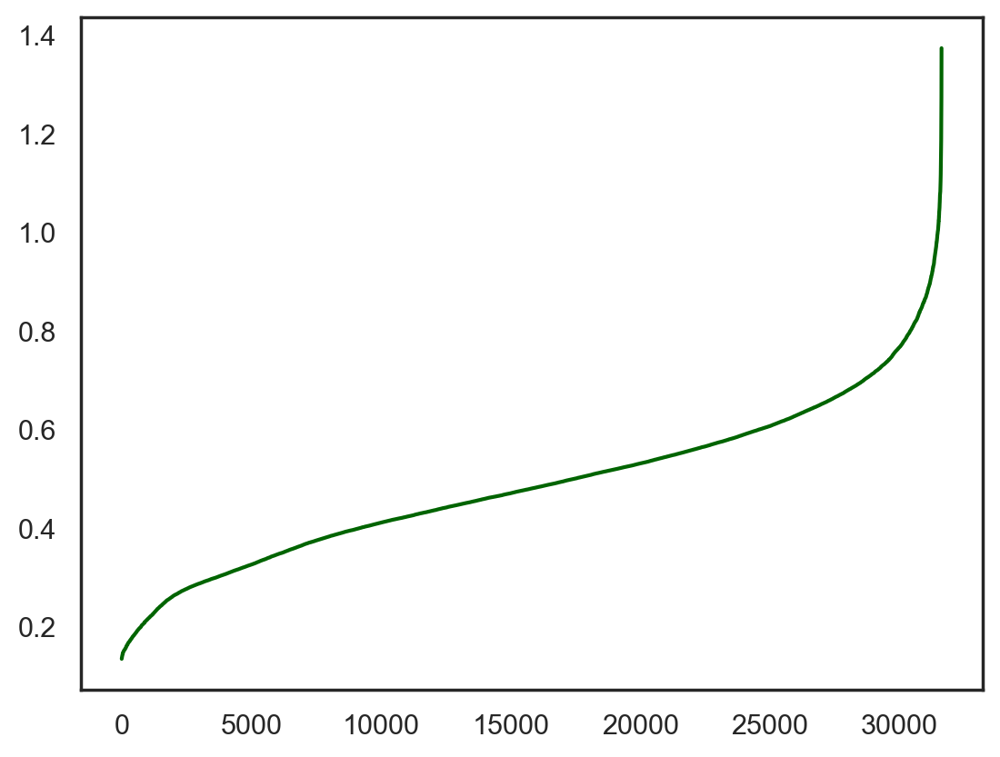

In [106]:
# K-distance graph to find out the right epsilon value
sns.set_style("white")
neigh = NearestNeighbors(n_neighbors=47)
neigh.fit(ABCDE_final[new_metric_features])
distances, _ = neigh.kneighbors(ABCDE_final[new_metric_features])
distances = np.sort(distances[:, -1])
plt.plot(distances, color='darkgreen')
plt.show()

From the graph we can notice that the elbow is around 0.8 so we can assume that 0.8 is epsilon

In [107]:
dbscan = DBSCAN(eps=0.8, min_samples=47, n_jobs=4)
#n_jobs: limits the algorithm to use 4 cores, which can speed up computations for large datasets.
dbscan_labels = dbscan.fit_predict(ABCDE_final[new_metric_features])
Counter(dbscan_labels)


Counter({0: 31478, -1: 135})

In [108]:
# Save the detected outliers (-1 indicates outliers)
ABCDE_outliers = ABCDE_final[dbscan_labels == -1].copy()

# Remove outliers from the main DataFrame
ABCDE_out = ABCDE_final[dbscan_labels != -1].copy()

In [109]:
print('Percentage of data kept after removing outliers:', np.round(ABCDE_out.shape[0] / ABCDE_final.shape[0], 4))

Percentage of data kept after removing outliers: 0.9957


<a class="anchor" id="Feature_Selection">

# 4. Feature Selection  
</a>

<a class="anchor" id="correlation"></a>

### 4.1. Correlation Matrix of New Numeric Features


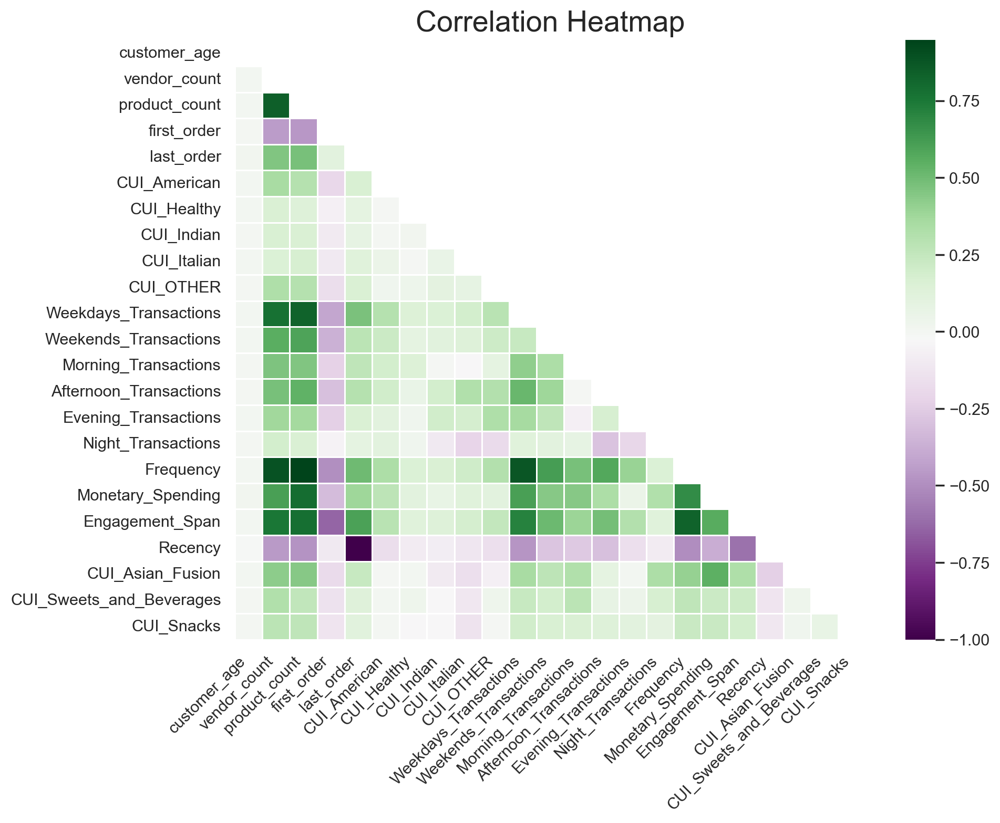

In [110]:
fig = plt.figure(figsize=(10, 8))

#Obtain correlation matrix. 
spearman = ABCDE_out[new_metric_features].corr(method="spearman")
#Generating a mask for the upper triangle
mask = np.triu(np.ones_like(spearman, dtype=bool))

#Plot heatmap of the correlation matrix
sns.heatmap(data=spearman, mask=mask, annot=False, cmap='PRGn', cbar=True, square=False, linewidths=0.5)

plt.title('Correlation Heatmap', fontsize=20)
plt.xticks(rotation=45, ha='right')  
plt.yticks(rotation=0)  
plt.tight_layout()  

plt.show()

#### Checking for multicullinearity

To check for multicollinearity, we identify pairs of features who are highly correlated, defining a threshold of redundancy of |0.8|. <br>
To decide which feature from the pair may be more relevant to keep, we introduce a metric that checks with how many other features each is significantly correlated with. <br>
We define there is a significant correlation between features if they are correlated in over 0.4 but lower that the threshold for redundancy.

**For a threshold of redundancy of 0.8, here are the pair of features that are highly correlated:**

We consider a significant correlation between features if higher than |0.35| and lower than threshold.

In [111]:
corr_pairs(spearman, 0.80)

0.84 : vendor_count | significantly correlated with 11 more features | or | product_count | significantly correlated with 10 more features
0.89 : vendor_count | significantly correlated with 11 more features | or | Frequency | significantly correlated with 9 more features
0.83 : product_count | significantly correlated with 10 more features | or | Weekdays_Transactions | significantly correlated with 10 more features
0.95 : product_count | significantly correlated with 10 more features | or | Frequency | significantly correlated with 9 more features
-1.00 : last_order | significantly correlated with 6 more features | or | Recency | significantly correlated with 6 more features
0.88 : Weekdays_Transactions | significantly correlated with 10 more features | or | Frequency | significantly correlated with 9 more features
0.83 : Frequency | significantly correlated with 9 more features | or | Engagement_Span | significantly correlated with 10 more features


In [112]:
ABCDE_out.drop(columns=["product_count","Frequency","last_order"], inplace=True)


So from these observations since product_count are highly correlated with many variables we decided not to include them in the perspective
Also since frequency is highly correlated with weekends and weekday and we want to capture the pattern frequency of customers during weekdays or weekends we will also not include frequency

**We considered variables that have a correlation of 0 or close to 0 as irrelevant**

In [113]:
ABCDE_out.drop(columns=["customer_age"], inplace=True)

In [114]:
new_metric_features = list(set(new_metric_features) - set(['customer_age', 'product_count', 'last_order', 'Frequency']))

<a class="anchor" id="univariance"></a>
    
## 4.2. Univariance

In [115]:
round(ABCDE_out[new_metric_features].var(), 6)

CUI_Italian                 0.036397
Night_Transactions          0.019943
CUI_Healthy                 0.015114
Weekends_Transactions       0.032862
CUI_Asian_Fusion            0.066980
vendor_count                0.030988
Monetary_Spending           0.020199
Weekdays_Transactions       0.024008
Afternoon_Transactions      0.032883
Morning_Transactions        0.025342
CUI_OTHER                   0.037681
CUI_American                0.051088
first_order                 0.066947
CUI_Snacks                  0.041388
Engagement_Span             0.138136
Recency                     0.054501
CUI_Sweets_and_Beverages    0.045423
Evening_Transactions        0.021764
CUI_Indian                  0.023741
dtype: float64

There is no low variance features to drop.

<a class="anchor" id="Clustering">
    
# 5. Clustering  
</a>

**Models that will be used:**
- Hierarchical Clustering
- K-means 
- SOMs
- DBSCAN
- Mean Shift
- Gaussian Mixture-Model


**Suggested Perspectives:**

**1. Value/ Behavior-Based Segmentation: Group customers based on their economic value, spending patterns and purchasing habits.**

In [117]:
ABCDE_VB = ABCDE_out[["Monetary_Spending","Recency","Weekdays_Transactions", "Weekends_Transactions", "Morning_Transactions", "Afternoon_Transactions", "Evening_Transactions","Night_Transactions","Engagement_Span"]]

**2. Preference-Based Segmentation: Group customers based on their cuisine preferences:**

In [118]:
ABCDE_PB = ABCDE_out[['CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian', 'CUI_OTHER', 'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks']]

<a class="anchor" id="beh">

## 5.1. Behavior-Based Segmentation

</a>

 <a class="anchor" id="km">

### 5.1.1. K-means and Hierarchical clustering
</a>

Here we're defining the functions of the metrics needed to calculate the Rsquare

In [119]:
# Set up the clusters
kmeans = KMeans(init='k-means++', n_init=20, random_state=42)
hc_methods = ["ward", "complete", "average", "single"]

**Finding the optimal cluster on Behavioral variables using Elbow Hierarchical Method:**

In [123]:
# Obtaining the R² scores for each cluster solution on demographic variables
# This may take some time to run
feats_VB= ["Monetary_Spending","Recency","Weekdays_Transactions", "Weekends_Transactions", "Morning_Transactions", "Afternoon_Transactions", "Evening_Transactions","Night_Transactions","Engagement_Span"]
r2_scores_VB = {}

# Get KMeans R² scores
r2_scores_VB['kmeans'] = get_r2_scores(ABCDE_VB, feats_VB, kmeans)

# Get R² scores for hierarchical clustering methods
for link in hc_methods:
    hierarchical = AgglomerativeClustering(linkage=link, metric='euclidean')
    r2_scores_VB[link] = get_r2_scores(ABCDE_VB, feats_VB, hierarchical)

In [124]:
r2_scores_VB = pd.DataFrame(r2_scores_VB)

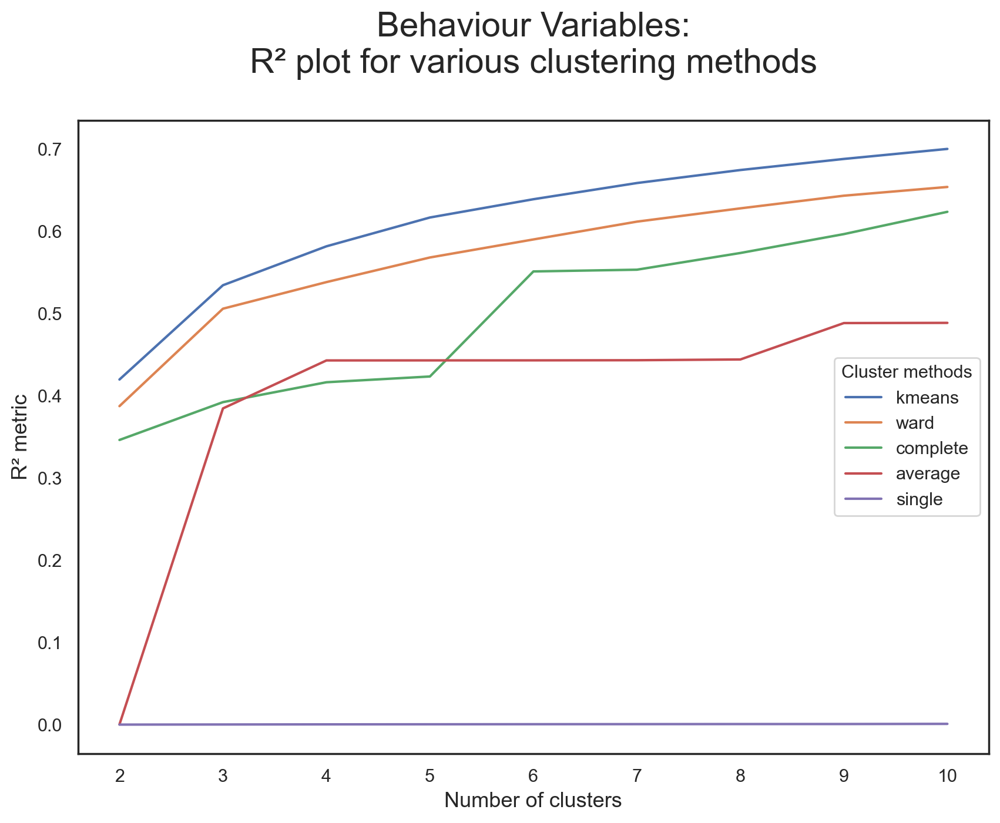

In [125]:
# Visualizing the R² scores for each cluster solution on demographic variables
r2_scores_VB.plot.line(figsize=(10,7))
plt.title("Behaviour Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

**Finding the optimal clusterer on Behavioral variables using Inertia and Silohette:**

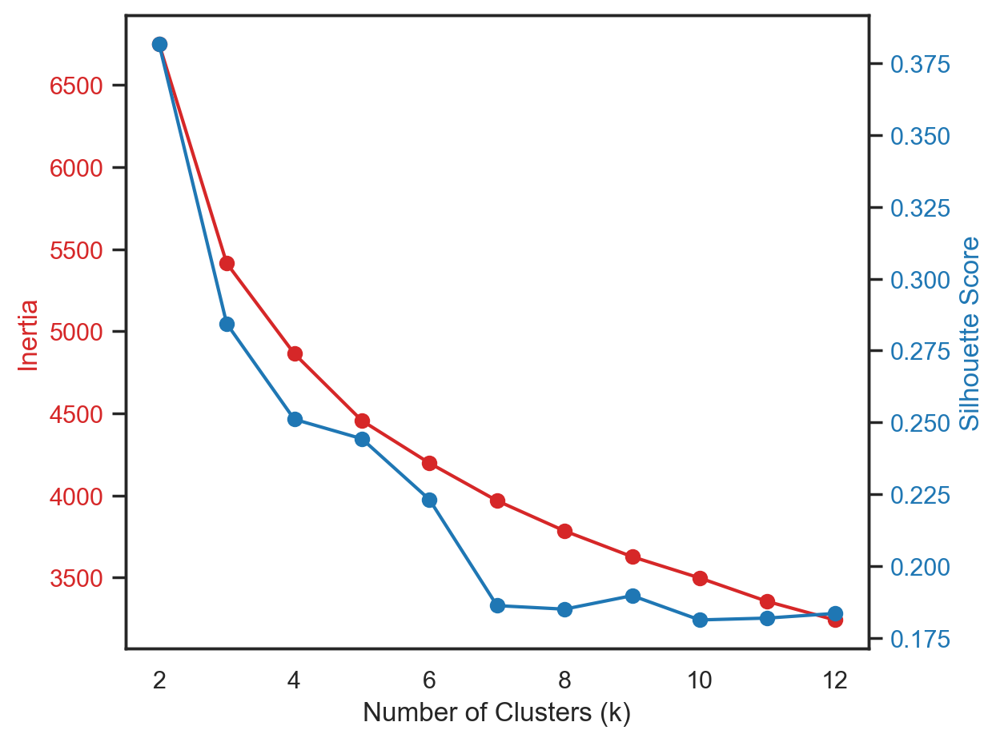

In [126]:
inertia_and_silhouette_plots(ABCDE_VB,2,12)

**K-Means with 3 Clusters seems like the best option**

In [119]:
# Creating a copy of the financial dataframe for K-Means clustering
ABCDE_VB_KM = ABCDE_VB.copy()

# Applying K-Means clustering with 3 clusters
kmeans_model = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=42)
ABCDE_VB_KM['cluster_labels_VB'] = kmeans_model.fit_predict(ABCDE_VB)

# Calculating the mean values for each cluster
cluster_means = ABCDE_VB_KM.groupby('cluster_labels_VB').mean()
cluster_means


,Monetary_Spending,Recency,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Engagement_Span
cluster_labels_VB,,,,,,,,,
0,0.598791,0.401996,0.446474,0.357187,0.255591,0.357905,0.186205,0.096116,0.930763
1,0.451269,0.678672,0.261456,0.160528,0.116492,0.170863,0.087783,0.073829,0.763233
2,0.355615,0.782522,0.133597,0.072984,0.054797,0.085392,0.037906,0.033720,0.040299


In [120]:
ABCDE_VB_KM['cluster_labels_VB'].value_counts()

cluster_labels_VB
1    14819
2     8355
0     8304
Name: count, dtype: int64

<a class="anchor" id="som">
    
### 5.1.2. Self-organizing Map 
</a>

#### SOM: Labels based on BMUs' U-matrix values

In [121]:
ABCDE_VB_SOM = ABCDE_VB.to_numpy()  # Normalize data
n_feats_VB = ABCDE_VB_SOM.shape[1]

M = 12  # Map height
N = 12  # Map width
learning_rate_initial = 0.5
neighborhood_function = "gaussian"
topology = "hexagonal"


# Initialize SOM
sm = MiniSom(M, N, 
             n_feats_VB, 
             learning_rate=learning_rate_initial, 
             topology=topology, 
             neighborhood_function=neighborhood_function, 
             activation_distance='euclidean', 
             random_seed=42)
             

# Initializes the weights of the SOM picking random samples from data
sm.random_weights_init(ABCDE_VB_SOM) 


print("Before training:")
print("QE", np.round(sm.quantization_error(ABCDE_VB_SOM),4))
print("TE", np.round(sm.topographic_error(ABCDE_VB_SOM),4))



# Trains the SOM using all the vectors in data sequentially
# minisom does not distinguish between unfolding and fine tuning phase;

sm.train_batch(ABCDE_VB_SOM, 20000)

print("After training:")
print("QE", np.round(sm.quantization_error(ABCDE_VB_SOM),4))
print("TE", np.round(sm.topographic_error(ABCDE_VB_SOM),4))




Before training:
QE 0.2295
TE 0.959
After training:
QE 0.2316
TE 0.4572


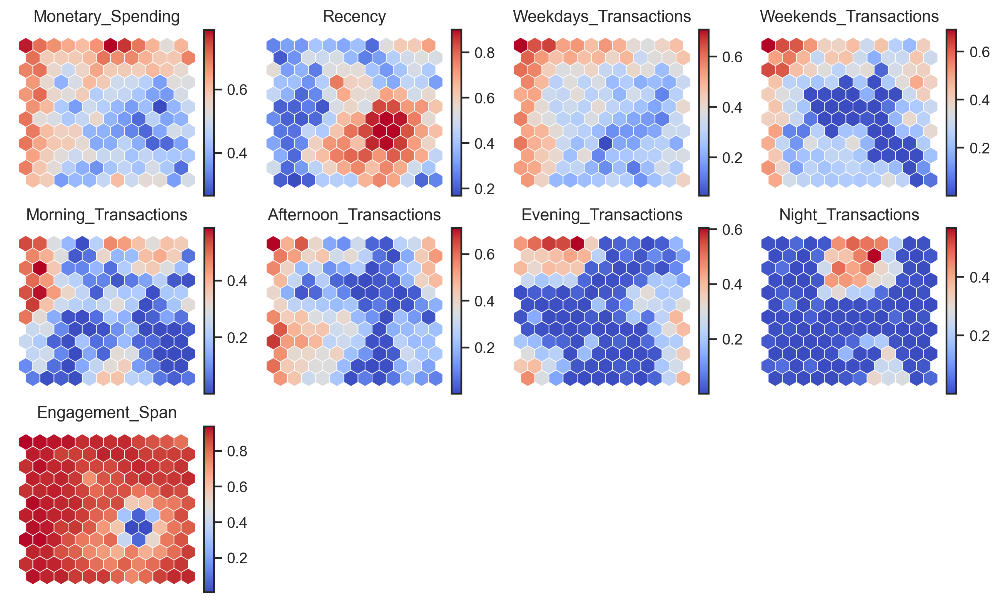

In [122]:
# Plot Component Planes
# Weights are like memory notes for each grid cell (neuron) in the SOM. They store what the neuron has learned about the data
weights = sm.get_weights()
weights.shape
figsize = (10, 6)
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128)

# Create 3x4 grid of subfigures
subfigs = fig.subfigures(3, 4).ravel()

# Loop through each column in ABCDE_VB
for cpi, sf in zip(range(len(ABCDE_VB.columns)), subfigs):
    # Extract the weights for the current component plane
    matrix_vals = weights[:, :, cpi]
    
    # Define color normalization for the current matrix
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    
    # Plot hexagons for the current component
    try:
        plot_hexagons(
            som=sm, 
            sf=sf, 
            colornorm=colornorm, 
            matrix_vals=matrix_vals, 
            label=ABCDE_VB.columns[cpi],  # Use correct column name
            cmap=cm.coolwarm
        )
    except Exception as e:
        print(f"Error plotting component {ABCDE_VB.columns[cpi]}: {e}")


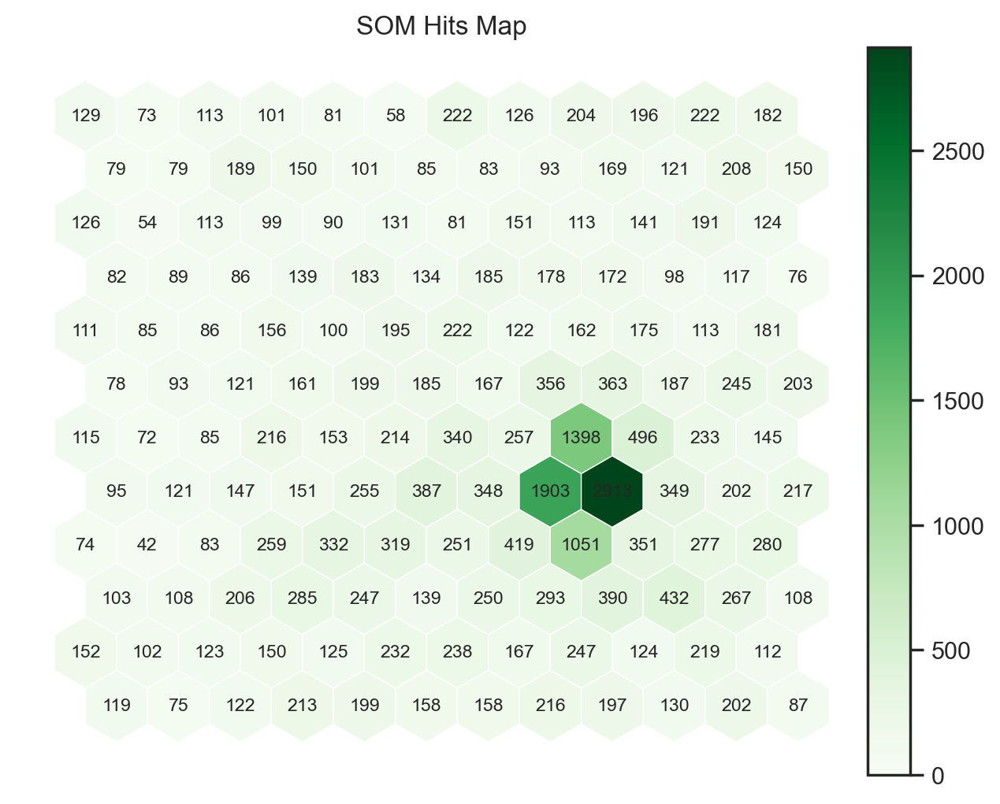

In [124]:
hitsmatrix = sm.activation_response(ABCDE_VB.values)


fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens,
                    annot=True
                    )


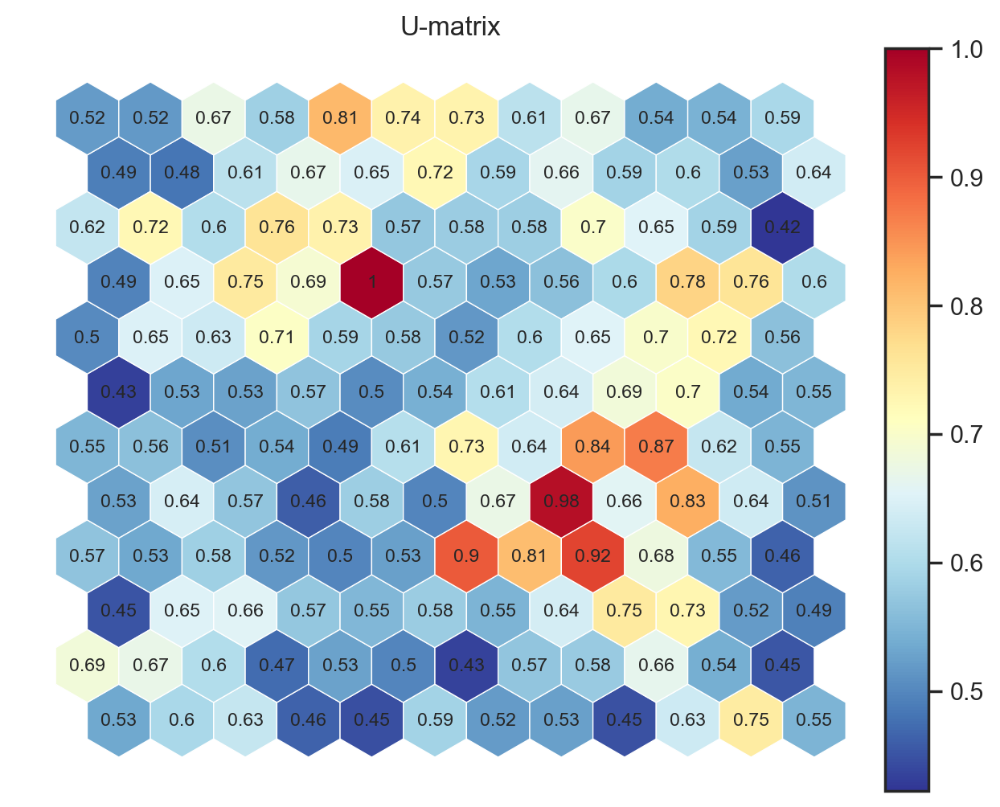

In [125]:
umatrix = sm.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r,
                    annot=True
                    )

#### SOM with Kmeans

Shape of weights: (12, 12, 9)
Number of features in ABCDE_VB: 9
Reshaped weights_flat shape: (144, 9)


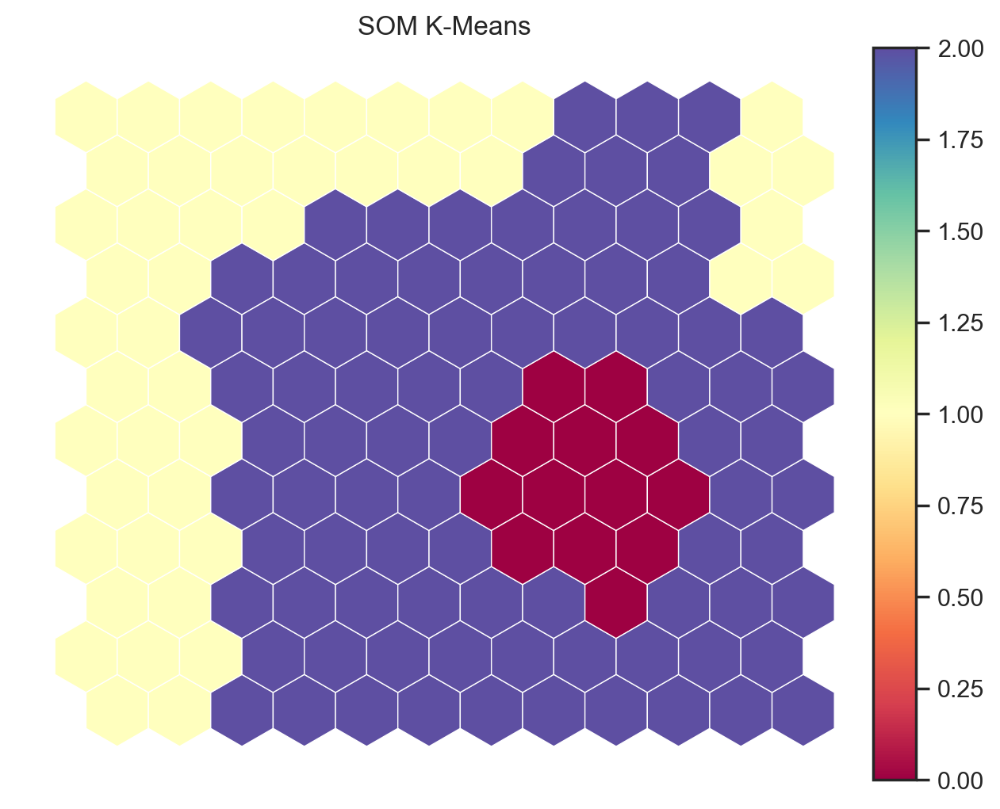

In [126]:
# Get SOM weights
weights = sm.get_weights()

# Debugging: Check the shape of weights and ABCDE_VB
print(f"Shape of weights: {weights.shape}")
print(f"Number of features in ABCDE_VB: {len(ABCDE_VB.columns)}")

# Reshape weights into a flat array for further processing
# Ensure the number of features matches the weights' last dimension
if weights.shape[2] == len(ABCDE_VB.columns):
    weights_flat = weights.reshape((M * N, weights.shape[2]))
    print(f"Reshaped weights_flat shape: {weights_flat.shape}")
else:
    raise ValueError(
        f"Mismatch in features! Weights expect {weights.shape[2]} features, but ABCDE_VB has {len(ABCDE_VB.columns)}."
    )
kmeans = KMeans(n_clusters=3, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights_flat)

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )


#### SOM with Hierarchical clustering - Ward's method

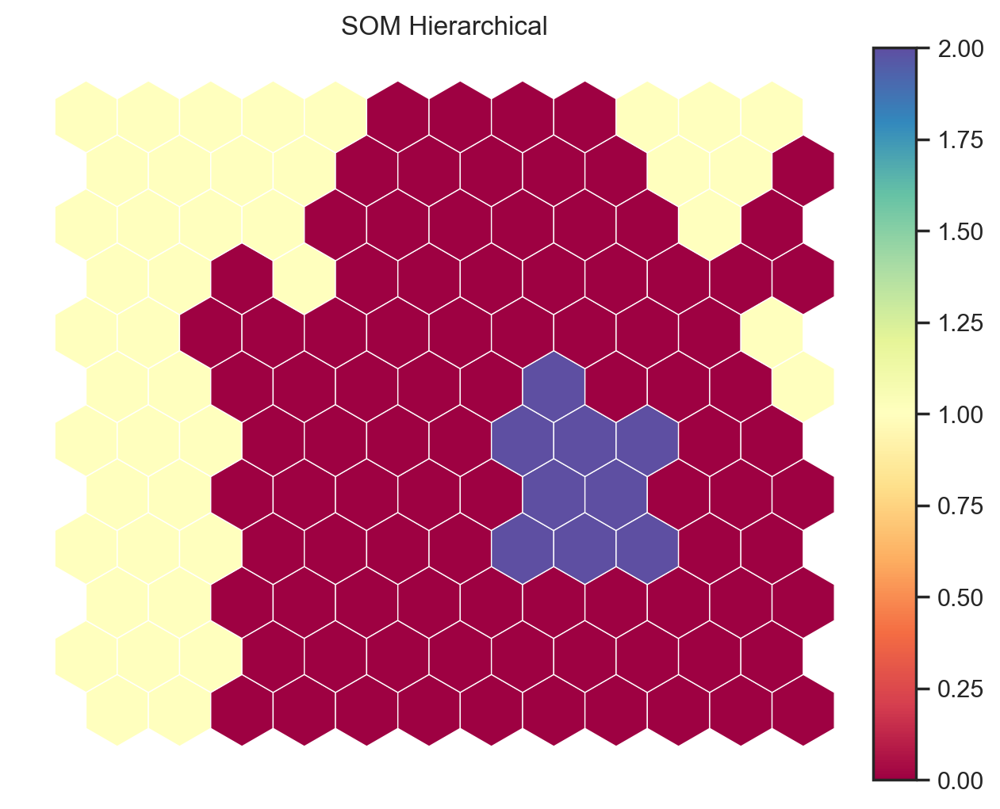

In [127]:
# Perform Hierarchical clustering on top of the MxN units 

hierclust = AgglomerativeClustering(n_clusters=3, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights_flat)
hclust_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

In [128]:
## This gets BMU coordinates, e.g. (4,4) for each data point
bmu_index = np.array([sm.winner(x) for x in ABCDE_VB.values])

print(bmu_index.shape)

bmu_index
## This gets the cluster label from hclust_matrix, i.e.
## if data row 0 has BMU at (37, 28) 
## it will get the label associated to node (37,28) using label associated to hclust_matrix[37,28] above

som_final_labels = [hclust_matrix[i[0]][i[1]] for i in bmu_index] 

ABCDE_VB_SOM_final = pd.concat([
                ABCDE_VB,
                pd.Series(som_final_labels, name='cluster_labels_VB', index=ABCDE_VB.index)
            ], axis=1
            )


(31478, 2)


In [129]:
# Characterizing the final clusters
ABCDE_VB_SOM_final[list(ABCDE_VB.columns) + ['cluster_labels_VB']].groupby('cluster_labels_VB').mean() 

,Monetary_Spending,Recency,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Engagement_Span
cluster_labels_VB,,,,,,,,,
0,0.479050,0.610237,0.287853,0.193155,0.128730,0.191342,0.094978,0.099955,0.805512
1,0.603642,0.428942,0.476674,0.388334,0.297763,0.412374,0.232946,0.026407,0.929958
2,0.361365,0.789300,0.144184,0.071946,0.063458,0.090876,0.038033,0.034116,0.083015


In [130]:
ABCDE_VB_SOM_final['cluster_labels_VB'].value_counts()

cluster_labels_VB
0    17298
2     9144
1     5036
Name: count, dtype: int64

<a class="anchor" id="DBC_VB">

### 5.1.3 Density Based Clustering

</a>

<a class="anchor" id="DBSCAN_VB">

### 5.1.3.1. DBSCAN 

</a>

**Defining  'eps' parameter** <br>

`Step 1` Assess shape of data to understand dimensionality (cols = dim)

In [131]:
ABCDE_VB.shape

(31478, 9)

`Step 2` Plot a k-distance graph to understand the distance of each datapoint to its nearest neighbor (k = min_samples)

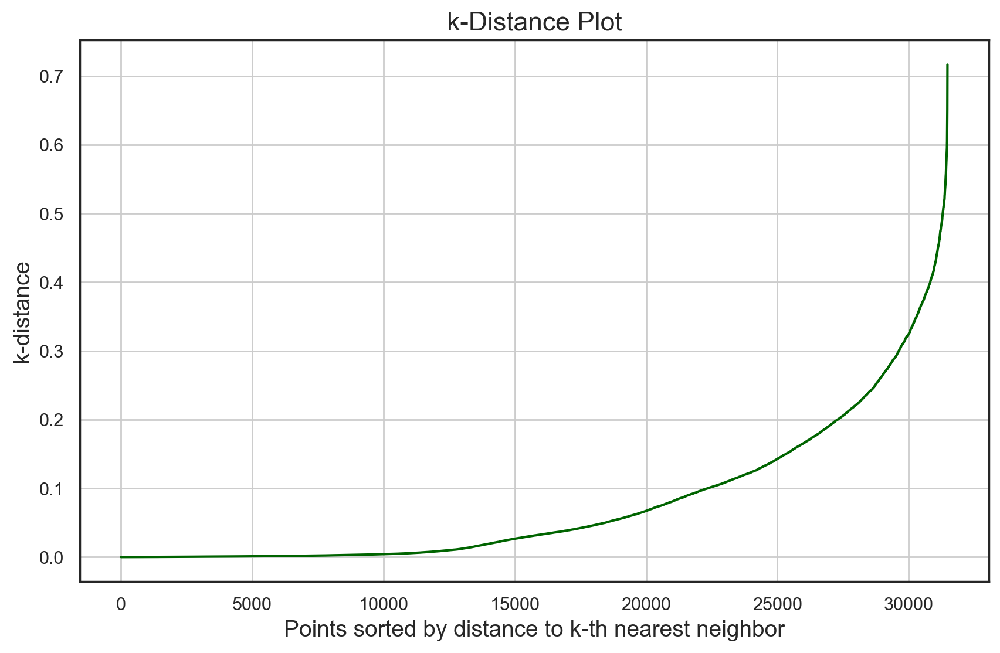

In [132]:
data = ABCDE_PB

# k = 2 x dim - 1
k = 17
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(data)
distances, indices = neighbors_fit.kneighbors(data)

# Sort distances for the k-th nearest neighbor and plot
distances = np.sort(distances[:, k-1], axis=0)
plt.figure(figsize=(10, 6))

# Customize the plot
sns.set_style("white")
plt.grid(True)
plt.plot(distances, color='darkgreen')  # Line in dark green
plt.title("k-Distance Plot", fontsize=16)
plt.xlabel("Points sorted by distance to k-th nearest neighbor", fontsize=14)
plt.ylabel("k-distance", fontsize=14)

# Show the plot
plt.show()


`Step 3` Interpreting results:

Below the elbow point: points in dense regions <br>
Above the elbow point: points in sparse regions <br>

value on y-axis at elbow point: candidate for 'eps'value: **eps = 0.18 to 0.3**

`Step 4` Implementing DBSCAN clustering, with optimal defined eps and min_samples

In [133]:
#PARAMETER TUNING trials
#dbscan = DBSCAN(eps=0.3, min_samples=15) = 2 clusters
#dbscan = DBSCAN(eps=0.25, min_samples=15) = 2 clusters
#dbscan = DBSCAN(eps=0.21, min_samples=17) = 11 clusters
#dbscan = DBSCAN(eps=0.22, min_samples=17) = 3 clusters
#dbscan = DBSCAN(eps=0.215, min_samples=15) = 7 clusters: 0    15742; 5     12239; -1     1420;4    593;3       332;1      297
#dbscan = DBSCAN(eps=0.215, min_samples=80) = 10 clusters
#dbscan = DBSCAN(eps=0.218, min_samples=17) = 4 clusters:  0    29910; -1     1258; 1      301; 2        9
#dbscan = DBSCAN(eps=0.217, min_samples=17) = 6 clusters: 0    17027; 3    12259; -1     1291; 2      593; 1      299; 4       9
#dbscan = DBSCAN(eps=0.225, min_samples=80) = 5 clusters:  0    25067; -1     3602; 2     1800; 3      709; 1      300
#dbscan = DBSCAN(eps=0.217, min_samples=600) = 5 clusters -1    26833; 0     1962; 1     1139; 2      883; 3      661
#dbscan = DBSCAN(eps=0.216, min_samples=17) = 6 clusters: 0    16639; 4    12247; -1     1369; 3      596; 2      330;1      297
dbscan = DBSCAN(eps=0.2175, min_samples=17)
dbscan_labels_vb = dbscan.fit_predict(ABCDE_VB)

#Count number of clusters made
dbscan_n_clusters = len(np.unique(dbscan_labels_vb))
print("Number of estimated clusters : %d" % dbscan_n_clusters)


# Exclude noise points (-1) when counting clusters
unique_labels = set(dbscan_labels_vb) - {-1}
dbscan_n_clusters = len(unique_labels)

print("Number of estimated clusters, excluding noise points: %d" % dbscan_n_clusters)

Number of estimated clusters : 5
Number of estimated clusters, excluding noise points: 4


`Step 5` Assigning cluster labels to new column and updating dataframe

In [134]:
ABCDE_VB_DBSCAN = ABCDE_VB.copy()
ABCDE_VB_DBSCAN['cluster_labels_VB'] = dbscan_labels_vb

In [135]:
ABCDE_VB_DBSCAN['cluster_labels_VB'].value_counts()

cluster_labels_VB
 0    29299
-1     1276
 2      593
 1      301
 3        9
Name: count, dtype: int64

In [136]:
ABCDE_VB_DBSCAN[list(ABCDE_VB.columns) + ['cluster_labels_VB']].groupby('cluster_labels_VB').mean() 

,Monetary_Spending,Recency,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Engagement_Span
cluster_labels_VB,,,,,,,,,
-1,0.617918,0.437953,0.458928,0.390056,0.246874,0.274023,0.252668,0.278299,0.823756
0,0.460718,0.636562,0.276753,0.179471,0.132540,0.200185,0.096866,0.059807,0.625157
1,0.400637,0.802338,0.000000,0.221616,0.002928,0.000000,0.000000,0.214397,0.001532
2,0.368603,0.802604,0.000000,0.217250,0.177683,0.000000,0.000294,0.000000,0.000259
3,0.518674,0.720168,0.451645,0.351233,0.222124,0.293630,0.350657,0.223979,0.876431


 <a class="anchor" id="MSC_VB">
     
### 5.1.3.2. Mean-Shift Clustering

</a>

`Step 1` Defining _bandwith_ parameter, with the help of estimate_bandwith() function, a scikit learn tool 

In [137]:
bandwidth = estimate_bandwidth(ABCDE_VB, 
# TO-DO: manipulate the quantile value such that we obtain a small enough bandwidth
                               quantile=0.2,
                               random_state=1,
                               n_jobs=-1)
bandwidth
#PARAMETER TUNING - quantile
#quantile=0.9-> bandwith 1.17-> 1 cluster
#quantile=0.6-> bandwith 0.85-> 1 cluster
#quantile=0.4-> bandwith 0.72-> 1 cluster
#quantile=0.3-> bandwith 0.64-> 1 cluster
#quantile=0.2-> bandwith 0.54-> 2 clusters'''

0.5479535362295274

`Step 2` Perform Mean-Shift Clustering

In [139]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth
#all quantile tuning led to 1 cluster - even tuning the bandwith directly all the way down to 0.05 led to 1 cluster solution
ms = MeanShift(bandwidth=bandwidth)
ms.fit(ABCDE_VB)

#Extract centroids and labels
ms_labels = ms.labels_
cluster_centers = ms.cluster_centers_


#Number of clusters
ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 2


`Step 3` Assigning cluster labels to new column and updating dataframe

In [140]:
ABCDE_VB_MSHIFT = ABCDE_VB.copy()
ABCDE_VB_MSHIFT['cluster_labels_VB'] = ms_labels

In [141]:
ABCDE_VB_MSHIFT[list(ABCDE_VB.columns) + ['cluster_labels_VB']].groupby('cluster_labels_VB').mean() 

,Monetary_Spending,Recency,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Engagement_Span
cluster_labels_VB,,,,,,,,,
0,0.505850,0.574835,0.329938,0.233163,0.167819,0.240111,0.124035,0.082042,0.830067
1,0.358162,0.784977,0.137074,0.074903,0.056270,0.086889,0.039398,0.035350,0.058324


<a class="anchor" id="GMM_VB"></a>
### 5.1.3.3. Gaussian Mixture Model 

`Step 1` defining _n_component_ parameter, introducing Akaike Information Criterion (AIC) and Bayesian Information Criterion (BIC).

**AIC**: estimates the relative amount of information lost by a model used to represent the data-generation process. The smaller the better. <br>
**BIC**: similar to AIC but penalizes more complex models (i.e. favors simpler models). The smaller the better.

In [142]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(ABCDE_VB)
          for n in n_components]

bic_values = [m.bic(ABCDE_VB) for m in models]
aic_values = [m.aic(ABCDE_VB) for m in models]

`Step 2` Plot scores and interpret results with elbow method

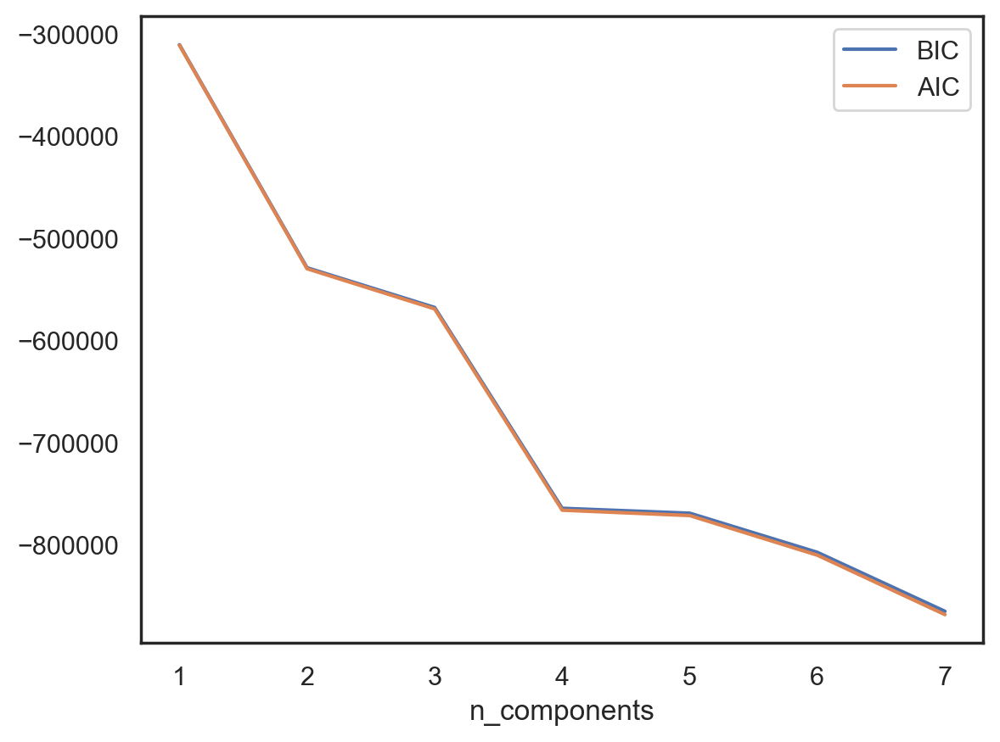

In [143]:
#Plot AIC/BIC scores
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

`Step 3` Perform Gaussian Mixture Model Clustering, on optimal parameters

In [144]:
# Performing GMM clustering

gmm = GaussianMixture(n_components=4, 
                      covariance_type='full', 
                      n_init=10, 
                      init_params='kmeans', 
                      random_state=1)

gmm_labels = gmm.fit_predict(ABCDE_VB)
labels_proba = gmm.predict_proba(ABCDE_VB)

**Understanding the estimated parameters:**

`Weights`: represent the proportion of data points that belong to each Gaussian component. larger weight <> larger cluster

In [145]:
# The estimated component weights
gmm.weights_

array([0.21694497, 0.040631  , 0.21818437, 0.52423966])

`Means`: Centroid of each cluster - represents where most datapoints in each cluster are located, thus helping to interpret what distinguishes each cluster

In [146]:
# The estimated mean vectors of the Components
print(gmm.means_.shape)
gmm.means_

(4, 9)


array([[0.34289989, 0.78082741, 0.11689269, 0.06319199, 0.04636395,
        0.0759392 , 0.03295332, 0.02864079, 0.        ],
       [0.5695945 , 0.50597513, 0.42228627, 0.3359637 , 0.17545949,
        0.22422391, 0.28447566, 0.30723312, 0.87035923],
       [0.53142951, 0.61930648, 0.26919575, 0.20373601, 0.18051135,
        0.11902007, 0.        , 0.23084121, 0.69450428],
       [0.47938667, 0.58784308, 0.33396136, 0.22386554, 0.15305875,
        0.27843394, 0.15603728, 0.        , 0.81766152]])

`Covariance`: Describes the shape and modelling of each cluster, while also explaining the variability of features within a cluster

In [147]:
# The estimated covariance matrices of the Components
gmm.covariances_.shape

(4, 9, 9)

`Step 4` Assigning cluster labels to new column and updating dataframe

In [148]:
ABCDE_VB_GMM = ABCDE_VB.copy()
ABCDE_VB_GMM['cluster_labels_VB'] = gmm_labels

In [149]:
ABCDE_VB_GMM['cluster_labels_VB'].value_counts()

cluster_labels_VB
3    16776
0     6829
2     6597
1     1276
Name: count, dtype: int64

<a class="anchor" id="compa"></a>
### 5.1.4. Comparing Models - Behaviour Perspective 

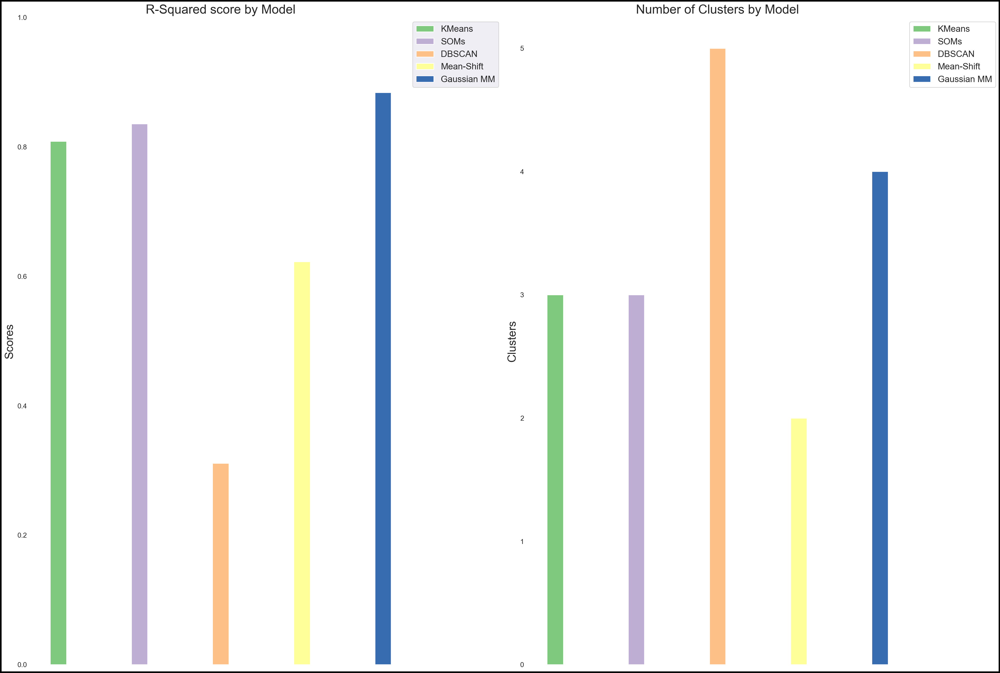

In [150]:
Behavioral_models = {
    "KMeans": ABCDE_VB_KM,
    "SOMs": ABCDE_VB_SOM_final,
    "DBSCAN": ABCDE_VB_DBSCAN,
    "Mean-Shift": ABCDE_VB_MSHIFT,
    "Gaussian MM": ABCDE_VB_GMM

}
compare_models(Behavioral_models, cluster_column="cluster_labels_VB")

<a class="anchor" id="pb"></a>
## 5.2. Perspective-Based Segmentation 

<a class="anchor" id="km2"></a>
### 5.2.1 K-means and Hierarchical clustering 

**Finding the optimal clusterer on Behavioral variables using Elbow Hierarchical Method:**

In [649]:
ABCDE_PB.columns

Index(['CUI_American', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_OTHER',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks'],
      dtype='object')

In [ ]:
##########################################
# THIS TAKES A FEW MINUTES TO RUN!!
##########################################
feats_PB = ['CUI_American', 'CUI_Healthy', 'CUI_Indian', 'CUI_Italian',
        'CUI_OTHER', 'CUI_Asian_Fusion',
       'CUI_Sweets_and_Beverages', 'CUI_Snacks']
# Assuming ABCDE_PB is the DataFrame and feats_PB is the list of features
r2_scores_PB = {}

# Get KMeans R² scores
r2_scores_PB['kmeans'] = get_r2_scores(ABCDE_PB, feats_PB, kmeans)

# Get R² scores for hierarchical clustering methods+3210

for link in hc_methods:
    hierarchical = AgglomerativeClustering(linkage=link, metric='euclidean')
    r2_scores_PB[link] = get_r2_scores(ABCDE_PB, feats_PB, hierarchical)

In [128]:
r2_hc_PB = pd.DataFrame(r2_scores_PB)

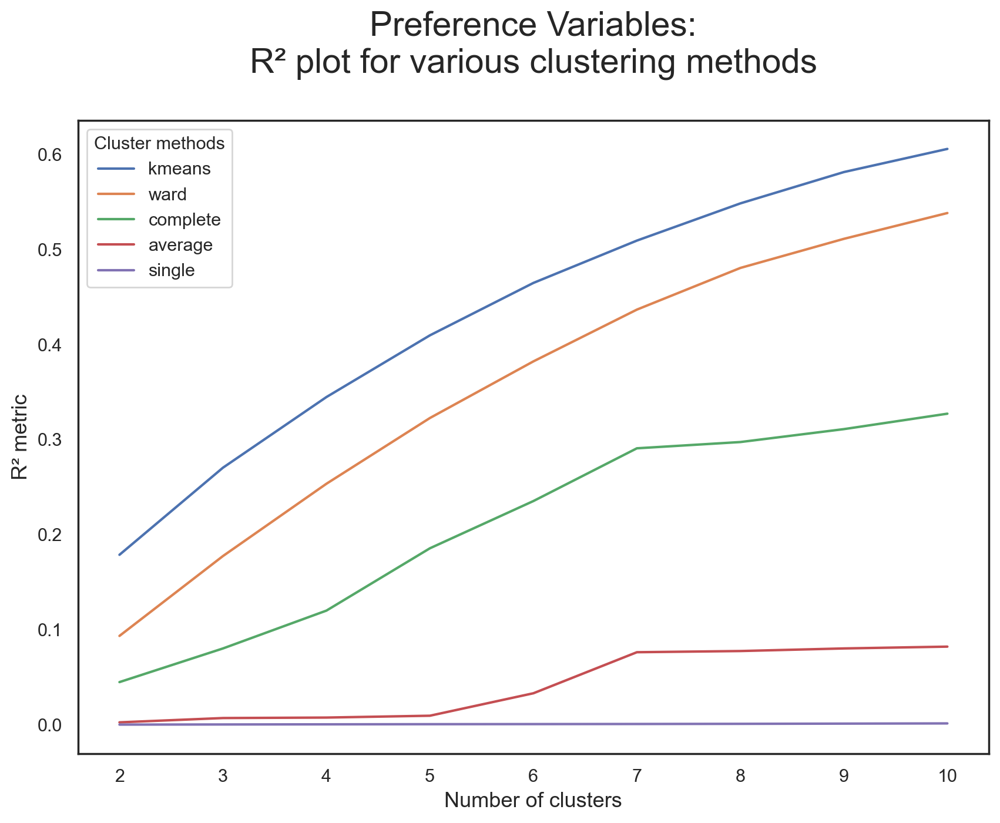

In [129]:
# Visualizing the R² scores for each cluster solution on demographic variables
r2_hc_PB.plot.line(figsize=(10,7))

sns.set_style("white")
plt.title("Preference Variables:\nR² plot for various clustering methods\n", fontsize=21)
plt.legend(title="Cluster methods", title_fontsize=11)
plt.xlabel("Number of clusters", fontsize=13)
plt.ylabel("R² metric", fontsize=13)
plt.show()

**Finding the optimal clusterer on Behavioral variables using Inertia and Silohette:**

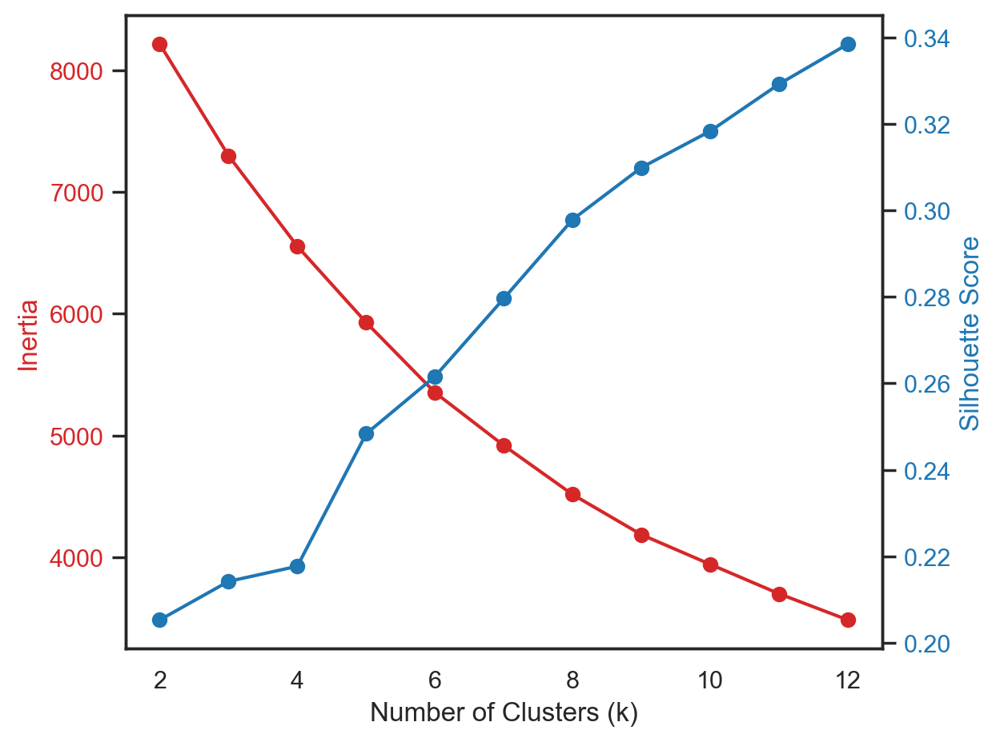

In [130]:
inertia_and_silhouette_plots(ABCDE_PB,2,12)

**K-Means with 6 Clusters seems like the best option**

In [229]:
# Creating a copy of the financial dataframe for K-Means clustering
ABCDE_PB_KM = ABCDE_PB.copy()

# Applying K-Means clustering with 6 clusters
kmeans_model = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
ABCDE_PB_KM['cluster_labels_PB'] = kmeans_model.fit_predict(ABCDE_PB)

# Calculating the mean values for each cluster
cluster_means = ABCDE_PB_KM.groupby('cluster_labels_PB').mean()

In [230]:
cluster_means


,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
cluster_labels_PB,,,,,,,,
0,0.127481,0.035933,0.077259,0.105923,0.487595,0.228905,0.077191,0.066132
1,0.111149,0.036284,0.024133,0.027386,0.050297,0.277448,0.518022,0.053987
2,0.504004,0.024540,0.032478,0.079939,0.026402,0.220292,0.032131,0.027034
3,0.025275,0.024602,0.023631,0.022263,0.012548,0.495369,0.011868,0.011563
4,0.046762,0.049330,0.148503,0.340239,0.019370,0.055191,0.016192,0.021535
5,0.120409,0.019001,0.019266,0.012079,0.024400,0.297145,0.100554,0.537044


<a class="anchor" id="som2"></a>
### 5.2.2 Self-organizing Maps (SOM)

#### SOM: Labels based on BMUs' U-matrix values

In [131]:
ABCDE_PB_SOM = ABCDE_PB.to_numpy()  # Normalize data
n_feats_PB = ABCDE_PB_SOM.shape[1]

M = 12  # Map height
N = 12  # Map width
learning_rate_initial = 0.5
neighborhood_function = "gaussian"
topology = "hexagonal"

# Initialize SOM
sm_pb = MiniSom(M, N, 
                n_feats_PB, 
                learning_rate=learning_rate_initial, 
                topology=topology, 
                neighborhood_function=neighborhood_function, 
                activation_distance='euclidean', 
                random_seed=42)

# Initializes the weights of the SOM picking random samples from data.
sm_pb.random_weights_init(ABCDE_PB_SOM) 

# Quantization and topographic errors before training
print("Before training:")
print("QE:", np.round(sm_pb.quantization_error(ABCDE_PB_SOM), 4))
print("TE:", np.round(sm_pb.topographic_error(ABCDE_PB_SOM), 4))

# Trains the SOM using all the vectors in data sequentially
# Use the correct instance variable `sm_pb` for training
sm_pb.train_batch(ABCDE_PB_SOM, 20000)

# Quantization and topographic errors after training
print("After training:")
print("QE:", np.round(sm_pb.quantization_error(ABCDE_PB_SOM), 4))
print("TE:", np.round(sm_pb.topographic_error(ABCDE_PB_SOM), 4))



Before training:
QE: 0.1774
TE: 0.9789
After training:
QE: 0.1367
TE: 0.2764


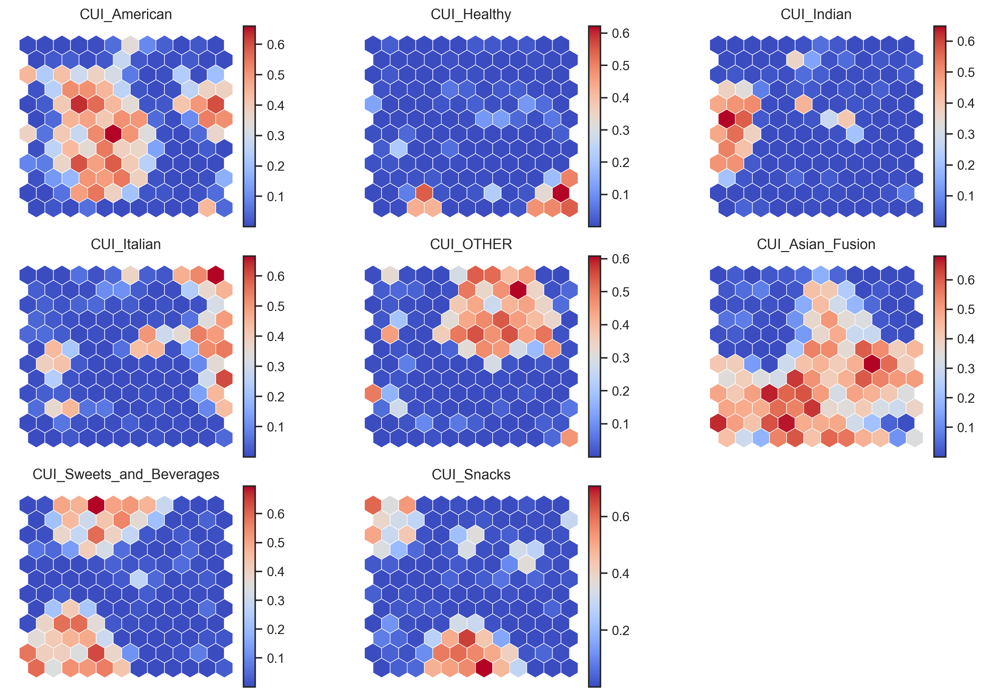

In [132]:
# Extract the weights matrix 
weights = sm_pb.get_weights()

# Plot Component Planes
figsize = (12, 8)  # Adjust size to fit 9 subfigures
fig = plt.figure(figsize=figsize, constrained_layout=True, dpi=128)

# Create 3x3 grid of subfigures 
subfigs = fig.subfigures(3, 3).ravel()  


# Loop through each column in ABCDE_PB 
for cpi, sf in zip(range(len(ABCDE_PB.columns)), subfigs):
    # Extract the weights for the current component plane
    matrix_vals = weights[:, :, cpi]
    
    # Define color normalization for the current matrix
    colornorm = mpl_colors.Normalize(vmin=np.min(matrix_vals), vmax=np.max(matrix_vals))
    
    # Plot hexagons for the current component
    try:
        plot_hexagons(
            som=sm_pb, 
            sf=sf, 
            colornorm=colornorm, 
            matrix_vals=matrix_vals, 
            label=ABCDE_PB.columns[cpi],  
            cmap=cm.coolwarm
        )
    except Exception as e:
        print(f"Error plotting component {ABCDE_PB.columns[cpi]}: {e}")

plt.show()


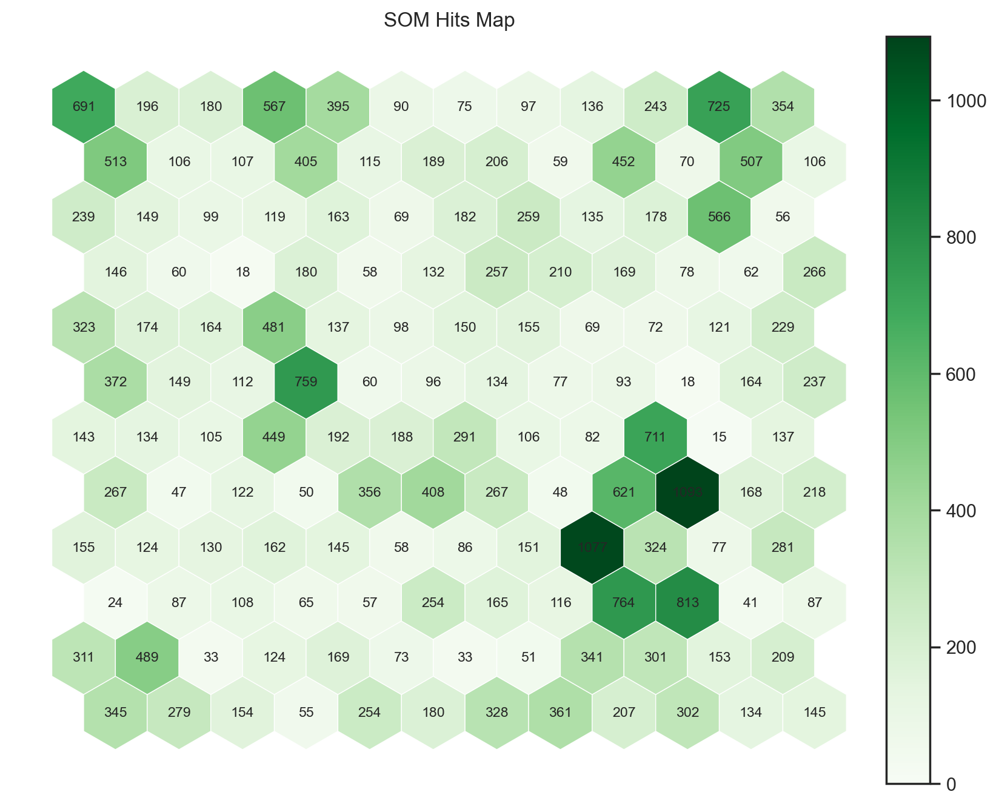

In [133]:
hitsmatrix = sm_pb.activation_response(ABCDE_PB.values)


fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hitsmatrix))

fig = plot_hexagons(sm_pb, fig, 
                    colornorm,
                    hitsmatrix,
                    label="SOM Hits Map",
                    cmap=cm.Greens,
                    annot=True
                    )


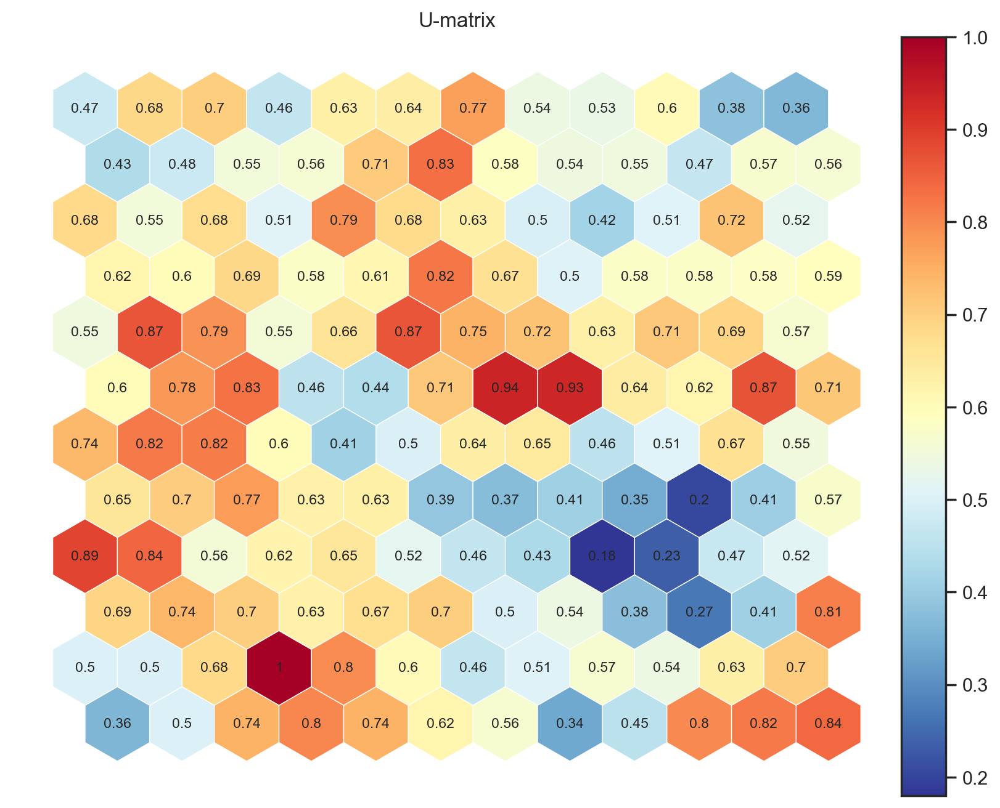

In [134]:
umatrix = sm_pb.distance_map(scaling='mean')
fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=np.min(umatrix), vmax=np.max(umatrix))

fig = plot_hexagons(sm_pb, fig, 
                    colornorm,
                    umatrix,
                    label="U-matrix",
                    cmap=cm.RdYlBu_r,
                    annot=True
                    )

#### SOM with Kmeans

Shape of weights: (12, 12, 8)
Number of features in ABCDE_VB: 8
Reshaped weights_flat shape: (144, 8)


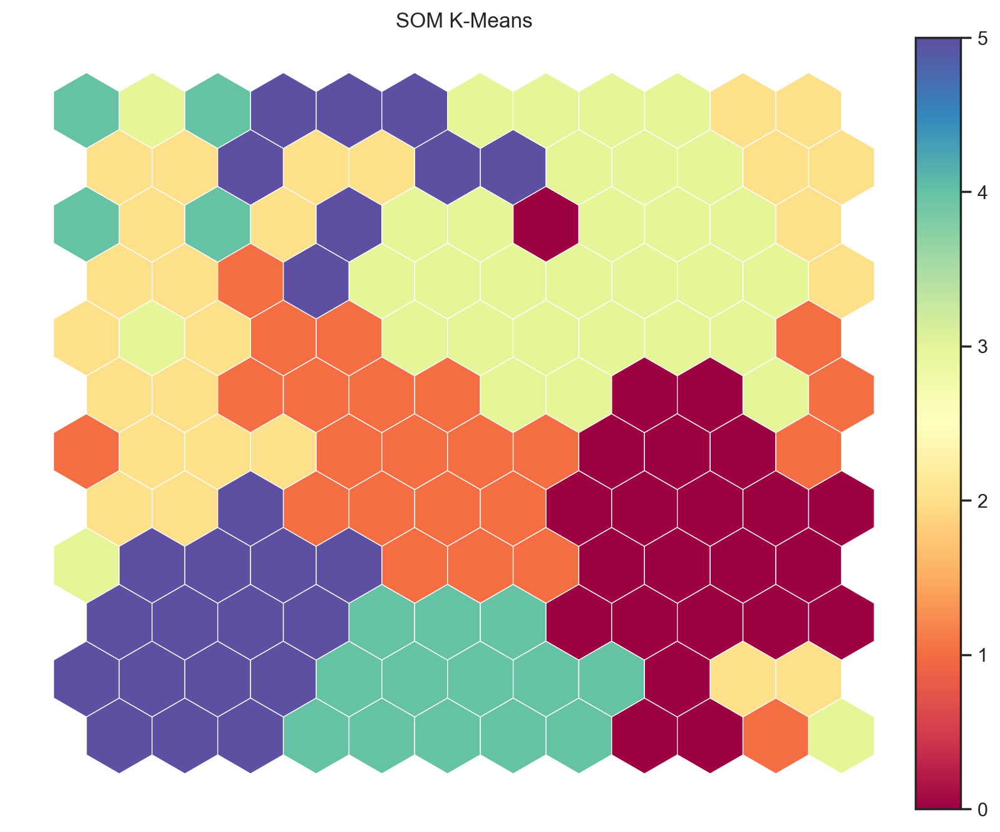

In [135]:
# Get SOM weights
weights = sm_pb.get_weights()

# Debugging: Check the shape of weights and ABCDE_VB
print(f"Shape of weights: {weights.shape}")
print(f"Number of features in ABCDE_VB: {len(ABCDE_PB.columns)}")

# Reshape weights into a flat array for further processing
# Ensure the number of features matches the weights' last dimension
if weights.shape[2] == len(ABCDE_PB.columns):
    weights_flat = weights.reshape((M * N, weights.shape[2]))
    print(f"Reshaped weights_flat shape: {weights_flat.shape}")
else:
    raise ValueError(
        f"Mismatch in features! Weights expect {weights.shape[2]} features, but ABCDE_VB has {len(ABCDE_PB.columns)}."
    )
kmeans = KMeans(n_clusters=6, init='k-means++', n_init=20, random_state=42)
nodeclus_labels = kmeans.fit_predict(weights_flat)

kmeans_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(kmeans_matrix))

fig = plot_hexagons(sm_pb, fig, 
                    colornorm,
                    kmeans_matrix,
                    label="SOM K-Means",
                    cmap=cm.Spectral,
                    )


#### SOM with Hierarchical clustering - Ward's method

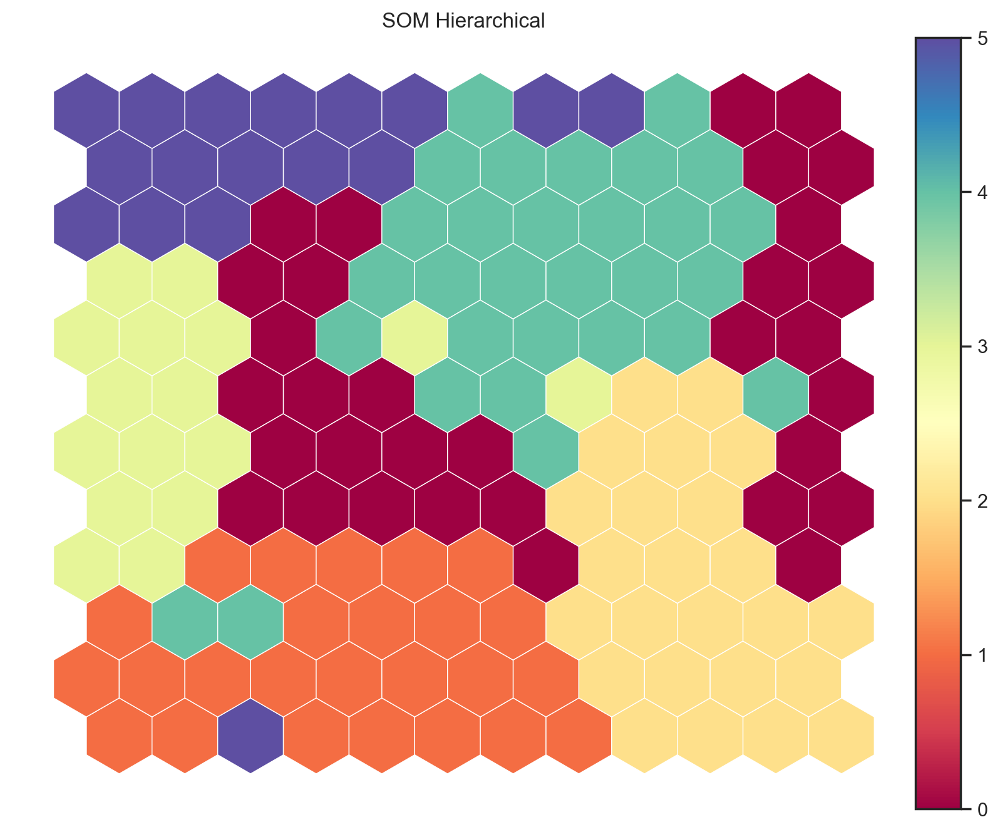

In [136]:
# Perform Hierarchical clustering on top of the MxN units 

hierclust = AgglomerativeClustering(n_clusters=6, linkage='ward')
nodeclus_labels = hierclust.fit_predict(weights_flat)
hclust_matrix = nodeclus_labels.reshape((M,N))

fig = plt.figure(figsize=figsize)

colornorm = mpl_colors.Normalize(vmin=0, vmax=np.max(hclust_matrix))

fig = plot_hexagons(sm_pb, fig, 
                    colornorm,
                    hclust_matrix,
                    label="SOM Hierarchical",
                    cmap=cm.Spectral,
                    )

In [137]:
## This gets BMU coordinates, e.g. (4,4) for each data point
bmu_index = np.array([sm_pb.winner(x) for x in ABCDE_PB.values])

print(bmu_index.shape)

bmu_index
## This gets the cluster label from hclust_matrix, i.e.
## if data row 0 has BMU at (37, 28) 
## it will get the label associated to node (37,28) using label associated to hclust_matrix[37,28] above

som_final_labels_pb = [hclust_matrix[i[0]][i[1]] for i in bmu_index] 

ABCDE_PB_SOM_final = pd.concat([
                ABCDE_PB,
                pd.Series(som_final_labels_pb, name='cluster_labels_PB', index=ABCDE_PB.index)
            ], axis=1
            )


(31478, 2)


In [138]:
# Characterizing the final clusters
ABCDE_PB_SOM_final[list(ABCDE_PB.columns) + ['cluster_labels_PB']].groupby('cluster_labels_PB').mean() 

,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
cluster_labels_PB,,,,,,,,
0,0.325853,0.003462,0.002413,0.222240,0.014037,0.187163,0.040564,0.010938
1,0.178261,0.035730,0.006736,0.008947,0.010779,0.538917,0.335486,0.292933
2,0.013315,0.070411,0.005742,0.012220,0.017506,0.442718,0.004450,0.034172
3,0.122289,0.024654,0.513299,0.106814,0.121142,0.185778,0.045460,0.058882
4,0.152251,0.016119,0.025185,0.120960,0.450026,0.275794,0.113186,0.071280
5,0.052284,0.024338,0.015406,0.012586,0.054042,0.015148,0.273569,0.255638


 <a class="anchor" id="DBC"></a>
### 5.2.3. Density-Based Clustering

<a class="anchor" id="DBSCAN2"></a>
### 5.2.3.1. DBSCAN 

**Defining  'eps' parameter** <br>

`Step 1` Assess shape of data to understand dimensionality (cols = dim)

In [161]:
ABCDE_PB.shape

(31478, 8)

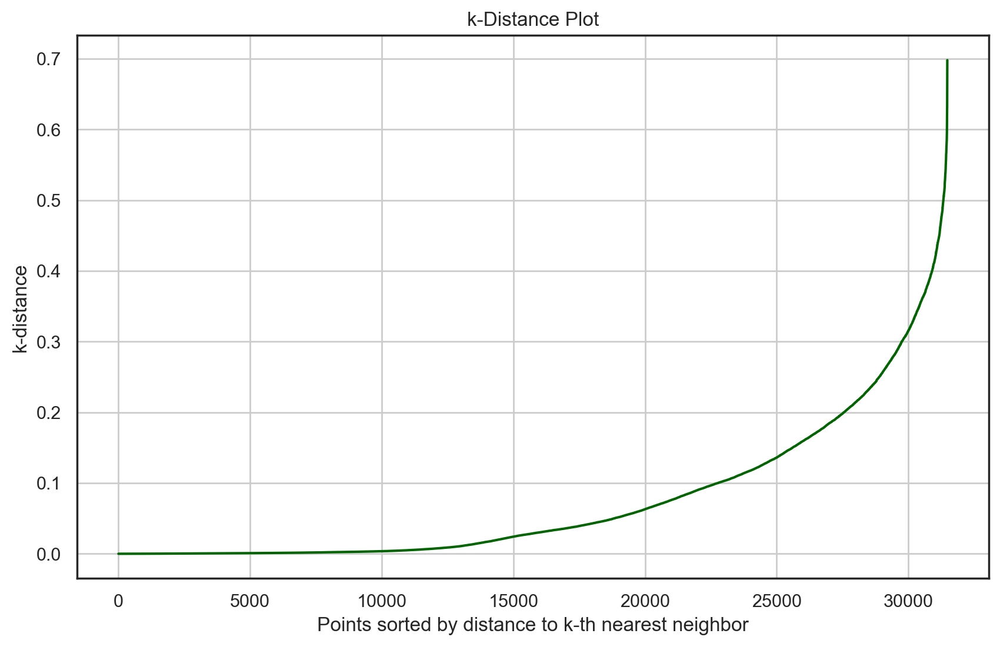

In [162]:
data = ABCDE_PB

# k = 2 x dim - 1
k=15
neighbors = NearestNeighbors(n_neighbors=k)
neighbors_fit = neighbors.fit(data)
distances, indices = neighbors_fit.kneighbors(data)

# Sort distances for the k-th nearest neighbor and plot
distances = np.sort(distances[:, k-1], axis=0)
plt.figure(figsize=(10, 6))
plt.plot(distances, color='darkgreen')
plt.title("k-Distance Plot")
plt.xlabel("Points sorted by distance to k-th nearest neighbor")
plt.ylabel("k-distance")
plt.grid()
plt.show()

`Step 3` Interpreting results:

Below the elbow point: points in dense regions <br>
Above the elbow point: points in sparse regions <br>

value on y-axis at elbow point: candidate for 'eps'value: **eps = 0.15 to 0.3**

In [163]:
#PARAMETER TUNING
#dbscan = DBSCAN(eps=0.29, min_samples=15) = 6 clusters
#dbscan = DBSCAN(eps=0.31, min_samples=15) = 6 clusters: 0    30754;-1      655;1       20;2       20;3       15; 4     14
#dbscan = DBSCAN(eps=0.31, min_samples=100) = 2 clusters
#dbscan = DBSCAN(eps=0.2, min_samples=15) = 9
#dbscan = DBSCAN(eps=0.2, min_samples=30) = 5 clusters:  0    27614;-1     3458;2      243;3       99;1       64
#dbscan = DBSCAN(eps=0.2, min_samples=100) = 2 clusters
#dbscan = DBSCAN(eps=0.22, min_samples=75) = 3 clusters:0    26919; -1     4435;1      124
#dbscan = DBSCAN(eps=0.22, min_samples=15 = 6 clusters: 0    29313; -1     2067; 1       41;3       21;2       20;4       16
#dbscan = DBSCAN(eps=0.3, min_samples=15) = 5 clusters:  0    30659;-1      770; 1       20;3         15; 2       14
#dbscan = DBSCAN(eps=0.3, min_samples=16) = 4 clusters:  0    30630;-1      815; 2       19;1       14
#dbscan = DBSCAN(eps=0.26, min_samples=15) = 6 clusters: 0    30045; -1     1363; 1       24;3       21;4       13;2       12
#dbscan = DBSCAN(eps=0.2, min_samples=30) = 5 clusters: 0    27614; -1     3458; 2       243;3       99;1       64
#dbscan = DBSCAN(eps=0.18, min_samples=15) = 10:  0    27721; -1     3139; 3      273; 1      128;2       84;5       50;8       27;4       22;7       18;6       16
#dbscan = DBSCAN(eps=0.18, min_samples=30) = 10: 0    26737; -1     4274; 3      165; 2      68;1       53;7       41;5       41;6       36;4       31;8       23
dbscan = DBSCAN(eps=0.19, min_samples=30)
dbscan_labels_pb = dbscan.fit_predict(ABCDE_PB)

#Count number of clusters made
dbscan_n_clusters = len(np.unique(dbscan_labels_pb))
print("Number of estimated clusters : %d" % dbscan_n_clusters)


# Exclude noise points (-1) when counting clusters
unique_labels = set(dbscan_labels_pb) - {-1}
dbscan_n_clusters = len(unique_labels)

print("Number of estimated clusters, excluding noise points: %d" % dbscan_n_clusters)

Number of estimated clusters : 8
Number of estimated clusters, excluding noise points: 7


In [164]:
ABCDE_PB_DBSCAN = ABCDE_PB.copy()
ABCDE_PB_DBSCAN['cluster_labels_PB'] = dbscan_labels_pb

In [165]:
ABCDE_PB_DBSCAN['cluster_labels_PB'].value_counts()

cluster_labels_PB
 0    27176
-1     3879
 1      206
 2       67
 5       46
 4       46
 3       34
 6       24
Name: count, dtype: int64

In [166]:
ABCDE_PB_DBSCAN[list(ABCDE_PB.columns) + ['cluster_labels_PB']].groupby('cluster_labels_PB').mean() 

,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
cluster_labels_PB,,,,,,,,
-1,0.273581,0.140835,0.178621,0.198065,0.282023,0.360127,0.244669,0.186347
0,0.126584,0.014434,0.032734,0.073076,0.068438,0.274726,0.092274,0.085385
1,0.487327,0.000000,0.000000,0.000000,0.000000,0.608338,0.509338,0.550441
2,0.445930,0.000000,0.000000,0.480298,0.504097,0.476668,0.000000,0.000000
3,0.382317,0.000000,0.000000,0.001580,0.000000,0.003439,0.393144,0.408055
4,0.388445,0.000000,0.000000,0.002368,0.426866,0.468025,0.484634,0.000000
5,0.443841,0.435449,0.000000,0.000000,0.000000,0.493117,0.003719,0.000000
6,0.000000,0.461951,0.006114,0.000000,0.428050,0.000000,0.000000,0.000000


<a class="anchor" id="MSC"></a>
### 5.2.3.2. Mean-Shift Clustering 

`Step 1` Defining _bandwith_ parameter

In [167]:
# Based on distance to nearest neighbors for all observations

bandwidth = estimate_bandwidth(ABCDE_PB, 
# TO-DO: manipulate the quantile value such that we obtain a small enough bandwidth
                               quantile=0.55,
                               random_state=1,
                               n_jobs=-1)
bandwidth

#PARAMETER TUNING - quantile
#quantile=0.6-> bandwith 0.80->  cluster 1
#quantile=0.55-> bandwith ->  cluster 
#quantile=0.4-> bandwith 0.70->  cluster 2
#quantile=0.2-> bandwith 0.57->  cluster 2'''

0.7844586775786233

`Step 2` Perform Mean-Shift Clustering

In [186]:
# Perform mean-shift clustering with bandwidth set using estimate_bandwidth

ms = MeanShift(bandwidth=bandwidth)
ms.fit(ABCDE_PB)

#Extract centroids and labels
ms_labels_vb = ms.labels_
cluster_centers = ms.cluster_centers_


#Number of clusters
ms_n_clusters = len(np.unique(ms_labels))
print("Number of estimated clusters : %d" % ms_n_clusters)

Number of estimated clusters : 2


`Step 3` Assigning cluster labels to new column and updating dataframe

In [168]:
ABCDE_PB_MSHIFT = ABCDE_PB.copy()
ABCDE_PB_MSHIFT['cluster_labels_PB'] = ms_labels

In [169]:
ABCDE_PB_MSHIFT[list(ABCDE_PB.columns) + ['cluster_labels_PB']].groupby('cluster_labels_PB').mean() 

,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
cluster_labels_PB,,,,,,,,
0,0.179191,0.037766,0.058509,0.104883,0.116636,0.332052,0.135527,0.116691
1,0.069733,0.012725,0.028893,0.046032,0.041899,0.173438,0.059108,0.059244


 <a class="anchor" id="GMM">
     
### 5.3.2.3. Gaussian Mixture Model
</a>

`Step 1` defining _n_component_ parameter, introducing Akaike Information Criterion (AIC) and Bayesian Information Criterion (BIC).

**AIC**: estimates the relative amount of information lost by a model used to represent the data-generation process. The smaller the better. <br>
**BIC**: similar to AIC but penalizes more complex models (i.e. favors simpler models). The smaller the better.

In [170]:
# Selecting number of components based on AIC and BIC
n_components = np.arange(1, 8)
models = [GaussianMixture(n, covariance_type='full', n_init=10, random_state=1).fit(ABCDE_PB)
          for n in n_components]

bic_values = [m.bic(ABCDE_PB) for m in models]
aic_values = [m.aic(ABCDE_PB) for m in models]

`Step 2` Plot scores and interpret results with elbow method

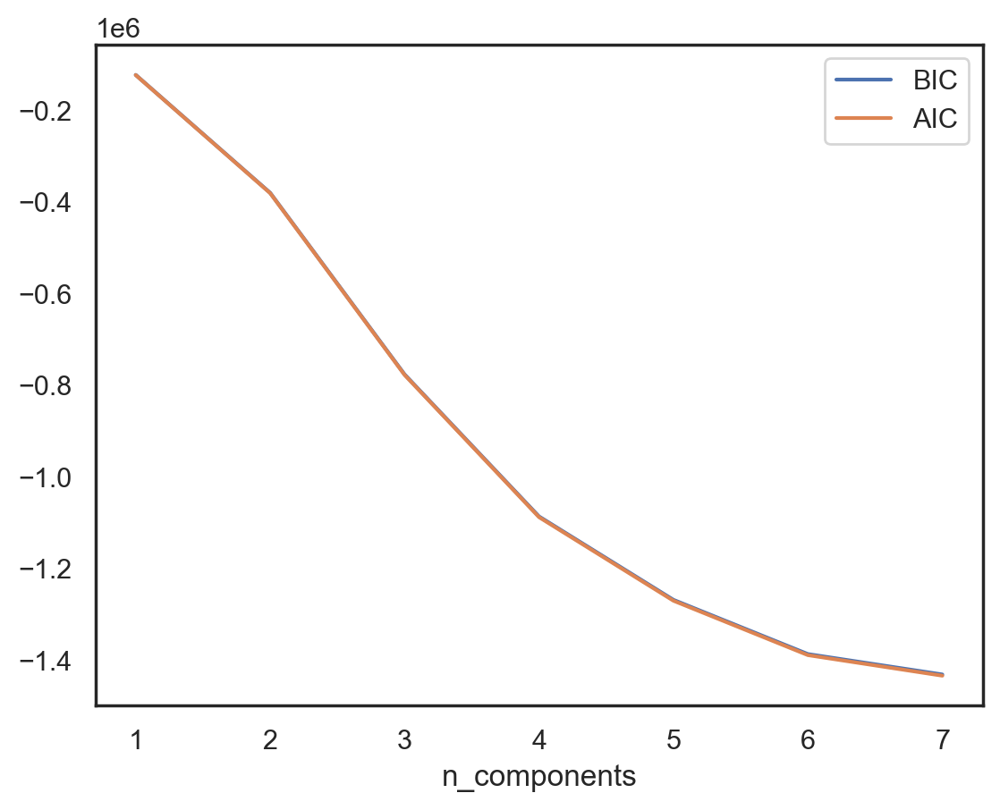

In [171]:
#Plot AIC/BIC scores
plt.plot(n_components, bic_values, label='BIC')
plt.plot(n_components, aic_values, label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components')
plt.xticks(n_components)
plt.show()

`Step 3` Perform Gaussian Mixture Model Clustering, on optimal parameters

In [172]:
# Performing GMM clustering

gmm = GaussianMixture(n_components=5, 
                      covariance_type='full', 
                      n_init=10, 
                      init_params='kmeans', 
                      random_state=1)

gmm_labels = gmm.fit_predict(ABCDE_PB)
labels_proba = gmm.predict_proba(ABCDE_PB)

**Understanding the estimated parameters:**

`Weights`: represent the proportion of data points that belong to each Gaussian component. larger weight <> larger cluster

In [173]:
# The estimated component weights
gmm.weights_

array([0.15847034, 0.078584  , 0.11481072, 0.38727259, 0.26086235])

`Means`: Centroid of each cluster - represents where most datapoints in each cluster are located, thus helping to interpret what distinguishes each cluster

In [174]:
# The estimated mean vectors of the Components
print(gmm.means_.shape)
gmm.means_

(5, 8)


array([[0.13208386, 0.05777818, 0.        , 0.12749006, 0.39434612,
        0.22977316, 0.13382723, 0.        ],
       [0.11133764, 0.18955538, 0.3299261 , 0.09356742, 0.        ,
        0.19291779, 0.        , 0.        ],
       [0.17047748, 0.05881951, 0.21208649, 0.11597623, 0.29064633,
        0.27999854, 0.16214167, 0.25666158],
       [0.17071995, 0.        , 0.        , 0.12304584, 0.        ,
        0.33655514, 0.        , 0.        ],
       [0.12802201, 0.        , 0.        , 0.        , 0.        ,
        0.28330631, 0.28544368, 0.27315044]])

`Covariance`: Describes the shape and modelling of each cluster, while also explaining the variability of features within a cluster

In [175]:
# The estimated covariance matrices of the Components
gmm.covariances_.shape

(5, 8, 8)

`Step 4` Assigning cluster labels to new column and updating dataframe

In [176]:
ABCDE_PB_GMM = ABCDE_PB.copy()
ABCDE_PB_GMM['cluster_labels_PB'] = gmm_labels

In [177]:
ABCDE_PB_GMM[list(ABCDE_PB.columns) + ['cluster_labels_PB']].groupby('cluster_labels_PB').mean() 

,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
cluster_labels_PB,,,,,,,,
0,0.132087,0.057767,0.000000,0.127491,0.394373,0.229776,0.133836,0.000000
1,0.111334,0.189560,0.329882,0.093570,0.000000,0.192917,0.000000,0.000000
2,0.170478,0.058820,0.212087,0.115976,0.290646,0.279998,0.162141,0.256662
3,0.170717,0.000000,0.000000,0.123031,0.000000,0.336554,0.000000,0.000000
4,0.128019,0.000000,0.000000,0.000000,0.000000,0.283299,0.285494,0.273198


<a class="anchor" id="compa2"></a>
### 5.2.4 Comparing Models - Preference Perspective 

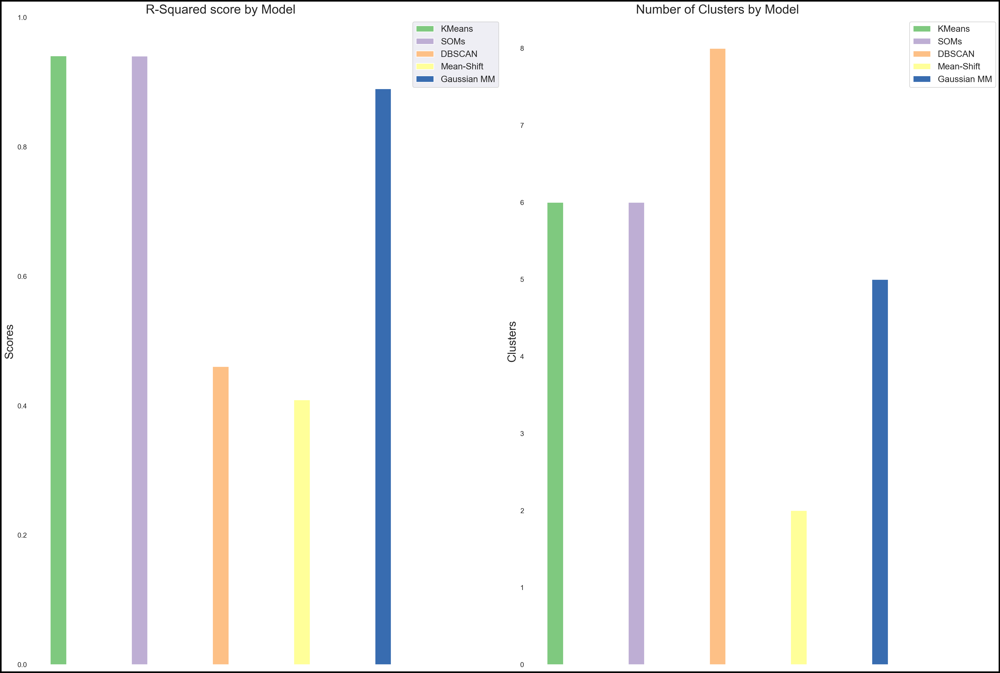

In [178]:
Preference_models = {
    "KMeans": ABCDE_PB_KM,
    "SOMs": ABCDE_PB_SOM_final,
    "DBSCAN": ABCDE_PB_DBSCAN,
    "Mean-Shift": ABCDE_PB_MSHIFT,
    "Gaussian MM": ABCDE_PB_GMM
}

# Assuming compare_models is a function defined elsewhere, we call it with the correct parameters
compare_models(Preference_models, cluster_column="cluster_labels_PB")

<a class="anchor" id="final-model">
 
# 6. Selected cluster technique: optimization
</a>

After conducting a comparison analysis for all models in each perspective, we decide that our strongest candidates for clustering are **K-Means and Hierarchical Clustering.**

 <a class="anchor" id="meg"></a>
## 6.1. Merging Clusters

In [248]:
ABCDE_out['behavior_labels'] = ABCDE_VB_SOM_final['cluster_labels_VB']
ABCDE_out['preference_labels'] = ABCDE_PB_SOM_final['cluster_labels_PB']

In [249]:
pd.crosstab(ABCDE_out['behavior_labels'],ABCDE_out['preference_labels'])

preference_labels,0,1,2,3,4,5
behavior_labels,,,,,,
0,4704,3046,3908,1316,2272,2052
1,868,943,484,704,1747,290
2,2261,242,3380,518,846,1897


In [250]:
metric_features = ['vendor_count', 'first_order', 'CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian',  'CUI_OTHER',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks', 'Weekdays_Transactions', 'Weekends_Transactions', 'Morning_Transactions',
       'Afternoon_Transactions', 'Evening_Transactions', 'Night_Transactions', 'Monetary_Spending', 'Engagement_Span',
       'Recency', 'behavior_labels', 'preference_labels']

In [251]:
ABCDE_centroids = ABCDE_out.groupby(['preference_labels','behavior_labels'])\
    [metric_features].mean()
ABCDE_centroids

vendor_count  first_order  CUI_American  \
preference_labels behavior_labels                                            
0                 0                    0.189655     0.621864      0.338966   
                  1                    0.309981     0.477492      0.409908   
                  2                    0.035733     0.768043      0.266302   
1                 0                    0.322461     0.583767      0.168148   
                  1                    0.441717     0.473590      0.251189   
                  2                    0.166837     0.748906      0.021361   
2                 0                    0.172397     0.646418      0.017547   
                  1                    0.327483     0.514782      0.061883   
                  2                    0.023217     0.789165      0.001467   
3                 0                    0.233402     0.604491      0.114653   
                  1                    0.441324     0.439539      0.215554   
                  2                    0.039064     0.782946      0.014934   
4                 0                    0.249889     0.615250      0.110131   
                  1                    0.496035     0.422604      0.271888   
                  2                    0.042942     0.780353      0.018316   
5                 0                    0.183207     0.636126      0.079439   
                  1                    0.330370     0.517173      0.129754   
                  2                    0.023480     0.777322      0.011067   

                                   CUI_Healthy  CUI_Indian  CUI_Italian  \
preference_labels behavior_labels                                         
0                 0                   0.003623    0.002355     0.214085   
                  1                   0.010460    0.008463     0.392637   
                  2                   0.000439    0.000213     0.173791   
1                 0                   0.031779    0.002375     0.002445   
                  1                   0.057030    0.022551     0.032244   
                  2                   0.002473    0.000000     0.000000   
2                 0                   0.079790    0.007431     0.013939   
                  1                   0.270387    0.024850     0.072749   
                  2                   0.030932    0.001053     0.001566   
3                 0                   0.016263    0.499491     0.104985   
                  1                   0.055400    0.558020     0.179086   
                  2                   0.004185    0.487596     0.013239   
4                 0                   0.005665    0.010369     0.097845   
                  1                   0.035841    0.056359     0.201393   
                  2                   0.003466    0.000602     0.016940   
5                 0                   0.032185    0.023379     0.017378   
                  1                   0.097608    0.049215     0.051183   
                  2                   0.004650    0.001612     0.001502   

                                   CUI_OTHER  CUI_Asian_Fusion  \
preference_labels behavior_labels                                
0                 0                 0.014256          0.229025   
                  1                 0.047879          0.322305   
                  2                 0.000588          0.048186   
1                 0                 0.001631          0.539156   
                  1                 0.043094          0.565944   
                  2                 0.000000          0.430592   
2                 0                 0.016420          0.466983   
                  1                 0.138712          0.504887   
                  2                 0.001404          0.405759   
3                 0                 0.102347          0.160101   
                  1                 0.233273          0.356458   
                  2                 0.016499          0.019045   
4                 0                 0.426738     

In [252]:
# Using Hierarchical clustering to merge the concatenated cluster centroids
linkage = 'ward'
hclust = AgglomerativeClustering(
    linkage=linkage, 
    metric='euclidean', 
    distance_threshold=0, 
    n_clusters=None
)

hclust_labels = hclust.fit_predict(ABCDE_centroids)

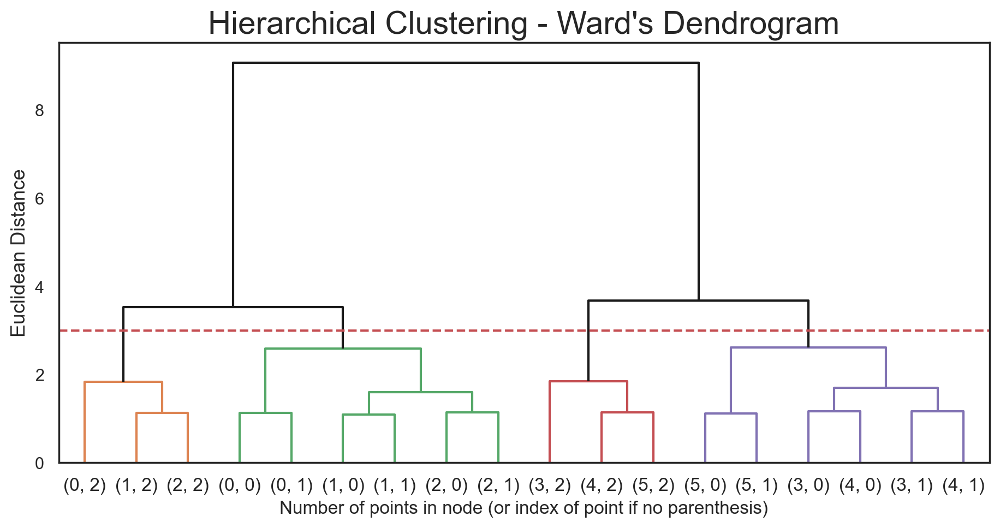

In [253]:
## create the counts of samples under each node (number of points being merged)
counts = np.zeros(hclust.children_.shape[0])
n_samples = len(hclust.labels_)

# hclust.children_ contains the observation ids that are being merged together
# At the i-th iteration, children[i][0] and children[i][1] are merged to form node n_samples + i
for i, merge in enumerate(hclust.children_):
    # track the number of observations in the current cluster being formed
    current_count = 0
    for child_idx in merge:
        if child_idx < n_samples:
            # If this is True, then we are merging an observation
            current_count += 1  # leaf node
        else:
            # Otherwise, we are merging a previously formed cluster
            current_count += counts[child_idx - n_samples]
    counts[i] = current_count

# the hclust.children_ is used to indicate the two points/clusters being merged (dendrogram's u-joins)
# the hclust.distances_ indicates the distance between the two points/clusters (height of the u-joins)
# the counts indicate the number of points being merged (dendrogram's x-axis)
linkage_matrix = np.column_stack(
    [hclust.children_, hclust.distances_, counts]
).astype(float)

# Plot the corresponding dendrogram
sns.set_style("white")
fig = plt.figure(figsize=(11,5))

# The Dendrogram parameters need to be tuned
y_threshold = 3
dendrogram(linkage_matrix, 
           truncate_mode='level', 
           labels=ABCDE_centroids.index, p=5, 
           color_threshold=y_threshold, 
           above_threshold_color='k')

# Add a horizontal line at the threshold
plt.hlines(y_threshold, 0, 1000, colors="r", linestyles="dashed")

# Set the title and labels
plt.title(f'Hierarchical Clustering - {linkage.title()}\'s Dendrogram', fontsize=21)
plt.xlabel('Number of points in node (or index of point if no parenthesis)')
plt.ylabel(f'Euclidean Distance', fontsize=13)



# Display the plot
plt.show()


In [254]:
# Re-running the Hierarchical clustering based on the correct number of clusters
hclust = AgglomerativeClustering(
    linkage='ward', 
    metric='euclidean', 
    n_clusters=4
)
hclust_labels = hclust.fit_predict(ABCDE_centroids)
ABCDE_centroids['hclust_labels'] = hclust_labels

ABCDE_centroids 

vendor_count  first_order  CUI_American  \
preference_labels behavior_labels                                            
0                 0                    0.189655     0.621864      0.338966   
                  1                    0.309981     0.477492      0.409908   
                  2                    0.035733     0.768043      0.266302   
1                 0                    0.322461     0.583767      0.168148   
                  1                    0.441717     0.473590      0.251189   
                  2                    0.166837     0.748906      0.021361   
2                 0                    0.172397     0.646418      0.017547   
                  1                    0.327483     0.514782      0.061883   
                  2                    0.023217     0.789165      0.001467   
3                 0                    0.233402     0.604491      0.114653   
                  1                    0.441324     0.439539      0.215554   
                  2                    0.039064     0.782946      0.014934   
4                 0                    0.249889     0.615250      0.110131   
                  1                    0.496035     0.422604      0.271888   
                  2                    0.042942     0.780353      0.018316   
5                 0                    0.183207     0.636126      0.079439   
                  1                    0.330370     0.517173      0.129754   
                  2                    0.023480     0.777322      0.011067   

                                   CUI_Healthy  CUI_Indian  CUI_Italian  \
preference_labels behavior_labels                                         
0                 0                   0.003623    0.002355     0.214085   
                  1                   0.010460    0.008463     0.392637   
                  2                   0.000439    0.000213     0.173791   
1                 0                   0.031779    0.002375     0.002445   
                  1                   0.057030    0.022551     0.032244   
                  2                   0.002473    0.000000     0.000000   
2                 0                   0.079790    0.007431     0.013939   
                  1                   0.270387    0.024850     0.072749   
                  2                   0.030932    0.001053     0.001566   
3                 0                   0.016263    0.499491     0.104985   
                  1                   0.055400    0.558020     0.179086   
                  2                   0.004185    0.487596     0.013239   
4                 0                   0.005665    0.010369     0.097845   
                  1                   0.035841    0.056359     0.201393   
                  2                   0.003466    0.000602     0.016940   
5                 0                   0.032185    0.023379     0.017378   
                  1                   0.097608    0.049215     0.051183   
                  2                   0.004650    0.001612     0.001502   

                                   CUI_OTHER  CUI_Asian_Fusion  \
preference_labels behavior_labels                                
0                 0                 0.014256          0.229025   
                  1                 0.047879          0.322305   
                  2                 0.000588          0.048186   
1                 0                 0.001631          0.539156   
                  1                 0.043094          0.565944   
                  2                 0.000000          0.430592   
2                 0                 0.016420          0.466983   
                  1                 0.138712          0.504887   
                  2                 0.001404          0.405759   
3                 0                 0.102347          0.160101   
                  1                 0.233273          0.356458   
                  2                 0.016499          0.019045   
4                 0                 0.426738     

In [255]:
# Mapper between concatenated clusters and hierarchical clusters
cluster_mapper = ABCDE_centroids['hclust_labels'].to_dict()
cluster_mapper


{(0, 0): 1,
 (0, 1): 1,
 (0, 2): 3,
 (1, 0): 1,
 (1, 1): 1,
 (1, 2): 3,
 (2, 0): 1,
 (2, 1): 1,
 (2, 2): 3,
 (3, 0): 0,
 (3, 1): 0,
 (3, 2): 2,
 (4, 0): 0,
 (4, 1): 0,
 (4, 2): 2,
 (5, 0): 0,
 (5, 1): 0,
 (5, 2): 2}

In [256]:
ABCDE_ = ABCDE_out.copy()

In [257]:
ABCDE_['merged_labels'] = ABCDE_.apply(
    lambda row: cluster_mapper[
        ( row['preference_labels'],row['behavior_labels'])
    ], axis=1
)

ABCDE_

,vendor_count,first_order,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Monetary_Spending,Engagement_Span,Recency,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks,customer_region_2360,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8370,customer_region_8550,customer_region_8670,is_chain_0,is_chain_1,last_promo_-,last_promo_DELIVERY,last_promo_DISCOUNT,last_promo_FREEBIE,payment_method_CARD,payment_method_CASH,payment_method_DIGI,Buyer_type_OneTime_Buyer,Buyer_type_Repeated_Buyer,Spending_Budget_Q1 (Low),Spending_Budget_Q2 (Medium-Low),Spending_Budget_Q3 (Medium-High),Spending_Budget_Q4 (High),Consumer_Segment_Group/Family,Consumer_Segment_Individual,cities_2,cities_4,cities_8,behavior_labels,preference_labels,merged_labels
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1b8f824d5e,0.141662,0.0,0.000000,0.0,0.667618,0.00000,0.0,0.000000,0.341303,0.000000,0.000000,0.276708,0.00000,0.490202,0.153662,0.997550,0.000000,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,2,3,2
5d272b9dcb,0.141662,0.0,0.487951,0.0,0.000000,0.00000,0.0,0.000000,0.341303,0.279415,0.000000,0.000000,0.00000,0.428018,0.153662,0.997550,0.330260,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2,0,3
f6d1b2ba63,0.000000,0.0,0.431516,0.0,0.000000,0.00000,0.0,0.000000,0.341303,0.279415,0.000000,0.000000,0.00000,0.319272,0.153662,0.997550,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2,0,3
180c632ed8,0.141662,0.0,0.000000,0.0,0.577190,0.00000,0.0,0.165443,0.215338,0.176291,0.184289,0.000000,0.00000,0.503862,0.243548,0.995073,0.443816,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,2,3,2
4eb37a6705,0.141662,0.0,0.510105,0.0,0.000000,0.00000,0.0,0.165443,0.215338,0.279415,0.000000,0.000000,0.00000,0.591345,0.243548,0.995073,0.616650,0.000000,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,2,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0.000000,0.0,0.000000,0.0,0.000000,0.00000,0.0,0.000000,0.215338,0.000000,0.184289,0.000000,0.00000,0.418534,0.000000,1.000000,0.000000,0.557398,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2,5,2
f6b6709018,0.000000,0.0,0.547489,0.0,0.000000,0.00000,0.0,0.000000,0.215338,0.000000,0.184289,0.000000,0.00000,0.418534,0.000000,1.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2,0,3
f74ad8ce3f,0.000000,0.0,0.000000,0.0,0.000000,0.00000,0.0,0.000000,0.215338,0.000000,0.000000,0.000000,0.21031,0.416432,0.000000,1.000000,0.000000,0.554898,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,2,5,2


In [258]:
merged_metric_features= [ 'vendor_count', 'first_order', 'CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian', 'CUI_OTHER', 'Weekdays_Transactions',
       'Weekends_Transactions', 'Morning_Transactions',
       'Afternoon_Transactions', 'Evening_Transactions', 'Night_Transactions',
       'Monetary_Spending', 'Engagement_Span', 'Recency',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks',
        'behavior_labels', 'preference_labels', 'merged_labels']

In [259]:
# Merged cluster centroids
ABCDE_[merged_metric_features].groupby('merged_labels').mean()

,vendor_count,first_order,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Monetary_Spending,Engagement_Span,Recency,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks,behavior_labels,preference_labels
merged_labels,,,,,,,,,,,,,,,,,,,,,
0,0.301148,0.560362,0.146579,0.027472,0.147290,0.106059,0.279492,0.356403,0.260615,0.164146,0.295849,0.181660,0.032931,0.494432,0.846561,0.555326,0.218891,0.164116,0.131621,0.327049,4.038420
1,0.243115,0.597708,0.200521,0.044391,0.006306,0.105741,0.020464,0.314828,0.223080,0.168465,0.208345,0.092707,0.113668,0.514780,0.825771,0.577786,0.401518,0.118690,0.108201,0.164481,0.915430
2,0.031005,0.779001,0.013562,0.004269,0.078547,0.007372,0.117601,0.144535,0.068523,0.056972,0.102184,0.043022,0.020591,0.359101,0.077793,0.790502,0.013165,0.138065,0.146199,2.000000,4.422876
3,0.033935,0.779391,0.104069,0.018042,0.000686,0.067693,0.001033,0.143989,0.073844,0.067053,0.084608,0.035267,0.041612,0.362620,0.085909,0.788634,0.269356,0.019664,0.013757,2.000000,1.190209


 <a class="anchor" id="analy"></a>
## 6.2. Analysis of Merging Clusters

In [260]:
cluster_sizes = ABCDE_['merged_labels'].value_counts().sort_index()  # Cluster sizes
total_points = ABCDE_.shape[0]  # Total number of data points

# Calculate percentages
cluster_percentages = (cluster_sizes / total_points) * 100

# Convert to list 
cluster_sizes_list = cluster_sizes.tolist()
cluster_percentages_list = cluster_percentages.tolist()

# Print the results
print("Cluster Sizes:", cluster_sizes_list)
print("Cluster Percentages:", cluster_percentages_list)


Cluster Sizes: [8381, 13953, 3261, 5883]
Cluster Percentages: [26.624944405616617, 44.32619607344812, 10.35961623991359, 18.689243281021668]


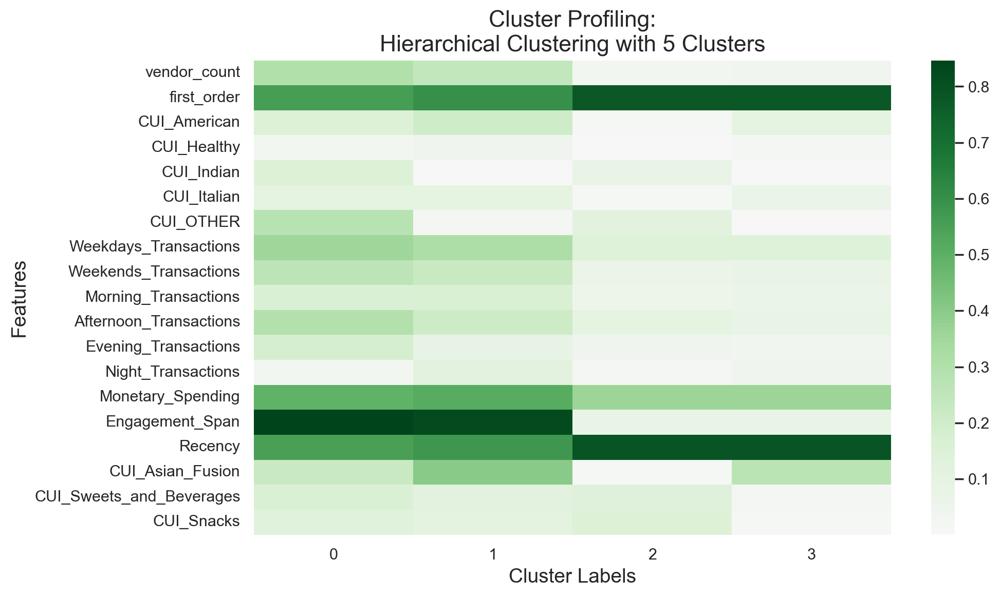

In [261]:
merged_metric_features_analysis= [ 'vendor_count', 'first_order', 'CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian', 'CUI_OTHER', 'Weekdays_Transactions',
       'Weekends_Transactions', 'Morning_Transactions',
       'Afternoon_Transactions', 'Evening_Transactions', 'Night_Transactions'
       , 'Monetary_Spending', 'Engagement_Span', 'Recency',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks', 'merged_labels']

# Create the figure and axis
fig, ax = plt.subplots(figsize=(10, 6))  

# Compute the mean profile for each cluster
hc_profile = ABCDE_[merged_metric_features_analysis].groupby('merged_labels').mean().T

# Plot the heatmap with a new color palette
sns.heatmap(
    hc_profile,
    center=0, 
    annot=False,  
    cmap="PRGn",
    fmt=".2f",
    ax=ax
)


ax.set_xlabel("Cluster Labels", fontsize=14)
ax.set_ylabel("Features", fontsize=14)  # Adding this for clarity
ax.set_title("Cluster Profiling:\nHierarchical Clustering with 5 Clusters", fontsize=16)

plt.show()


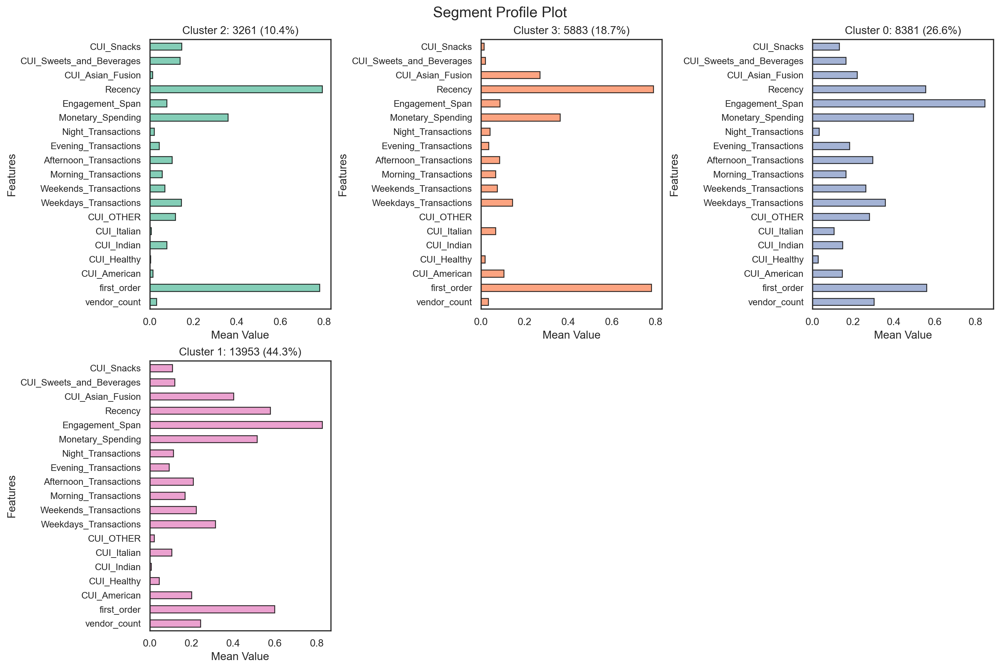

In [196]:
data = ABCDE_[merged_metric_features_analysis]
clusters = data['merged_labels'].unique()

# Calculate cluster sizes and percentages
cluster_sizes = data['merged_labels'].value_counts().sort_index()
total_size = len(data)
cluster_percentages = (cluster_sizes / total_size) * 100

# Calculate mean profiles for each cluster
hc_profile = data.groupby('merged_labels').mean()

# Plot setup
fig, axes = plt.subplots(2, 3, figsize=(15, 10), constrained_layout=True)  # Adjust based on cluster count
axes = axes.flatten()

colors = sns.color_palette("Set2", len(clusters))  # Custom color palette for each cluster

for idx, (cluster, ax) in enumerate(zip(clusters, axes)):
    # Bar plot for the cluster
    mean_profile = hc_profile.loc[cluster]
    mean_profile.plot.barh(
        ax=ax,
        color=colors[idx],
        alpha=0.8,
        edgecolor='black'
    )
    
    # Add cluster size and percentage to title
    cluster_size = cluster_sizes[cluster]
    cluster_percentage = cluster_percentages[cluster]
    ax.set_title(f"Cluster {cluster}: {cluster_size} ({cluster_percentage:.1f}%)", fontsize=12)
    ax.set_xlabel("Mean Value")
    ax.set_ylabel("Features")
    ax.tick_params(axis='y', labelsize=10)

# Remove unused axes 
for extra_ax in axes[len(clusters):]:
    extra_ax.set_visible(False)

# Overall plot title
fig.suptitle("Segment Profile Plot", fontsize=16)

plt.show()


In [197]:
metric_features_final=['vendor_count', 'first_order', 'CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian','CUI_OTHER', 'Weekdays_Transactions',
       'Weekends_Transactions', 'Morning_Transactions',
       'Afternoon_Transactions', 'Evening_Transactions', 'Night_Transactions',
        'Monetary_Spending', 'Engagement_Span', 'Recency',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks']

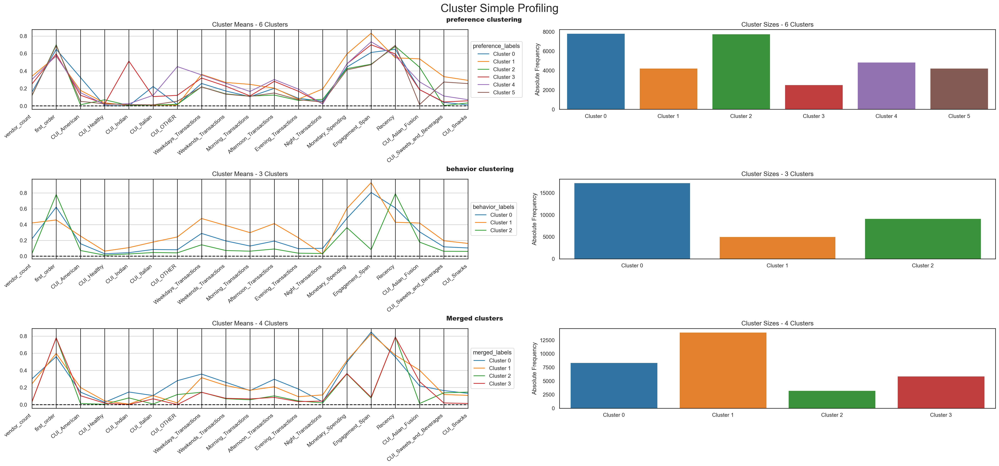

In [198]:
# Profilling each cluster (product, behavior, merged)
cluster_profiles(
    df=ABCDE_[metric_features_final + ['preference_labels','behavior_labels', 'merged_labels']], 
    label_columns=['preference_labels','behavior_labels', 'merged_labels'], 
    figsize=(28, 13), 
    compare_titles=["preference clustering", "behavior clustering", "Merged clusters"]
)


 <a class="anchor" id="prof"></a>
# 7. Profiling with categorical data

In [199]:
ABCDE_final.columns

Index(['customer_age', 'vendor_count', 'product_count', 'first_order',
       'last_order', 'CUI_American', 'CUI_Healthy', 'CUI_Indian',
       'CUI_Italian', 'CUI_OTHER', 'Weekdays_Transactions',
       'Weekends_Transactions', 'Morning_Transactions',
       'Afternoon_Transactions', 'Evening_Transactions', 'Night_Transactions',
       'Frequency', 'Monetary_Spending', 'Engagement_Span', 'Recency',
       'CUI_Asian_Fusion', 'CUI_Sweets_and_Beverages', 'CUI_Snacks',
       'customer_region_2360', 'customer_region_2440', 'customer_region_2490',
       'customer_region_4140', 'customer_region_4660', 'customer_region_8370',
       'customer_region_8550', 'customer_region_8670', 'is_chain_0',
       'is_chain_1', 'last_promo_-', 'last_promo_DELIVERY',
       'last_promo_DISCOUNT', 'last_promo_FREEBIE', 'payment_method_CARD',
       'payment_method_CASH', 'payment_method_DIGI',
       'Buyer_type_OneTime_Buyer', 'Buyer_type_Repeated_Buyer',
       'Spending_Budget_Q1 (Low)', 'Spending_Budg

In [200]:
profiling_values = ['customer_region_2360', 'customer_region_2440', 'customer_region_2490',
       'customer_region_4140', 'customer_region_4660', 'customer_region_8370',
       'customer_region_8550', 'customer_region_8670', 'is_chain_0',
       'is_chain_1', 'last_promo_-', 'last_promo_DELIVERY',
       'last_promo_DISCOUNT', 'last_promo_FREEBIE', 'payment_method_CARD',
       'payment_method_CASH', 'payment_method_DIGI',
       'Buyer_type_OneTime_Buyer', 'Buyer_type_Repeated_Buyer',
       'Spending_Budget_Q1 (Low)', 'Spending_Budget_Q2 (Medium-Low)',
       'Spending_Budget_Q3 (Medium-High)', 'Spending_Budget_Q4 (High)',
       'Consumer_Segment_Group/Family', 'Consumer_Segment_Individual',
       'cities_2', 'cities_4', 'cities_8','merged_labels']

In [201]:
ABCDE_[profiling_values].groupby(['merged_labels']).sum()


,customer_region_2360,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8370,customer_region_8550,customer_region_8670,is_chain_0,is_chain_1,last_promo_-,last_promo_DELIVERY,last_promo_DISCOUNT,last_promo_FREEBIE,payment_method_CARD,payment_method_CASH,payment_method_DIGI,Buyer_type_OneTime_Buyer,Buyer_type_Repeated_Buyer,Spending_Budget_Q1 (Low),Spending_Budget_Q2 (Medium-Low),Spending_Budget_Q3 (Medium-High),Spending_Budget_Q4 (High),Consumer_Segment_Group/Family,Consumer_Segment_Individual,cities_2,cities_4,cities_8
merged_labels,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,3808.0,681.0,213.0,174.0,2667.0,34.0,25.0,779.0,672.0,7709.0,5027.0,1182.0,1033.0,1139.0,5913.0,1024.0,1444.0,7.0,8374.0,5949.0,805.0,837.0,790.0,4624.0,3757.0,4702.0,2841.0,838.0
1,2671.0,430.0,119.0,366.0,4114.0,247.0,252.0,5754.0,2130.0,11823.0,8364.0,1810.0,1770.0,2009.0,10084.0,1728.0,2141.0,15.0,13938.0,9277.0,1501.0,1492.0,1683.0,7743.0,6210.0,3220.0,4480.0,6253.0
2,1113.0,191.0,63.0,85.0,721.0,60.0,59.0,969.0,987.0,2274.0,1056.0,1194.0,591.0,420.0,1392.0,1010.0,859.0,2495.0,766.0,3152.0,60.0,40.0,9.0,124.0,3137.0,1367.0,806.0,1088.0
3,1173.0,178.0,47.0,230.0,1902.0,154.0,119.0,2080.0,2208.0,3675.0,2084.0,2013.0,1039.0,747.0,2523.0,1788.0,1572.0,4366.0,1517.0,5727.0,108.0,46.0,2.0,224.0,5659.0,1398.0,2132.0,2353.0


## Region Bar plots - Merged labels

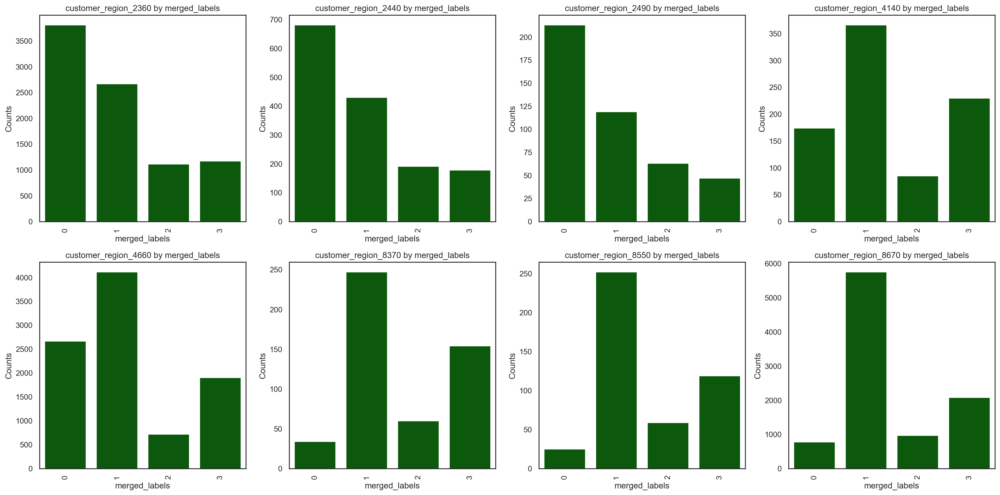

In [202]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['customer_region_2360', 'customer_region_2440', 'customer_region_2490',
                                               'customer_region_4140', 'customer_region_4660', 'customer_region_8370',
                                                'customer_region_8550', 'customer_region_8670'])


(<Figure size 800x800 with 1 Axes>,
 <PolarAxes: title={'center': 'Radar Chart for Features by merged_labels'}>)

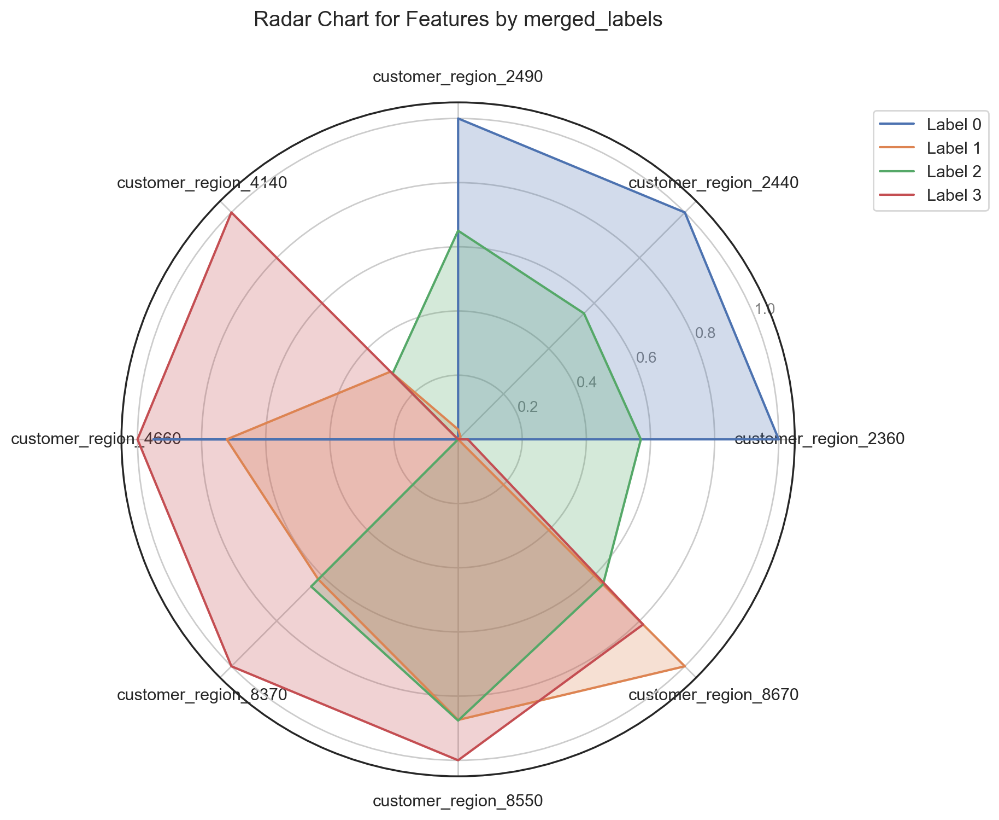

In [203]:
plot_radar_chart(ABCDE_, 'merged_labels', ['customer_region_2360', 'customer_region_2440', 'customer_region_2490',
                                           'customer_region_4140', 'customer_region_4660', 'customer_region_8370',
                                           'customer_region_8550', 'customer_region_8670'])

## Cities plots - Merged labels

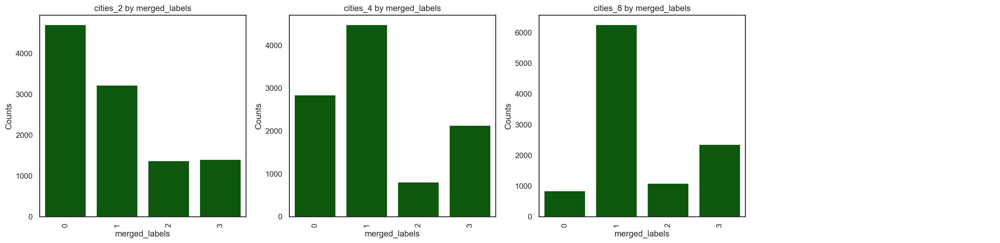

In [204]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['cities_2', 'cities_4', 'cities_8'])

## Promo code plots - Merged labels

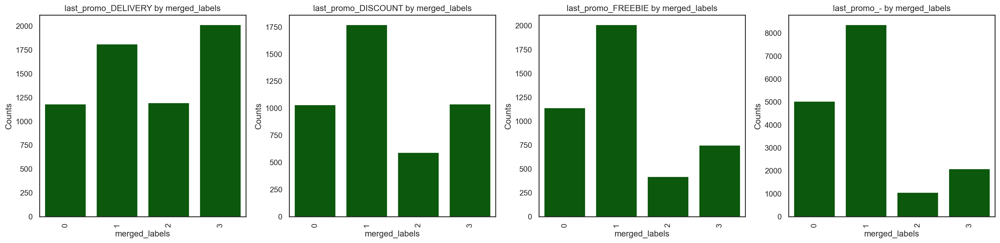

In [205]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['last_promo_DELIVERY', 'last_promo_DISCOUNT',
       'last_promo_FREEBIE','last_promo_-'])

## Payment Methods plots - Merged labels

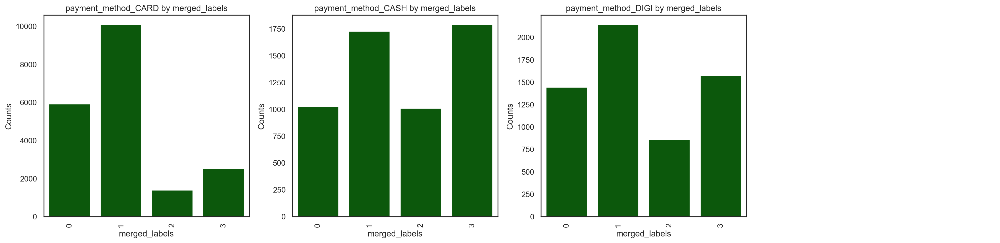

In [206]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['payment_method_CARD', 'payment_method_CASH',
       'payment_method_DIGI'])

## Buyer Type plots - Merged labels

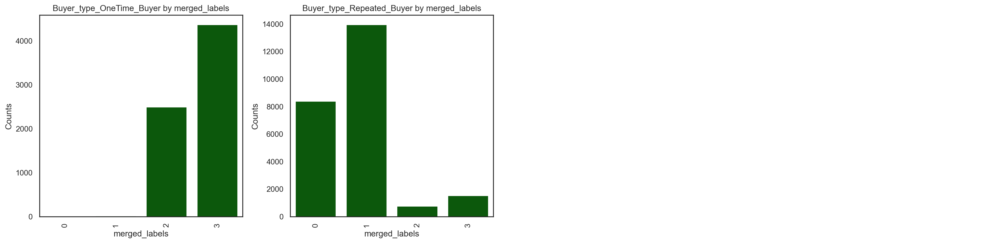

In [207]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['Buyer_type_OneTime_Buyer', 'Buyer_type_Repeated_Buyer'])

## Is chain plots - Merged labels

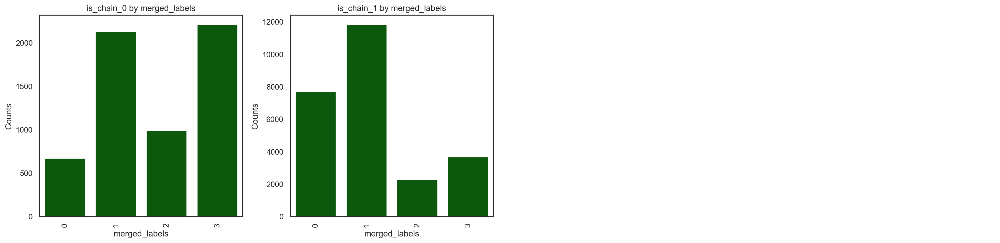

In [208]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['is_chain_0',
       'is_chain_1'])

## Consumer Segment plots - Merged labels

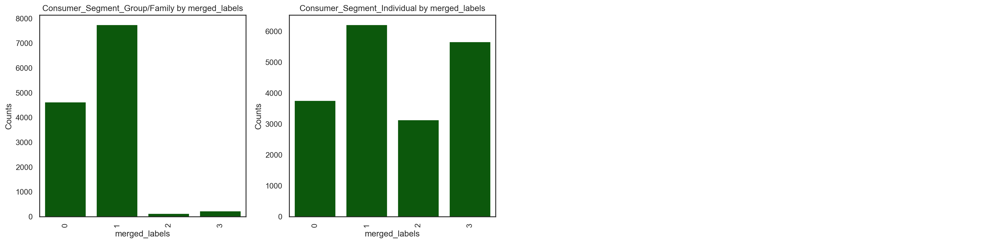

In [209]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['Consumer_Segment_Group/Family', 'Consumer_Segment_Individual'])

## Spending Budget plots - Merged labels

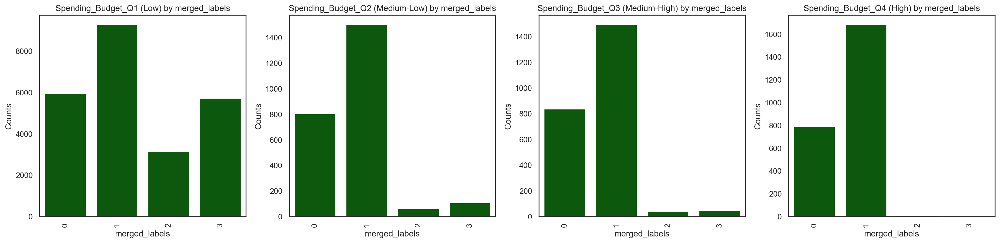

In [210]:
plot_profiling_barplots(ABCDE_, 'merged_labels', ['Spending_Budget_Q1 (Low)', 'Spending_Budget_Q2 (Medium-Low)',
       'Spending_Budget_Q3 (Medium-High)', 'Spending_Budget_Q4 (High)'])

<a class="anchor" id="mcv"></a>
# 8. Merged Clusters Visualization 

In [211]:
metric_features_viz  = ["Monetary_Spending","Recency","Weekdays_Transactions", "Weekends_Transactions", "Morning_Transactions", 
                                "Afternoon_Transactions", "Evening_Transactions","Night_Transactions","Engagement_Span", 'CUI_American', 
                                'CUI_Healthy', 'CUI_Indian', 'CUI_Italian', 'CUI_OTHER', 'CUI_Asian_Fusion', 
                                'CUI_Sweets_and_Beverages', 'CUI_Snacks']
len(metric_features_viz)

17

In [212]:
ABCDE_[metric_features_viz]


,Monetary_Spending,Recency,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Engagement_Span,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks
customer_id,,,,,,,,,,,,,,,,,
1b8f824d5e,0.490202,0.997550,0.000000,0.341303,0.000000,0.000000,0.276708,0.00000,0.153662,0.000000,0.0,0.667618,0.00000,0.0,0.000000,0.000000,0.0
5d272b9dcb,0.428018,0.997550,0.000000,0.341303,0.279415,0.000000,0.000000,0.00000,0.153662,0.487951,0.0,0.000000,0.00000,0.0,0.330260,0.000000,0.0
f6d1b2ba63,0.319272,0.997550,0.000000,0.341303,0.279415,0.000000,0.000000,0.00000,0.153662,0.431516,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.0
180c632ed8,0.503862,0.995073,0.165443,0.215338,0.176291,0.184289,0.000000,0.00000,0.243548,0.000000,0.0,0.577190,0.00000,0.0,0.443816,0.000000,0.0
4eb37a6705,0.591345,0.995073,0.165443,0.215338,0.279415,0.000000,0.000000,0.00000,0.243548,0.510105,0.0,0.000000,0.00000,0.0,0.616650,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
f4e366c281,0.418534,1.000000,0.000000,0.215338,0.000000,0.184289,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.00000,0.0,0.000000,0.557398,0.0
f6b6709018,0.418534,1.000000,0.000000,0.215338,0.000000,0.184289,0.000000,0.00000,0.000000,0.547489,0.0,0.000000,0.00000,0.0,0.000000,0.000000,0.0
f74ad8ce3f,0.416432,1.000000,0.000000,0.215338,0.000000,0.000000,0.000000,0.21031,0.000000,0.000000,0.0,0.000000,0.00000,0.0,0.000000,0.554898,0.0


 <a class="anchor" id="pca"></a>
## 8.1. PCA

*Code inspiration* -> https://youtu.be/015vL0cJfA0

In [213]:
pca = PCA(random_state=42, n_components=2)
pca_result = pca.fit_transform(ABCDE_[metric_features_viz])


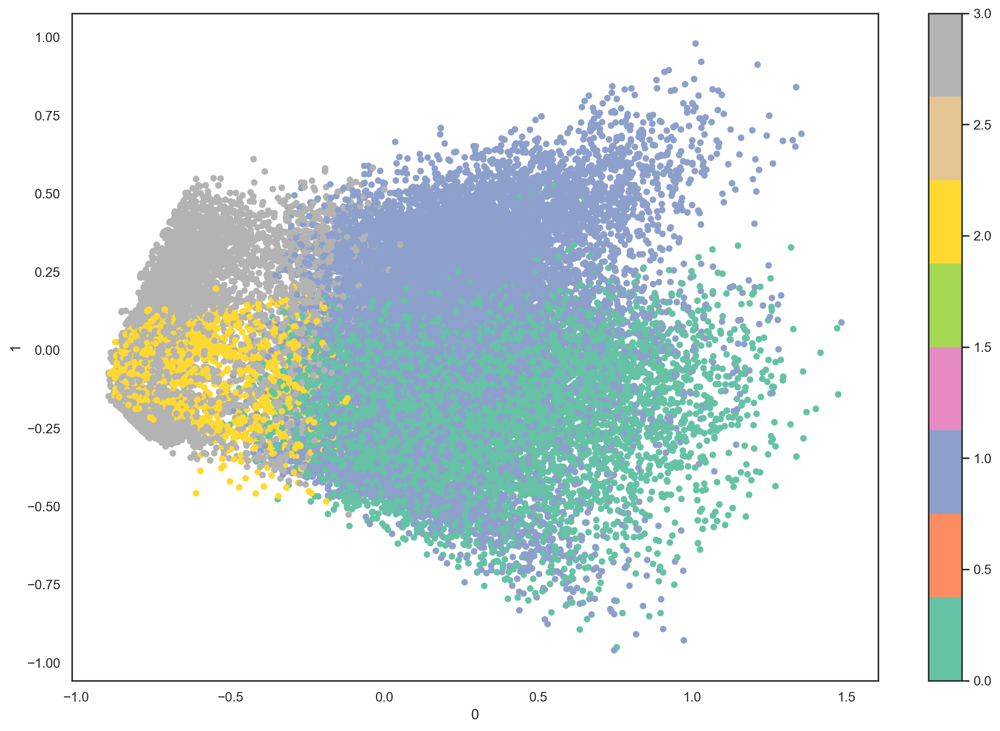

In [214]:
pd.DataFrame(pca_result).plot.scatter(x=0, y=1, c=ABCDE_['merged_labels'], colormap='Set2', figsize=(15,10))
plt.show()

<a class="anchor" id="TSNE"></a>
## 8.2. TSNE 

In [215]:
# This step can take a long time to run
two_dim = TSNE(n_components=2, random_state=42, perplexity=20, n_iter_without_progress=500).fit_transform(ABCDE_[metric_features_viz])

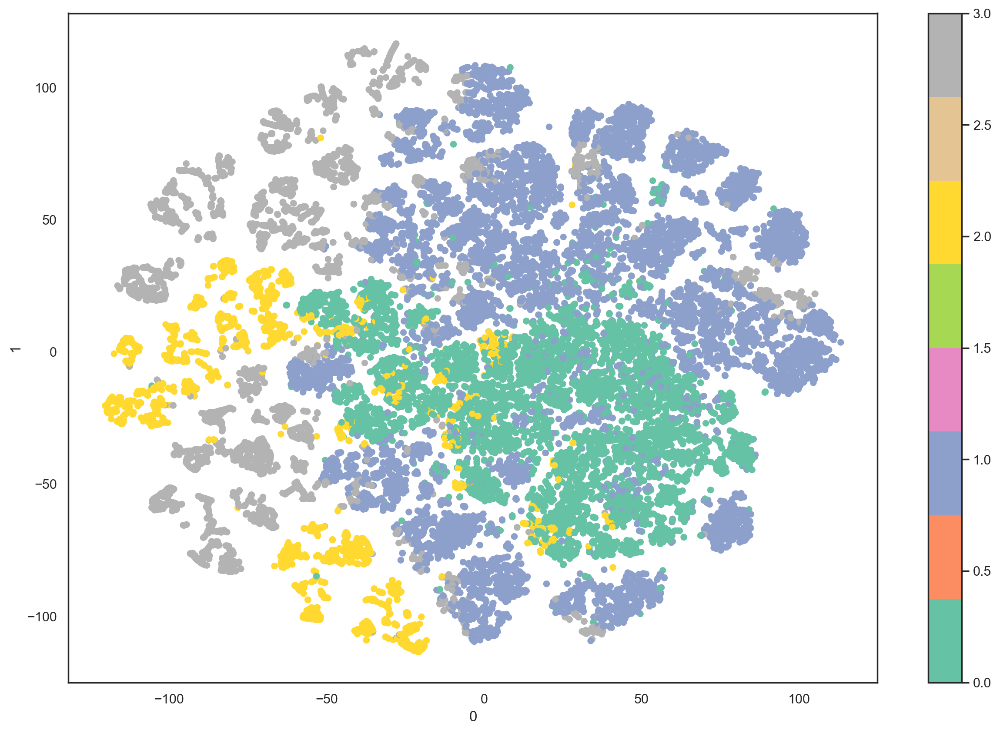

In [216]:
# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=ABCDE_['merged_labels'], colormap='Set2', figsize=(15,10))
plt.show()
#gives us suport in our cluster decision, overlap happens because the plot is representing people and they are not linear.

*TSNE with PCA*

In [217]:
# This is step can take a long time to run
two_dim = TSNE(random_state=42, perplexity=30).fit_transform(pca_result)

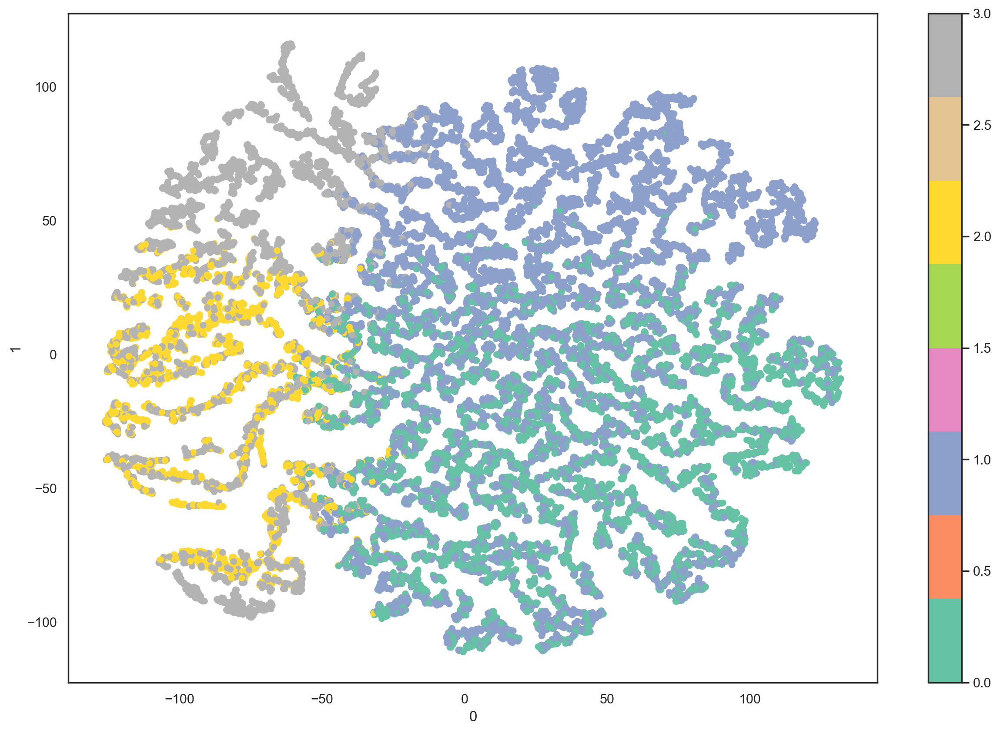

In [218]:
# t-SNE visualization
pd.DataFrame(two_dim).plot.scatter(x=0, y=1, c=ABCDE_['merged_labels'], colormap='Set2', figsize=(15,10))
plt.show()
#gives us suport in our cluster decision, overlap happens cause this is are people and they are not linear.

<a class="anchor" id="UMAP"></a>
## 8.3. UMAP 

- Inspired by the video : https://youtu.be/015vL0cJfA0

In [219]:
#!pip install umap-learn
#!pip install plotly

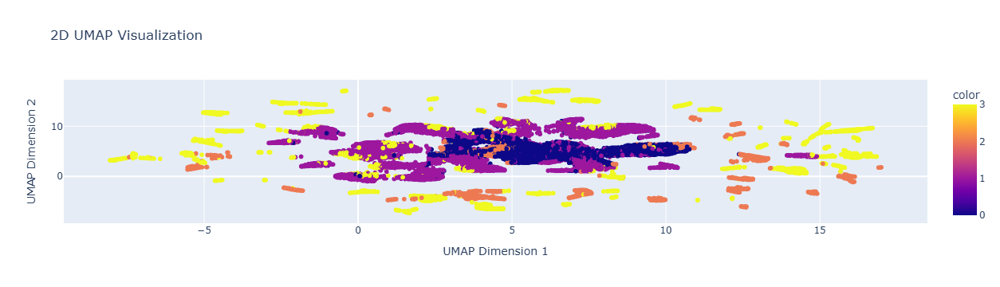

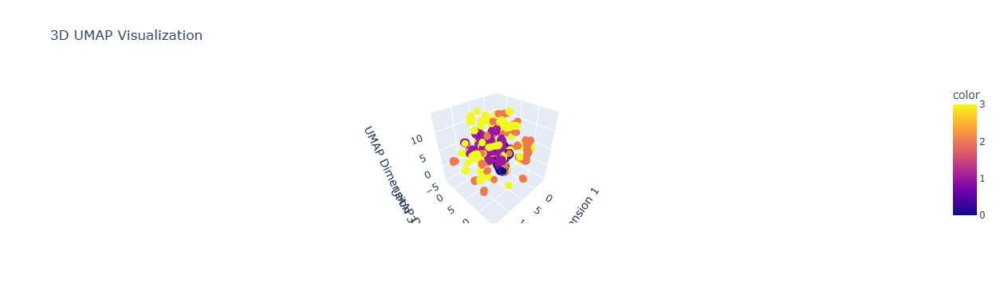

In [220]:
umap_2d = UMAP (n_components = 2 , init = 'random', random_state =42)
umap_3d = UMAP (n_components = 3 , init = 'random', random_state =42)

proj_2d = umap_2d.fit_transform(ABCDE_[metric_features_viz])
proj_3d = umap_3d.fit_transform(ABCDE_[metric_features_viz])

# For 2D UMAP visualization
fig_2d = px.scatter(
    x=proj_2d[:, 0], 
    y=proj_2d[:, 1], 
    color=ABCDE_['merged_labels'],  # Correct argument for coloring
    color_discrete_sequence=px.colors.qualitative.Set2,
    labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2'},
    title="2D UMAP Visualization"
)



# For 3D UMAP visualization
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], 
    y=proj_3d[:, 1], 
    z=proj_3d[:, 2], 
    color=ABCDE_['merged_labels'],  # Correct argument for coloring
    color_discrete_sequence=px.colors.qualitative.Set2,  # Use Set2 colormap
    labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2', 'z': 'UMAP Dimension 3'},
    title="3D UMAP Visualization"
)

fig_3d.update_traces(marker_size=5)

fig_2d.show()
fig_3d.show()


*UMAP with PCA*

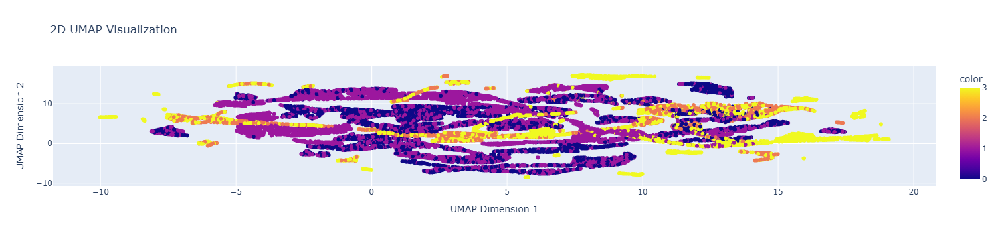

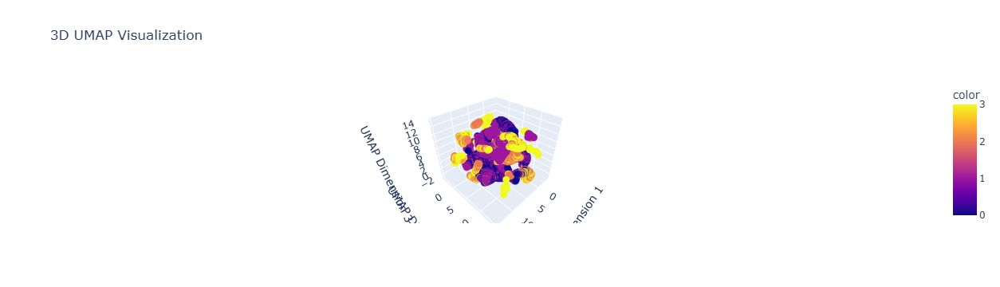

In [221]:
umap_2d = UMAP (n_components = 2 , init = 'random', random_state =42)
umap_3d = UMAP (n_components = 3 , init = 'random', random_state =42)

proj_2d = umap_2d.fit_transform(pca_result)
proj_3d = umap_3d.fit_transform(pca_result)

# For 2D UMAP visualization
fig_2d = px.scatter(
    x=proj_2d[:, 0], 
    y=proj_2d[:, 1], 
    color=ABCDE_['merged_labels'],  # Correct argument for coloring
    color_discrete_sequence=px.colors.qualitative.Set2,
    labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2'},
    title="2D UMAP Visualization"
)



# For 3D UMAP visualization
fig_3d = px.scatter_3d(
    x=proj_3d[:, 0], 
    y=proj_3d[:, 1], 
    z=proj_3d[:, 2], 
    color=ABCDE_['merged_labels'],  # Correct argument for coloring
    color_discrete_sequence=px.colors.qualitative.Set2,  # Use Set2 colormap
    labels={'x': 'UMAP Dimension 1', 'y': 'UMAP Dimension 2', 'z': 'UMAP Dimension 3'},
    title="3D UMAP Visualization"
)

fig_3d.update_traces(marker_size=5)

fig_2d.show()
fig_3d.show()


 <a class="anchor" id="ro"></a>
# 9. Reclassifying Outliers and Feature Importance Assessment

### Using the R²

In [222]:
get_ss_variables(ABCDE_)

vendor_count                          975.398204
first_order                          2107.278648
CUI_American                         1608.095052
CUI_Healthy                           475.734131
CUI_Indian                            747.281756
CUI_Italian                          1145.672347
CUI_OTHER                            1186.096779
Weekdays_Transactions                 755.703843
Weekends_Transactions                1034.383083
Morning_Transactions                  797.697344
Afternoon_Transactions               1035.043910
Evening_Transactions                  685.053653
Night_Transactions                    627.753517
Monetary_Spending                     635.793829
Engagement_Span                      4348.111128
Recency                              1715.540245
CUI_Asian_Fusion                     2108.336784
CUI_Sweets_and_Beverages             1429.778652
CUI_Snacks                           1302.773478
customer_region_2360                 6324.399422
customer_region_2440

In [223]:
# We are essentially decomposing the R² into the R² for each variable
r2_variables(ABCDE_[metric_features_final + ['merged_labels']], 'merged_labels').drop('merged_labels')

vendor_count                0.376110
first_order                 0.121207
CUI_American                0.067645
CUI_Healthy                 0.012451
CUI_Indian                  0.164502
CUI_Italian                 0.026833
CUI_OTHER                   0.351045
Weekdays_Transactions       0.309772
Weekends_Transactions       0.178401
Morning_Transactions        0.087322
Afternoon_Transactions      0.180968
Evening_Transactions        0.134091
Night_Transactions          0.080919
Monetary_Spending           0.220307
Engagement_Span             0.841102
Recency                     0.184485
CUI_Asian_Fusion            0.222068
CUI_Sweets_and_Beverages    0.052873
CUI_Snacks                  0.046070
dtype: float64

### Using a Decision Tree

In [224]:
# Preparing the data
X = ABCDE_[metric_features_final]
y = ABCDE_.merged_labels

# Splitting the data
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

# Fitting the decision tree
dt = DecisionTreeClassifier(random_state=42, max_depth=3)
dt.fit(X_train, y_train)
print("It is estimated that in average, we are able to predict {0:.2f}% of the customers correctly".format(dt.score(X_test, y_test)*100))

It is estimated that in average, we are able to predict 84.63% of the customers correctly


In [225]:
# Assessing feature importance
pd.Series(dt.feature_importances_, index=X_train.columns).sort_values(ascending=False)

Engagement_Span             0.431543
CUI_OTHER                   0.286170
CUI_Indian                  0.123636
CUI_Asian_Fusion            0.088272
CUI_American                0.059004
CUI_Healthy                 0.011375
vendor_count                0.000000
Night_Transactions          0.000000
CUI_Sweets_and_Beverages    0.000000
Recency                     0.000000
Monetary_Spending           0.000000
Morning_Transactions        0.000000
Evening_Transactions        0.000000
Afternoon_Transactions      0.000000
first_order                 0.000000
Weekends_Transactions       0.000000
Weekdays_Transactions       0.000000
CUI_Italian                 0.000000
CUI_Snacks                  0.000000
dtype: float64

In [226]:
# Predicting the cluster labels of the outliers; predictinng outleiers using supervised learning
ABCDE_outliers['merged_labels'] = dt.predict(ABCDE_outliers[metric_features_final])
ABCDE_outliers.head()
# between 3 to 7 is a good clustering number


,customer_age,vendor_count,product_count,first_order,last_order,CUI_American,CUI_Healthy,CUI_Indian,CUI_Italian,CUI_OTHER,Weekdays_Transactions,Weekends_Transactions,Morning_Transactions,Afternoon_Transactions,Evening_Transactions,Night_Transactions,Frequency,Monetary_Spending,Engagement_Span,Recency,CUI_Asian_Fusion,CUI_Sweets_and_Beverages,CUI_Snacks,customer_region_2360,customer_region_2440,customer_region_2490,customer_region_4140,customer_region_4660,customer_region_8370,customer_region_8550,customer_region_8670,is_chain_0,is_chain_1,last_promo_-,last_promo_DELIVERY,last_promo_DISCOUNT,last_promo_FREEBIE,payment_method_CARD,payment_method_CASH,payment_method_DIGI,Buyer_type_OneTime_Buyer,Buyer_type_Repeated_Buyer,Spending_Budget_Q1 (Low),Spending_Budget_Q2 (Medium-Low),Spending_Budget_Q3 (Medium-High),Spending_Budget_Q4 (High),Consumer_Segment_Group/Family,Consumer_Segment_Individual,cities_2,cities_4,cities_8,merged_labels
customer_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1f1fe12bed,0.322622,0.383835,0.321896,0.0,0.431383,0.360499,0.608305,0.000000,0.000000,0.00000,0.330885,0.341303,0.352583,0.184289,0.000000,0.210310,0.294875,0.606723,0.431383,0.984879,0.316035,0.000000,0.600857,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,3
543b4d9746,0.274644,0.383835,0.564575,0.0,0.713584,0.000000,0.000000,0.373804,0.361414,0.00000,0.496328,0.556641,0.585627,0.292091,0.174583,0.000000,0.502404,0.667522,0.713584,0.932127,0.000000,0.818747,0.260711,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0
75738ab3bd,0.299352,0.383835,0.413544,0.0,0.862767,0.397640,0.000000,0.465250,0.644492,0.42199,0.427663,0.341303,0.176291,0.000000,0.490118,0.000000,0.372090,0.625588,0.862767,0.833810,0.000000,0.472731,0.000000,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0
01ad9867f2,0.387585,0.703970,0.720321,0.0,0.903938,0.472686,0.798818,0.000000,0.000000,0.00000,0.612210,0.682606,0.494913,0.427905,0.000000,0.727553,0.631124,0.886996,0.903938,0.775131,0.935117,0.000000,0.448323,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,1
eb4664b1ac,0.564963,0.383835,0.712414,0.0,0.941837,0.000000,0.000000,0.000000,0.000000,0.00000,0.702788,0.646015,0.558831,0.476380,0.451292,0.630930,0.688449,0.663653,0.941837,0.685245,0.577991,0.764160,0.000000,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1


# <center>  Thank you for your time!<center> 



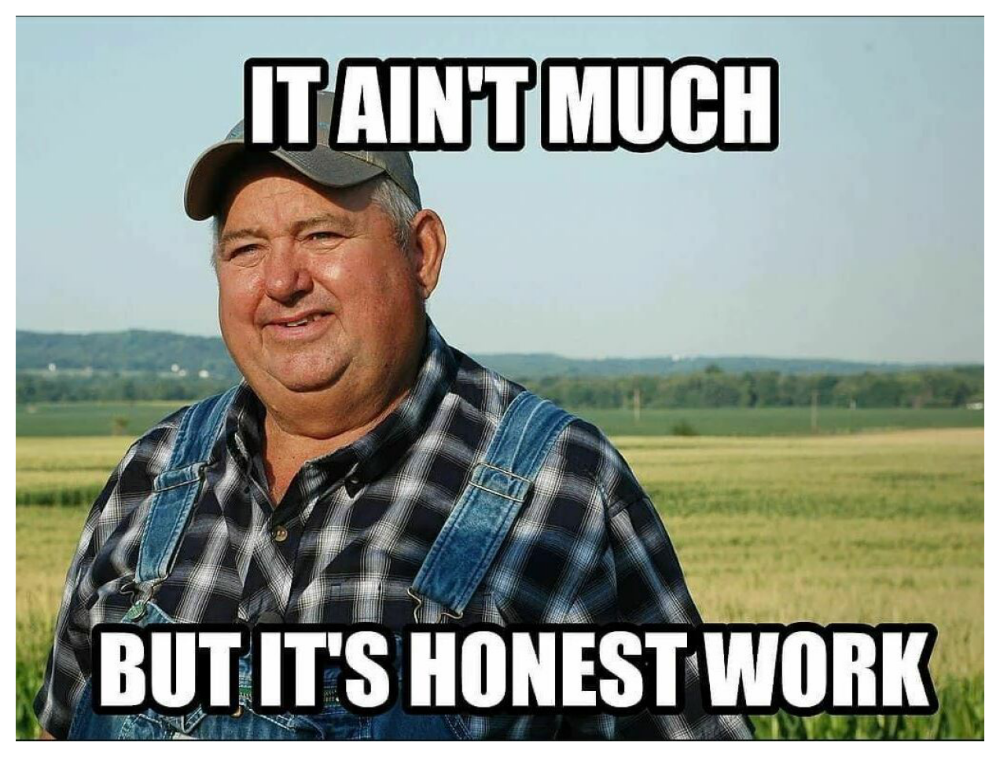

In [21]:
img = mpimg.imread(r'C:\Users\Asus\Desktop\IMS\Data Mining\Project materials\honest-work-meme.jpg')
# Create a figure with custom size
plt.figure(figsize=(8, 6))  # Adjust the width and height as needed
plt.imshow(img)
plt.axis('off')  # Turn off axis labels
plt.show()